<a href="https://colab.research.google.com/github/FredyOrjuela90/Be-star-Bayesian-Inference-Analysis/blob/main/Results/Corner2025.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# INSTALAR LIBRERIAS PARA LOS ESPECTROS
!pip install lmfit -q
!pip install lineid_plot -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.7/97.7 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.1/60.1 kB 3.3 MB/s eta 0:00:00


In [3]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib
import matplotlib.cm as cm
import numpy as np
import pandas as pd
from scipy.optimize import curve_fit
from scipy import stats
from lmfit import Model
import os
import glob as glob
import lineid_plot
from scipy.interpolate import griddata, RegularGridInterpolator
from scipy.ndimage import gaussian_filter
from scipy.special import erf
from typing import Tuple
from scipy.stats import spearmanr
from matplotlib.colors import Colormap
from matplotlib import colormaps
from matplotlib.patches import Circle
import re

In [4]:
# Dato para cada estrella en un diccionario
dataframe = {
    "File": ["E144.txt", "E4180.txt", "E5394.txt", "E6811.txt", "E11606.txt",
             "E20336.txt", "E23302.txt", "E23480.txt", "E23630.txt", "E23862.txt",
             "E187811.txt", "E191610.txt", "E193009.txt", "E194335.txt", "E194883.txt",
             "E195907.txt", "E197419.txt", "E200310.txt", "E202904.txt", "E204722.txt",
             "E208057.txt", "E210129.txt", "E217675.txt", "E217891.txt"],
    "HD": ["HD 144", "HD 4180", "HD 5394", "HD 6811", "HD 11606",
           "HD 20336", "HD 23302", "HD 23480", "HD 23630", "HD 23862",
           "HD 187811", "HD 191610", "HD 193009", "HD 194335", "HD 194883",
           "HD 195907", "HD 197419", "HD 200310", "HD 202904", "HD 204722",
           "HD 208057", "HD 210129", "HD 217675", "HD 217891"],
    "Object": ["10 Cas", "o Cas", "γ Cas", "φ And", "V777 Cas",
               "Bk Cam", "17 Tau", "23 Tau", "25 Tau", "28 Tau",
               "12 Vul", "28 Cyg", "V2113 Cyg", "V2119 Cyg", "V2120 Cyg",
               "V2123 Cyg", "V568 Cyg", "60 Cyg", "υ Cyg", "V2162 Cyg",
               "16 Peg", "25 Peg", "o And", "β Psc"],
    "Spectral": ["B9IIIe", "B5IIIe", "B0.5IVpe", "B5IIIe", "B2Vne",
                 "B2.5Vn(e)", "B6IIIe", "B6IV(e)", "B7III", "B8Vne",
                 "B2.5Ve", "B2.5Ve", "B1V:nnpe", "B2IIIe", "B2Ve",
                 "B1.5V", "B2IV-Ve", "B1Ve", "B2Vne", "B1.5IV:np",
                 "B3Ve", "B7Vne", "B6IV/V_sh", "B6Ve"]
}


ls = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/lista.csv',sep=',')
#print(ls)



# Crea el data frame
df = pd.DataFrame(dataframe)

# Agregar columnas de flujo de datos (Bra, Hu, Pf)
df['Bra'] = ls.iloc[:, 0]
df['Hu'] = ls.iloc[:, 1]
df['Pf'] = ls.iloc[:, 2]

# guardar como txt
df.to_csv("/content/drive/MyDrive/Be-HDUST/CornersPaper/files.txt", sep=' ', index=False, header=False)
df

,File,HD,Object,Spectral,Bra,Hu,Pf
0,E144.txt,HD 144,10 Cas,B9IIIe,4.05691,4.01917,3.78607
1,E4180.txt,HD 4180,o Cas,B5IIIe,4.06019,4.02443,3.72966
2,E5394.txt,HD 5394,γ Cas,B0.5IVpe,4.06361,4.02995,3.73444
3,E6811.txt,HD 6811,φ And,B5IIIe,4.05819,4.03296,3.72336
4,E11606.txt,HD 11606,V777 Cas,B2Vne,4.05231,4.01928,3.72889
5,E20336.txt,HD 20336,Bk Cam,B2.5Vn(e),4.05666,4.02224,3.72976
6,E23302.txt,HD 23302,17 Tau,B6IIIe,4.09061,4.04001,3.73385
7,E23480.txt,HD 23480,23 Tau,B6IV(e),4.05777,4.01972,3.76787
8,E23630.txt,HD 23630,25 Tau,B7III,4.05222,4.01997,3.72521
9,E23862.txt,HD 23862,28 Tau,B8Vne,4.07787,4.04714,3.74844


In [5]:
import time
# EXTRAER EL NOMBRE DE LOS ARCHIVOS .OUT Y TXT EN UNA LISTA
seconds = time.time()
def extract_number(filename):
    # Intentar extraer el número del formato __<número>__ para archivos .out
    match_out = re.search(r'__(\d+)__', filename)
    if match_out:
        return match_out.group(1)
    # Intentar extraer el número del formato E<número> para archivos .txt
    match_txt = re.search(r'E(\d+)', filename)
    if match_txt:
        return match_txt.group(1)
    return None

# Ruta a la carpeta de Google Drive donde estan los archivos
path = '/content/drive/MyDrive/Be-HDUST/CornersPaper/'
path_two = '/content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/'

# Leer todos los archivos .out y .txt en la carpeta especificada
out_files = glob.glob(path_two + '*.out')
txt_files = glob.glob(path + '*.txt')

# Crear un diccionario para almacenar los datos
data = {}

# Crear una lista para almacenar los nombres de los archivos
file_list = []

# Leer los archivos .out y almacenarlos en el diccionario
for file in out_files:
    number = extract_number(file)
    if number:
        data[number] = {'out': pd.read_csv(file, sep='\s+')}
        file_list.append(file)
        print(f"Archivo .out procesado: {file}")

# Leer los archivos .txt y almacenarlos en el diccionario
for file in txt_files:
    number = extract_number(file)
    if number:
        if number in data:
            data[number]['txt'] = pd.read_csv(file, sep='\s+')
            print(f"Archivo .txt añadido a existente: {file}")
        else:
            data[number] = {'txt': pd.read_csv(file, sep='\s+')}
            print(f"Nuevo archivo .txt procesado: {file}")
        file_list.append(file)

# Guardar la lista de nombres de archivos en un archivo llamado 'listado.txt'
with open('/content/drive/MyDrive/Be-HDUST/CornersPaper/listado.txt', 'w') as f:
    for file in file_list:
        f.write(file + '\n')

print("Lista de archivos guardada en 'listado.txt'")
print("Seconds since epoch =", seconds)

<>:33: SyntaxWarning: invalid escape sequence '\s'
<>:42: SyntaxWarning: invalid escape sequence '\s'
<>:45: SyntaxWarning: invalid escape sequence '\s'
<>:33: SyntaxWarning: invalid escape sequence '\s'
<>:42: SyntaxWarning: invalid escape sequence '\s'
<>:45: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipython-input-4175383883.py:33: SyntaxWarning: invalid escape sequence '\s'
  data[number] = {'out': pd.read_csv(file, sep='\s+')}
/tmp/ipython-input-4175383883.py:42: SyntaxWarning: invalid escape sequence '\s'
  data[number]['txt'] = pd.read_csv(file, sep='\s+')
/tmp/ipython-input-4175383883.py:45: SyntaxWarning: invalid escape sequence '\s'
  data[number] = {'txt': pd.read_csv(file, sep='\s+')}
/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__4180__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__5394__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__11606__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__20336__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__23480__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__23630__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__23862__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__191610__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__193009__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__194335__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__194883__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__217891__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__217675__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__210129__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__204722__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__202904__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__200310__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__197419__suffix01.out


/tmp/ipython-input-4175383883.py:33: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data[number] = {'out': pd.read_csv(file, sep='\s+')}


Archivo .out procesado: /content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01/BINF_ALPHAL_BL__195907__suffix01.out
Nuevo archivo .txt procesado: /content/drive/MyDrive/Be-HDUST/CornersPaper/E6811.txt
Archivo .txt añadido a existente: /content/drive/MyDrive/Be-HDUST/CornersPaper/E11606.txt
Nuevo archivo .txt procesado: /content/drive/MyDrive/Be-HDUST/CornersPaper/E23302.txt
Archivo .txt añadido a existente: /content/drive/MyDrive/Be-HDUST/CornersPaper/E20336.txt
Archivo .txt añadido a existente: /content/drive/MyDrive/Be-HDUST/CornersPaper/E23480.txt
Archivo .txt añadido a existente: /content/drive/MyDrive/Be-HDUST/CornersPaper/E23630.txt
Archivo .txt añadido a existente: /content/drive/MyDrive/Be-HDUST/CornersPaper/E23862.txt
Nuevo archivo .txt procesado: /content/drive/MyDrive/Be-HDUST/CornersPaper/E187811.txt
Archivo .txt añadido a existente: /content/drive/MyDrive/Be-HDUST/CornersPaper/E191610.txt
Archivo .txt añadido a existente: /content/drive/MyD

In [6]:
files = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/files.txt', sep=' ',
                    names=['File', 'HD', 'Object', 'Spectral','Bra','Hu','Pf'])
#print(type(files))
print(files)



           File         HD     Object   Spectral      Bra       Hu       Pf
0      E144.txt     HD 144     10 Cas     B9IIIe  4.05691  4.01917  3.78607
1     E4180.txt    HD 4180      o Cas     B5IIIe  4.06019  4.02443  3.72966
2     E5394.txt    HD 5394      γ Cas   B0.5IVpe  4.06361  4.02995  3.73444
3     E6811.txt    HD 6811      φ And     B5IIIe  4.05819  4.03296  3.72336
4    E11606.txt   HD 11606   V777 Cas      B2Vne  4.05231  4.01928  3.72889
5    E20336.txt   HD 20336     Bk Cam  B2.5Vn(e)  4.05666  4.02224  3.72976
6    E23302.txt   HD 23302     17 Tau     B6IIIe  4.09061  4.04001  3.73385
7    E23480.txt   HD 23480     23 Tau    B6IV(e)  4.05777  4.01972  3.76787
8    E23630.txt   HD 23630     25 Tau      B7III  4.05222  4.01997  3.72521
9    E23862.txt   HD 23862     28 Tau      B8Vne  4.07787  4.04714  3.74844
10  E187811.txt  HD 187811     12 Vul     B2.5Ve  4.05439  4.02095  3.73548
11  E191610.txt  HD 191610     28 Cyg     B2.5Ve  4.06041  4.02459  3.73185
12  E193009.

In [7]:
# Leer los archivos de corner plot
with open('/content/drive/MyDrive/Be-HDUST/CornersPaper/listado.txt', 'r') as file:
    file_paths = [line.strip() for line in file.readlines() if line.strip()]

# Leer el archivo de datos de espectro
files_df = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/files.txt', sep=' ', header=None,
                       names=['File', 'HD', 'Object', 'Spectral', 'Val1', 'Val2', 'Val3'])

# Función para obtener el archivo de espectro correspondiente
def get_spectrum_file(corner_file):
    # Extraer el número clave del nombre del archivo de corner plot
    number_key = corner_file.split('__')[1].split('__')[0]

    # Buscar en files.txt
    spectrum_row = files_df[files_df['File'].str.contains(number_key)]
    if not spectrum_row.empty:
        return spectrum_row.iloc[0]['File']
    return None

get_spectrum_file("/content/drive/MyDrive/Be-HDUST/CornersPaper/BINF_WISEBESS__6811__suffix01.out")
print(files_df)
row = files_df.iloc[0]  # Extrae la primera fila (índice 0)
m, n, u = row['HD'], row['Object'], row['Spectral']
print(f"m: {m}, n: {n}, u: {u}")

           File         HD     Object   Spectral     Val1     Val2     Val3
0      E144.txt     HD 144     10 Cas     B9IIIe  4.05691  4.01917  3.78607
1     E4180.txt    HD 4180      o Cas     B5IIIe  4.06019  4.02443  3.72966
2     E5394.txt    HD 5394      γ Cas   B0.5IVpe  4.06361  4.02995  3.73444
3     E6811.txt    HD 6811      φ And     B5IIIe  4.05819  4.03296  3.72336
4    E11606.txt   HD 11606   V777 Cas      B2Vne  4.05231  4.01928  3.72889
5    E20336.txt   HD 20336     Bk Cam  B2.5Vn(e)  4.05666  4.02224  3.72976
6    E23302.txt   HD 23302     17 Tau     B6IIIe  4.09061  4.04001  3.73385
7    E23480.txt   HD 23480     23 Tau    B6IV(e)  4.05777  4.01972  3.76787
8    E23630.txt   HD 23630     25 Tau      B7III  4.05222  4.01997  3.72521
9    E23862.txt   HD 23862     28 Tau      B8Vne  4.07787  4.04714  3.74844
10  E187811.txt  HD 187811     12 Vul     B2.5Ve  4.05439  4.02095  3.73548
11  E191610.txt  HD 191610     28 Cyg     B2.5Ve  4.06041  4.02459  3.73185
12  E193009.

<>:2: SyntaxWarning: invalid escape sequence '\s'
<>:2: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipython-input-3714653175.py:2: SyntaxWarning: invalid escape sequence '\s'
  data = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/' + i, sep='\s+', header=None)


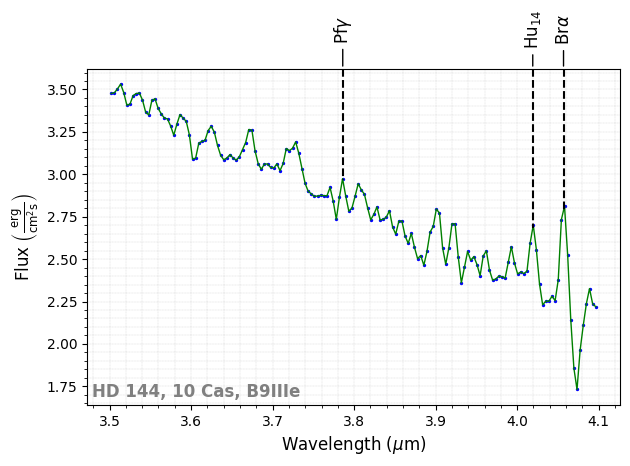

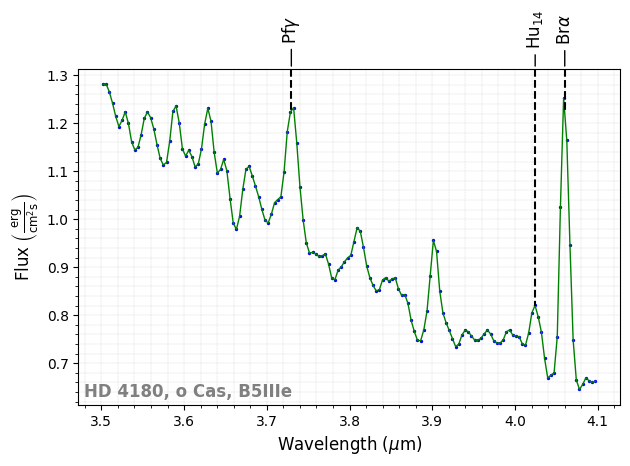

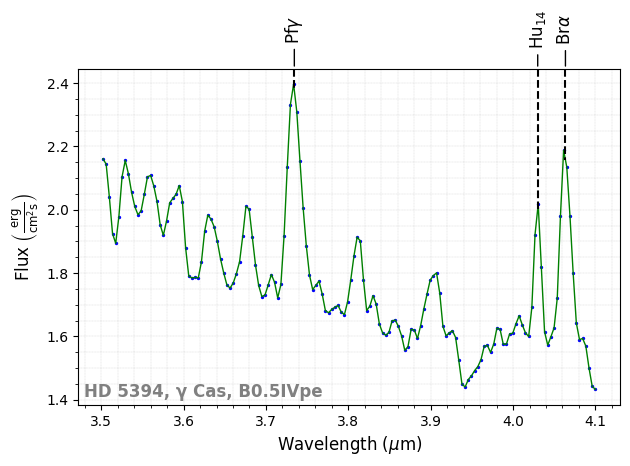

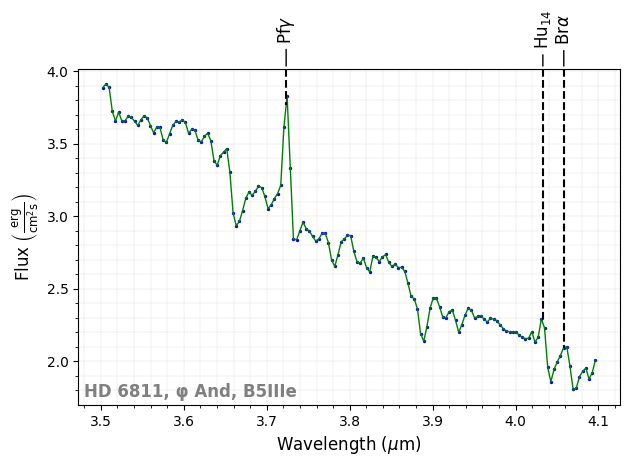

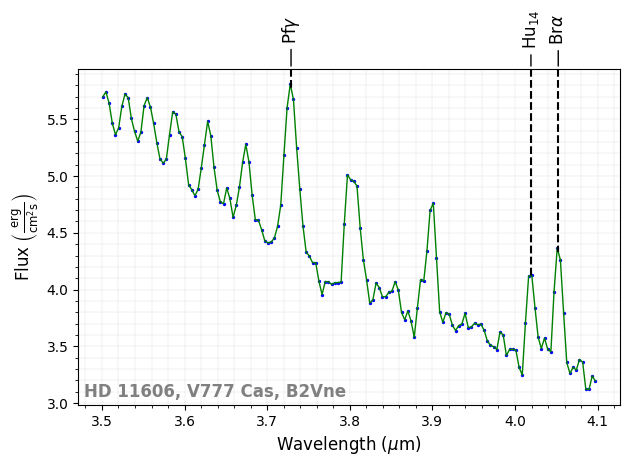

...

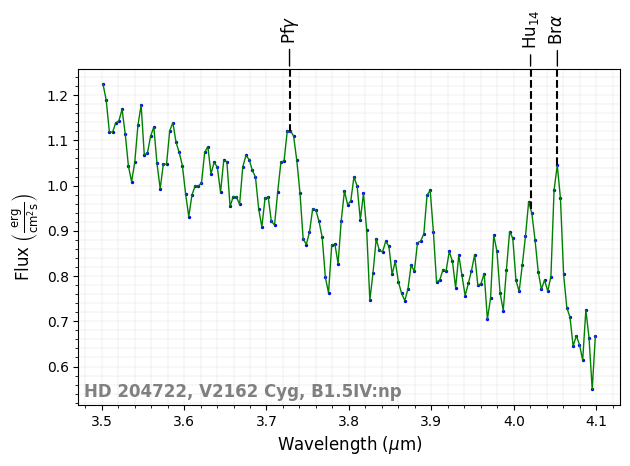

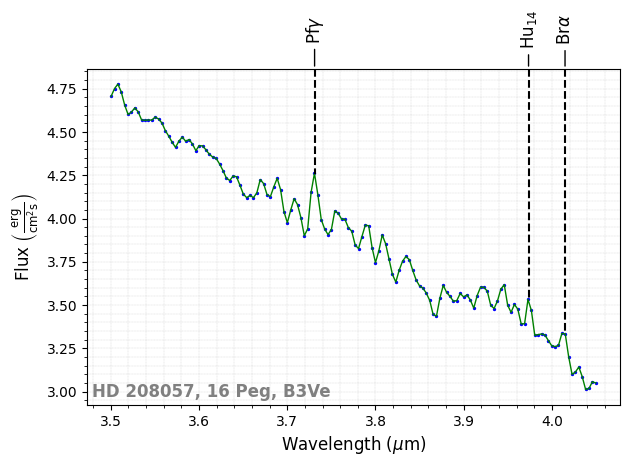

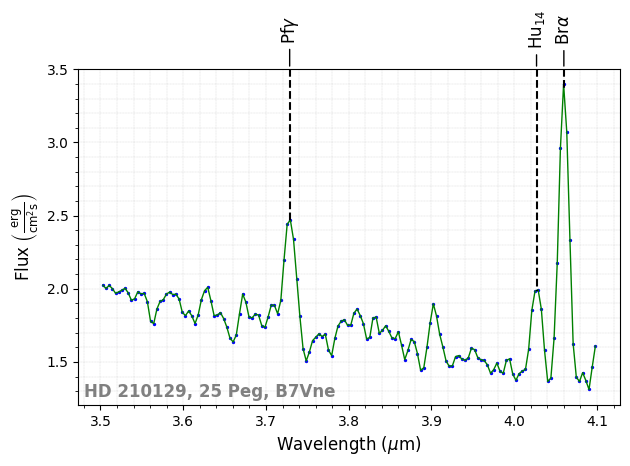

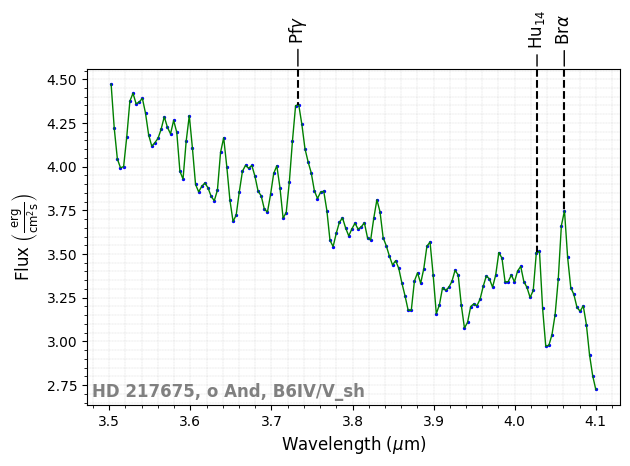

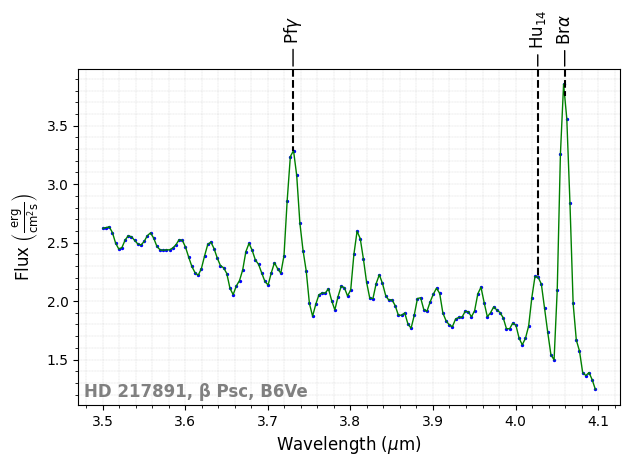

In [8]:

for i, m, n, u, j, k, l in zip(files.iloc[:, 0], files.iloc[:, 1],files.iloc[:, 2],files.iloc[:, 3],ls.iloc[:, 0], ls.iloc[:, 1], ls.iloc[:, 2]):
    data = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/' + i, sep='\s+', header=None)
    # Convert columns to numeric type, forcing non-convertible values to NaN
    data.iloc[:, 0] = pd.to_numeric(data.iloc[:, 0], errors='coerce')
    data.iloc[:, 1] = pd.to_numeric(data.iloc[:, 1], errors='coerce')
    #print(i)
    #print(j)
    #print(data)
    #print(ls)
    # Drop rows with NaN values that resulted from conversion errors
    data = data.dropna()

    # Continue with the existing code
    x = data.iloc[:, 0]
    X = x / 10000
    y = data.iloc[:, 1]
    line_X = [j, k, l]


    line_label = [ r'Br$\alpha$',  r'Hu$_{14}$',  r'Pf$\gamma$']
    fig, ax = plt.subplots()
    ax.scatter(X, y, color='blue', marker='o', s=2)  # Use scatter for points
    ax.plot(X, y, color='green', linewidth=1)  # Optional: connect points with a line

    ax.set_xlabel(r'Wavelength ($\mu$m)', fontsize=12)
    ax.set_ylabel(r'Flux $\left(\frac{\mathrm{erg}}{\mathrm{cm}^2 \mathrm{s}}\right)$', fontsize=12)

    ax.grid(True, which='both', linestyle=':', linewidth=0.2, color='gray')  # Fine grid
    ax.minorticks_on()  # Enable minor ticks
    ax.yaxis.get_offset_text().set_visible(False)

    # Customizing the font sizes for ticks
    ax.tick_params(axis='both', which='major', labelsize=10)
    ax.tick_params(axis='both', which='minor', labelsize=8)

    # Line identification
    lineid_plot.plot_line_ids(X, y, line_X, line_label, ax=ax, box_axes_space=0.09)

    # Adding label with HD, Object, and Spectral
    ax.text(0.01, 0.01, f"{m}, {n}, {u}",
        transform=ax.transAxes, fontsize=12, color= 'gray',fontweight='bold', va='bottom', ha='left')


    fig.tight_layout()
    filename_without_extension = i.strip().replace('.txt', '')
    plt.savefig(f"/content/drive/MyDrive/Be-HDUST/CornersPaper/Spectra_{filename_without_extension}.png", bbox_inches='tight', dpi=600)
    #plt.savefig(f"/content/drive/My Drive/CornersPaper/Spectra_{filename_without_extension}.svg", format='svg', bbox_inches='tight')
    #plt.close()
    plt.show()

In [9]:

def cornerplot(
    data: np.ndarray,
    cmap="Blues",
    correlation_textcolor=None,
    dpi=100.,
    hex_gridsize=30,
    highlight=None,
    highlight_linecolor=None,
    highlight_markercolor=None,
    hist_backgroundcolor=None,
    hist_bins=20,
    hist_edgecolor=None,
    hist_facecolor=None,
    labels=None,
    limits=None,
    scatter_alpha=0.5,
    scatter_markercolor=None,
    scatter_outside_sigma=None,
    show_correlations=False,
    show_scorrelations=False,
    sigma_levels=None,
    sigma_linecolor=None,
    sigma_smooth=3.,
    title_quantiles=None,
    width=3.
) -> Tuple[matplotlib.figure.Figure, matplotlib.axes.Axes]:
    """
    Function creates hexbin corner plot matrix to visualize multidimensional data.

    Parameters:
    -----------
    data : (N_sample, N_dims) array-like
        Two-dimensional data array to be visualized. First dimension are the samples,
        second dimension the features.
    cmap : str or matplotlib.colors.Colormap, optional, default: "Blues"
        Either a string of a valid matplotlib colormap or a custom Colormap object
        to be used in the plot.
    correlation_textcolor : str, optional, default: None
        Color of correlation text.
        Defaults to a value from the chosen colormap.
    dpi : float, optional, default: 100.
        Dots per inch of the figure
    hex_gridsize : int, optional, default: 30
        Number of hexagons ins x-direction
    highlight : (N_dims) array-like, optional, default: None
        If not None, array of values to be highlighted in the plot. Typically
        the truth values.
    highlight_linecolor : str or tuple, optional, default: None
        If not None linecolor of the highlighted values.
        Defaults to a value from the chosen colormap.
    highlight_markercolor : str or tuple, optional, default: None
        If not None markercolor of the highlighted values.
        Defaults to a value from the chosen colormap.
    hist_backgroundcolor : str or tuple, optional, default: None
        If not None background color of the axes object.
        Defaults to a value from the chosen colormap.
    hist_bins : int, optinal, default: 20
        Number of bins in histograms.
    hist_edgecolor : str or tuple, optional, default: None
        If not None edgecolor of the histgram bars.
        Defaults to a value from the chosen colormap.
    hist_facecolor : str or tuple, optional, default: None
        If not None face of the histgram bars.
        Defaults to a value from the chosen colormap.
    labels : (N_dims) list, optional, default: None
        If not None list of strings with the feature names
        to be used as axis labels or in the axis titles.
    limits : (2,) or (N_dims, 2) array-like, optional, default: None
        If not None limits is the axis limits of the
        features giving the minimum and maximum values
        of each feature
    scatter_alpha : float, optional, default: 0.5
        Alpha transparency value of scatter plot
    scatter_markercolor : str, optional, default: None
        If not None markercolor of scatter plot markers.
        Defaults to a value from the chosen colormap.
    scatter_outside_sigma : float, optional, default: None
        If not None displays scatter plot of individual data
        points outside of given sigma contour.
    show_correlations : boolean, optional, default: False
        If True show Pearson's correlation coeffiction in each tile.
    sigma_levels : array_like, optional, default: None
        If not None contour levels to be plotted in
        units of the standard deviation.
    sigma_linecolor : str or tuple, optional, default: None
        If not None linecolor of the sigma contour lines.
        Defaults to a value from the chosen colormap.
    sigma_smooth : float, optional, default: 3.
        Smoothing factor for hexbin plot to smooth
        out contour lines.
    title_quantiles : (1,) or (3,) array-like, optional, default: None
        One-dimensional array of either size one or size three with
        the feature quantiles to be plotted as histogram titles.
    width : float, optional, default: 3.
        Width of a single tile of the corner plot.

    Returns:
    --------
    (fig, ax) : tuple
        Tuple containing the figure and axes objects.
    """

    # Number of dimensions
    _, Nd = data.shape

    # Validate colormap
    if isinstance(cmap, str):
        cm = colormaps[cmap]
    elif isinstance(cmap, Colormap):
        cm = cmap
    else:
        raise ValueError(
            "'cmap' has to be either type str or LinearSegmentedColormap.")

    # Setting colors
    hl_lc = highlight_linecolor if highlight_linecolor is not None else cm(1.)
    hl_mc = highlight_markercolor if highlight_markercolor is not None \
        else cm(0.)
    sig_lc = sigma_linecolor if sigma_linecolor is not None else cm(1.)
    hist_bc = hist_backgroundcolor if hist_backgroundcolor is not None \
        else cm(0.)
    hist_ec = hist_edgecolor if hist_edgecolor is not None else cm(1.)
    hist_fc = hist_facecolor if hist_facecolor is not None else cm(0.5)
    scat_mc = scatter_markercolor if scatter_markercolor is not None else cm(
        0.5)

    # Validate labels
    set_labels = False if labels is None else True
    if set_labels:
        if len(labels) != Nd:
            raise ValueError(
                "Size of 'labels' does not match number of dimensions.")

    # Validate highlights
    set_highlights = False if highlight is None else True
    if set_highlights:
        if len(highlight) != Nd:
            raise ValueError(
                "Size of 'highlight' does not match number of dimensions.")

    # Produce levels
    if sigma_levels is not None:
        # Converting to 1d quantiles
        quants = []
        for s in sigma_levels:
            q = sigma_to_quantile(s)
            quants.extend([50.-q, 50.+q])
        quants = np.array(quants)
        quants.sort()
        # Converting to 2d sigma levels
        levels2d = 1. - np.exp(-0.5*np.array(sigma_levels)**2)

    # Threshold for scatter plot
    if scatter_outside_sigma is not None:
        scatter_thr = 1. - np.exp(-0.5*np.array(scatter_outside_sigma)**2)

    # Validate title quantiles
    if title_quantiles is not None:
        if len(title_quantiles) not in [1, 3]:
            raise ValueError(
                "'title_quantiles' has to have either size 1 or size 3.")
        title_quantiles = np.array(title_quantiles)
        title_quantiles.sort()

    # Compute correlation coefficients
    if show_correlations:
        rho = np.corrcoef(data.T)
        cor_tc = correlation_textcolor if correlation_textcolor is not None else cm(
            1.)
    # Calcular coeficientes de correlación de Spearman
    if show_scorrelations:
        rhos, _ = spearmanr(data, axis=0)  # Correlación entre columnas (variables)
        cor_tc = correlation_textcolor if correlation_textcolor is not None else cm(1.)


    # Setting limits
    lim = np.empty((Nd, 2))
    if limits is not None:
        l = np.array(limits)
        if l.shape not in [(2,), (Nd, 2)]:
            raise ValueError("'limits' does not have the correct shape.")
        lim[...] = l[None, :] if len(l.shape) == 1 else l
    else:
        lim[:, 0] = data.min(axis=0)
        lim[:, 1] = data.max(axis=0)

    fig, ax = plt.subplots(nrows=Nd, ncols=Nd, figsize=(
        Nd*width, Nd*width), dpi=dpi,constrained_layout=True)

    for i in range(Nd**2):
        # x and y coordinates of subplots
        ix, iy = np.divmod(i, Nd)

        if iy > ix:
            # Remove axes outside of corner plot
            fig.delaxes(ax[ix, iy])
        elif ix == iy:
            # Histograms
            ax[ix, iy].set_facecolor(hist_bc)
            ax[ix, iy].hist(data[:, ix], bins=hist_bins, color=cm(1.),
                            facecolor=hist_fc, edgecolor=hist_ec)
            if sigma_levels is not None:
                perc = np.percentile(data[:, ix], quants)
                for p in perc:
                    ax[ix, iy].axvline(p, ls="--", lw=1, c=sig_lc)
            if set_highlights:
                ax[ix, iy].axvline(highlight[iy], ls="-", color=hl_lc)
            if title_quantiles is not None:
                perc = np.percentile(data[:, ix], title_quantiles)
                if len(title_quantiles) == 1:
                    if labels is not None:
                        prefix = "{} $= ".format(labels[iy])
                    else:
                        prefix = "$"
                    msg = "{}{{{:.2f}}}$".format(
                        prefix, perc[0])
                else:
                    diff = np.diff(perc)
                    if labels is not None:
                        prefix = "{} $= ".format(labels[iy])
                    else:
                        prefix = "$"
                    msg = "{}{{{:.2f}}}^{{+{:.2f}}}_{{-{:.2f}}}$".format(
                        prefix, perc[1], diff[1], diff[0])
                #ax[ix, iy].set_title(msg, fontsize="x-large")
                ax[ix, iy].set_title(msg, fontsize=16)
        else:
            # Hexbin plots
            h = ax[ix, iy].hexbin(
                data[:, iy], data[:, ix],
                cmap=cm,
                gridsize=hex_gridsize,
                linewidths=0.5,
                edgecolor=cm(0),
                extent=(lim[iy, 0], lim[iy, 1], lim[ix, 0], lim[ix, 1])
            )

            # Data gridding if sigma_levels given or scatter plot required
            if sigma_levels is not None or scatter_outside_sigma is not None:

                # Get positions and values from hexbin plots
                xy = h.get_offsets()
                z = h.get_array()

                # Compute gridded data for contour plot
                grid_x, grid_y = np.mgrid[
                    xy[:, 0].min():xy[:, 0].max():3*hex_gridsize*1j,
                    xy[:, 1].min():xy[:, 1].max():3*hex_gridsize*1j
                ]
                zi = griddata(xy, z, (grid_x, grid_y), method="linear")
                # Smooth data to forget about hexplot grid
                zi = gaussian_filter(zi, sigma_smooth)

                # Convert sigma levels to data levels
                z_flattened = zi.flatten()
                z_ordered = z_flattened[z_flattened.argsort()[::-1]]
                cumsum = z_ordered.cumsum()
                cumsum /= cumsum[-1]

            # Contourplot
            if sigma_levels is not None:
                # Compute levels
                levels = np.empty(len(levels2d))
                for i, s in enumerate(levels2d):
                    levels[i] = z_ordered[np.abs(cumsum-s).argmin()]
                levels.sort()
                # Draw plot
                ax[ix, iy].contour(
                    grid_x, grid_y, zi,
                    levels=levels,
                    colors=[sig_lc],
                    linewidths=1.,
                    linestyles="--"
                )

            # Scatter plot
            if scatter_outside_sigma is not None:
                # Compute threshold value
                scat_thr = z_ordered[np.abs(cumsum-scatter_thr).argmin()]
                # Nearest neighbor search
                NNDI = RegularGridInterpolator(
                    (grid_x[:, 0], grid_y[0, :]),
                    zi,
                    method="linear",
                    bounds_error=False,
                    fill_value=0.
                )
                mask = NNDI((data[:, iy], data[:, ix])) < scat_thr
                ax[ix, iy].scatter(
                    data[mask, iy], data[mask, ix],
                    marker=".",
                    s=0.5,
                    alpha=scatter_alpha,
                    c=[scat_mc])



            # Correlation coefficient Pearson
            if show_correlations:
                msg = r"$\rho = {{{:.2f}}}$".format(rho[ix, iy])
                # Visualización de los coeficientes de correlación

                msg = "     " +r"$\rho_s = {{{:.2f}}}$".format(rhos[ix, iy])

                # Acceder al eje correcto en la matriz de subtramas
                axis = ax[ix, iy]


                # Mapear el valor de correlación a un color en el colormap
                coloress = plt.cm.plasma(rhos[ix, iy])
                # Agregar un círculo de color
                # Coordenadas para el círculo y el texto
                circle_xy = (0.08, 0.92)
                text_xy = (0.04, 0.95)


            # Calcular coeficientes de correlación de Spearman
            if show_scorrelations:
                rhos, _ = spearmanr(data, axis=0)  # Correlación entre columnas (variables)
                cor_tc = correlation_textcolor if correlation_textcolor is not None else cmap(1.)

                # Visualización de los coeficientes de correlación

                msg = "     " +r"$\rho_s = {{{:.2f}}}$".format(rhos[ix, iy])

                # Acceder al eje correcto en la matriz de subtramas
                axis = ax[ix, iy]

                # Crear un normalizador para mapear los valores de correlación al rango [0, 1]
                norm = plt.Normalize(vmin=-1, vmax=1)
                # Mapear el valor de correlación a un color en el colormap
                coloress = plt.cm.plasma(norm(rhos[ix, iy]))
                # Agregar un círculo de color
                # Coordenadas para el círculo y el texto
                circle_xy = (0.08, 0.90)
                text_xy = (0.04, 0.95)




                # Agregar el texto con un rectángulo
                bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor=coloress, alpha=0.5)
                axis.text(
                    text_xy[0], text_xy[1], msg,
                    va="top", ha="left",
                    transform=axis.transAxes,
                    c=cor_tc,
                    fontsize=16,
                    fontweight='bold',
                    bbox=bbox_props
                )
                # Agregar un círculo de color
                circle = Circle(circle_xy, 0.05, transform=axis.transAxes, color=coloress, alpha=1.0)
                axis.add_patch(circle)


            # Set the highlights
            if set_highlights:
                ax[ix, iy].axvline(highlight[iy], ls="-", color=hl_lc)
                ax[ix, iy].axhline(highlight[ix], ls="-", color=hl_lc)
                ax[ix, iy].plot(
                    highlight[iy], highlight[ix],
                    marker=(6, 0, 0),
                    markersize=8,
                    c=hl_mc,
                    markeredgecolor=hl_lc
                )

        # Setting limits
        if ix == Nd-1:
            #ax[ix, iy].set_xlim(data[:, iy].min(), data[:, iy].max())
            #ax[ix, iy].set_ylim(data[:, ix].min(), data[:, ix].max())
            ax[ix, iy].set_xlim(lim[iy, 0], lim[iy, 1])
        if ix > 0 and iy == 0:
            ax[ix, iy].set_ylim(lim[ix, 0], lim[ix, 1])

        # Set y-labels
        if ix > 0 and iy == 0:
            if set_labels:
                #ax[ix, iy].set_ylabel(labels[ix], fontsize="x-large")
                ax[ix, iy].set_ylabel(labels[ix], fontsize=22)
        elif iy < ix:
            ax[ix, iy].sharey(ax[ix, 0])
            plt.setp(ax[ix, iy].get_yticklabels(), visible=False)
        else:
            plt.setp(ax[ix, iy].get_yticklabels(), visible=False)

        # Set x-labels
        if ix == Nd-1:
            if set_labels:
                #ax[ix, iy].set_xlabel(labels[iy], fontsize="x-large")
                ax[ix, iy].set_xlabel(labels[iy], fontsize=22)
        else:
            ax[ix, iy].sharex(ax[Nd-1, iy])
            plt.setp(ax[ix, iy].get_xticklabels(), visible=False)



    # Agregar colorbar con colormap plasma en la ubicación específica
    # Crear ScalarMappable con los límites -1 y 1
    sm = matplotlib.cm.ScalarMappable(cmap=plt.cm.plasma, norm=plt.Normalize(vmin=-1, vmax=1))

    # Agregar colorbar con colormap plasma en la ubicación específica
    # Definir una nueva ubicación para la barra de color
    cbar_ax = fig.add_axes([0.27, 0.96, 0.36, 0.019])  # [left, bottom, width, height]
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Spearman Correlation',fontsize=18)

    # Crear un eje en la ubicación específica para el gráfico de dispersión
    ax_scatter = fig.add_axes([0.49, 0.65, 0.505, 0.2])  # [left, bottom, width, height]

    # Obtener el archivo de espectro asociado al corner plot
    spectrum_file = get_spectrum_file(corner_file)

    # Leer el archivo de espectro
    spectrum_data = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/' + spectrum_file, sep='\s+', header=None)

    # Buscar la fila en el DataFrame donde la primera columna coincida con el archivo obtenido
    fila_buscada = files_df[files_df.iloc[:, 0] == spectrum_file]

    # Si se encuentra una fila, extraemos los valores
    if not fila_buscada.empty:
        row = fila_buscada.iloc[0]  # Tomamos la primera fila (si hay múltiples coincidencias)
        m, n, u = row['HD'], row['Object'], row['Spectral']
        print(f"m: {m}, n: {n}, u: {u}")

    # Preparar los datos para el gráfico de dispersión
    X = spectrum_data.iloc[:, 0] / 10000  # Convertir la longitud de onda
    y = spectrum_data.iloc[:, 1]  # Flujos

    # Obtener los valores de las columnas 'Val1', 'Val2', y 'Val3' como floats
    line_X = [
        float(files_df.loc[files_df['File'] == spectrum_file, 'Val1'].iloc[0]),
        float(files_df.loc[files_df['File'] == spectrum_file, 'Val2'].iloc[0]),
        float(files_df.loc[files_df['File'] == spectrum_file, 'Val3'].iloc[0])
    ]

    # Etiquetas para las líneas
    line_label = [r'Br$\alpha$', r'Hu$_{14}$', r'Pf$\gamma$']

    # Crear el scatter plot y la curva correspondiente
    ax_scatter.scatter(X, y, color='blue', marker='o', s=2)  # Puntos de dispersión
    ax_scatter.plot(X, y, color='green', linewidth=1)  # Línea que conecta los puntos

    # Configurar las etiquetas de los ejes
    ax_scatter.set_xlabel(r'Wavelength ($\mu$m)', fontsize=14)
    ax_scatter.set_ylabel(r'Flux $\left(\frac{\mathrm{erg}}{\mathrm{cm}^2 \mathrm{s}}\right)$', fontsize=14)

    # Configurar la cuadrícula
    ax_scatter.grid(True, which='both', linestyle=':', linewidth=0.2, color='darkblue')
    ax_scatter.minorticks_on()
    ax_scatter.yaxis.get_offset_text().set_visible(False)
    # Configurar el tamaño de las etiquetas de las marcas
    ax_scatter.tick_params(axis='both', which='major', labelsize=10)
    ax_scatter.tick_params(axis='both', which='minor', labelsize=8)

    # Agregar la identificación de las líneas
    lineid_plot.plot_line_ids(X, y, line_X, line_label, ax=ax_scatter, box_axes_space=0.09)

    # Añadir la etiqueta con HD, Object, y Spectral
    ax_scatter.text(0.01, 0.01, f"{m}, {n}, {u}",
        transform=ax_scatter.transAxes, fontsize=14, color='gray', fontweight='bold', va='bottom', ha='left')

    # Extraer el nombre del archivo sin la ruta completa ni la extensión
    file_name = os.path.splitext(os.path.basename(corner_file))[0]
    #print(file_name)
    plt.savefig(f"/content/drive/MyDrive/Be-HDUST/CornersPaper/Spectra_{file_name}.png",dpi=150)








    #fig.tight_layout()

    plt.show()

    return fig, ax


def sigma_to_quantile(sig: float) -> float:
    """
    Function converts standard deviation of
    a normal distribution to quantile.

    Parameters:
    -----------
    sig : float
        Standard deviation

    Returns:
    --------
    q : float
        Quantile
    """
    return _gaussian_primitive(-sig, 0., 1.)*100


def _gaussian_primitive(x: float, mu: float, sig: float) -> float:
    """
    Function returns the primitive of the normal distribution

    Parameters:
    -----------
    x : float, array-like
        Evaluation coordinate
    mu : float
        Mean of normal distribution
    sig : float
        Standard deviation of normal distribution

    Returns:
    --------
    F(x) : float, array-like
        Primitive at x
    """

    return -0.5*erf((x-mu)/(np.sqrt(2.)*sig))

<>:416: SyntaxWarning: invalid escape sequence '\s'
<>:416: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipython-input-3030551280.py:416: SyntaxWarning: invalid escape sequence '\s'
  spectrum_data = pd.read_csv('/content/drive/MyDrive/Be-HDUST/CornersPaper/' + spectrum_file, sep='\s+', header=None)


<>:4: SyntaxWarning: invalid escape sequence '\s'
<>:4: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipython-input-267741720.py:4: SyntaxWarning: invalid escape sequence '\s'
  data = pd.read_csv(corner_file, skiprows=20001, sep='\s+', header=None)


[ 3.66328784  0.30629433 11.82869324  1.3139316   0.73616955]
[ 3.57806825  0.33410251 11.78976392  1.31796672  0.76525388]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 4180, n: o Cas, u: B5IIIe


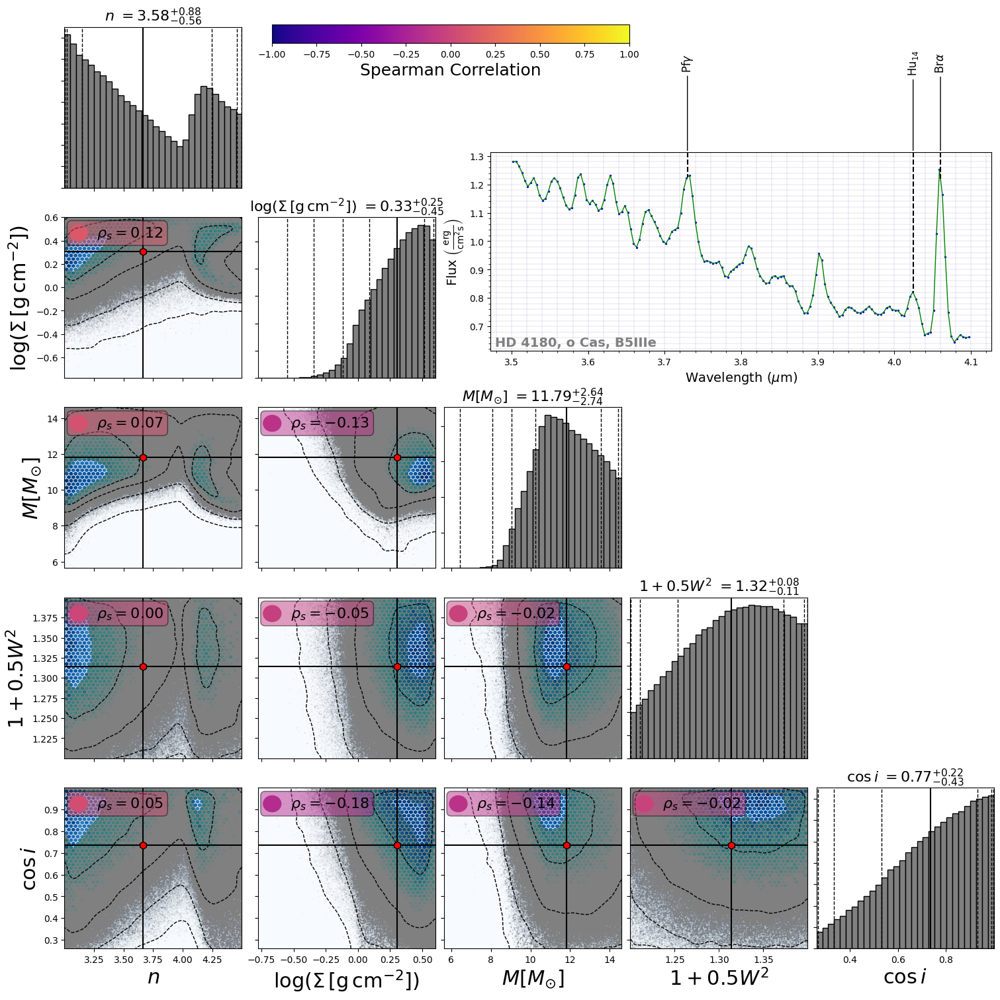

[ 3.71035723  0.3413444  11.75431994  1.31532959  0.74413059]
[ 3.57188549  0.36598702 11.69640869  1.31980474  0.77894509]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 5394, n: γ Cas, u: B0.5IVpe


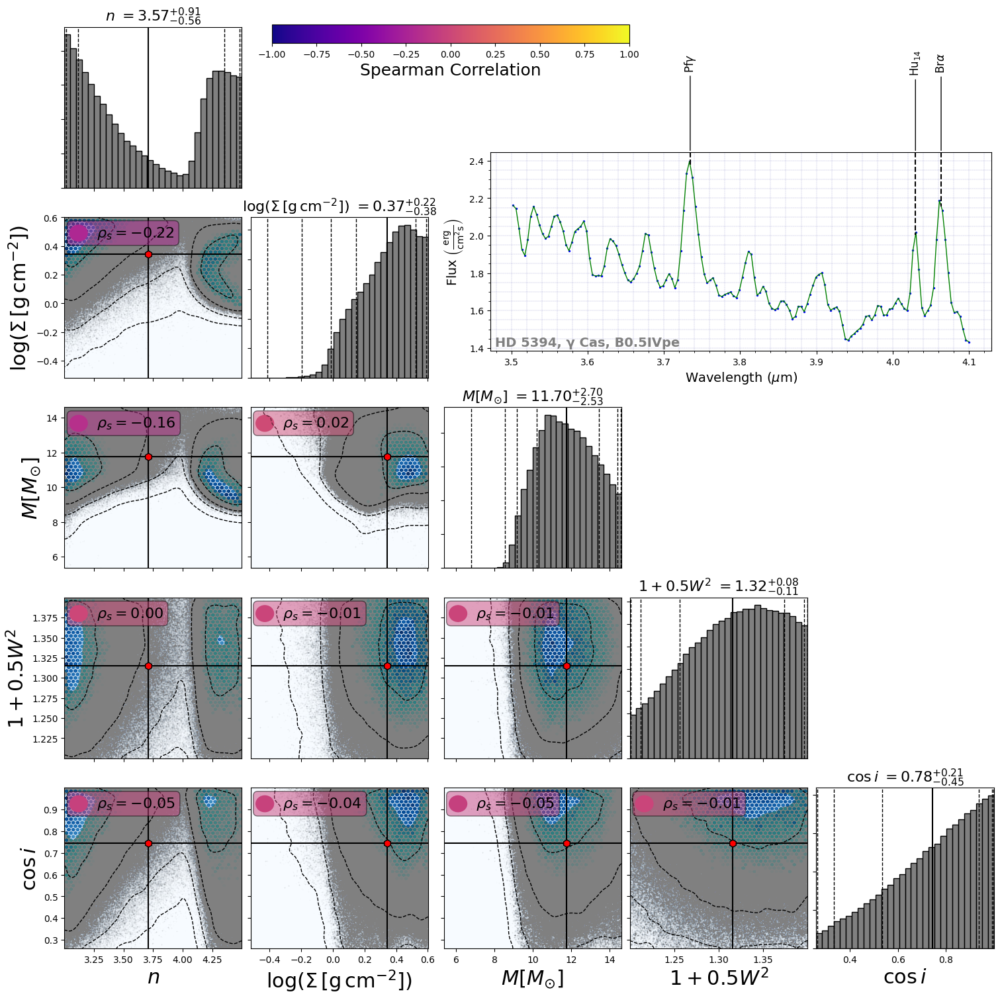

[ 4.37821284  0.24321586 11.14410196  1.31603021  0.76991712]
[ 4.40376505  0.24146838 11.07572368  1.32068529  0.80792171]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 11606, n: V777 Cas, u: B2Vne


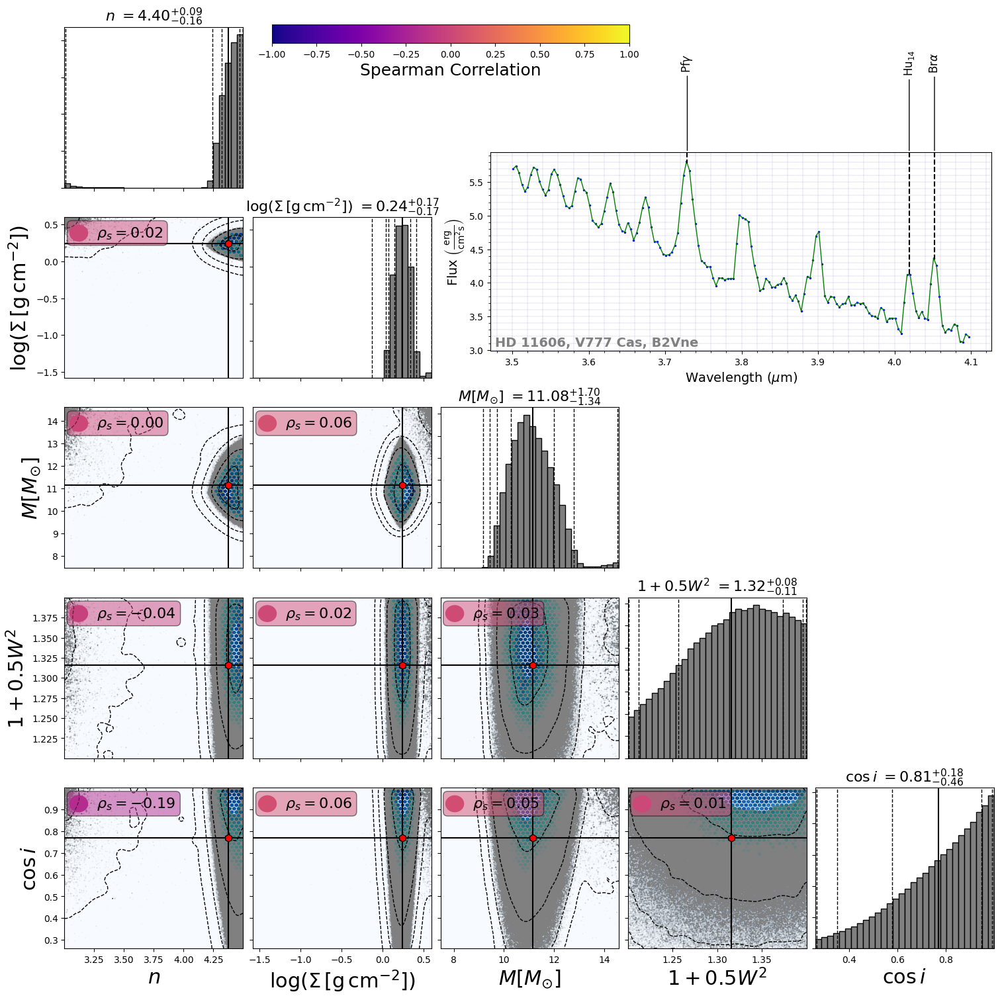

[3.59333651 0.04225828 7.3992752  1.31499302 0.72095642]
[3.54381089 0.11176832 7.03881278 1.31933711 0.75544986]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 20336, n: Bk Cam, u: B2.5Vn(e)


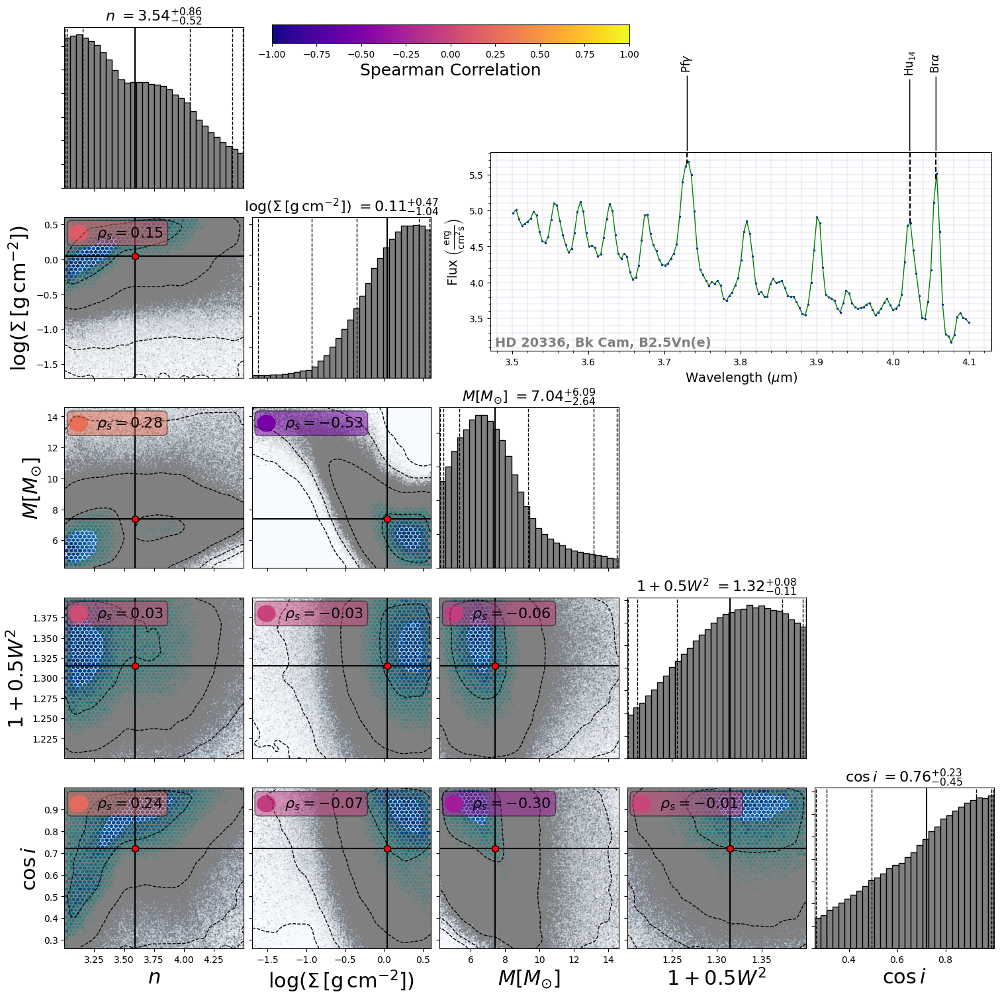

[ 3.79116957 -0.46502292  7.22016932  1.31179272  0.62847365]
[ 3.80681527 -0.45470465  6.89143689  1.31511595  0.62734387]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 23480, n: 23 Tau, u: B6IV(e)


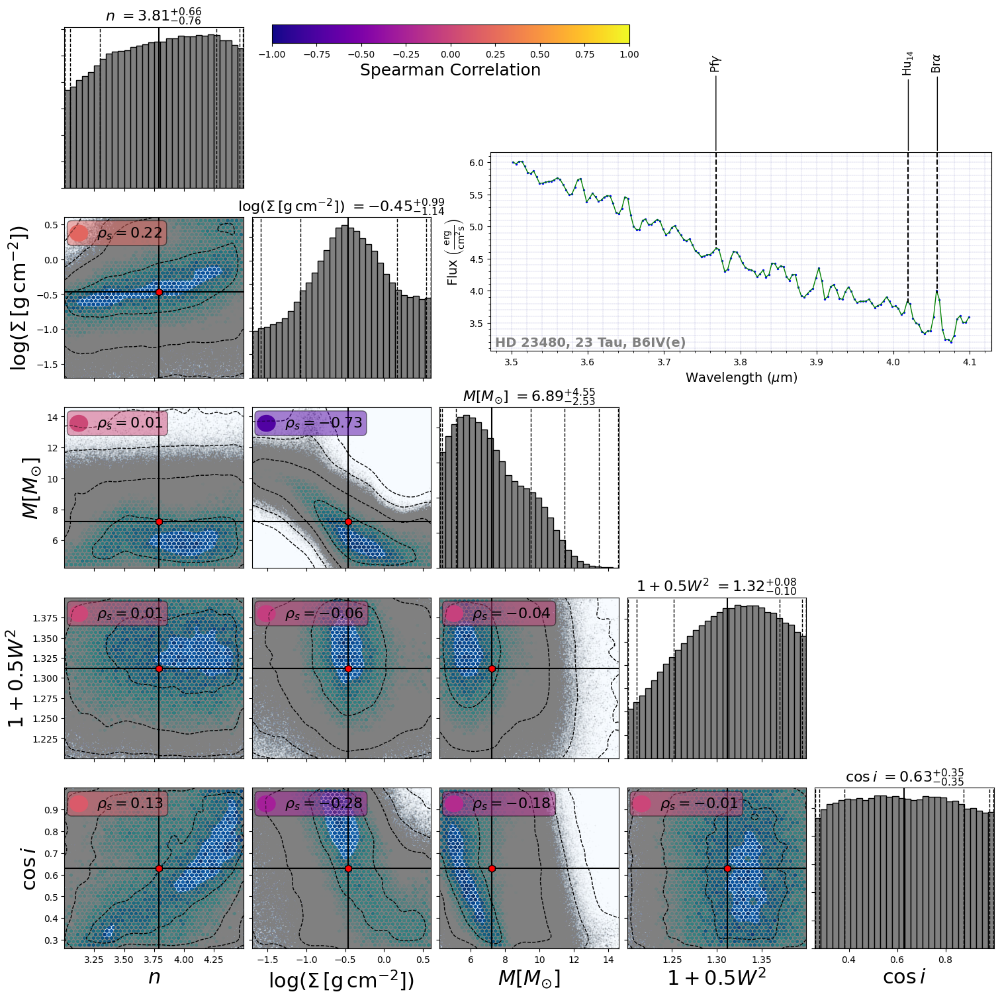

[ 3.66180332  0.34122984 11.96253601  1.31551204  0.7560094 ]
[ 3.5235615   0.37165758 11.95339949  1.32011316  0.79021484]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 23630, n: 25 Tau, u: B7III


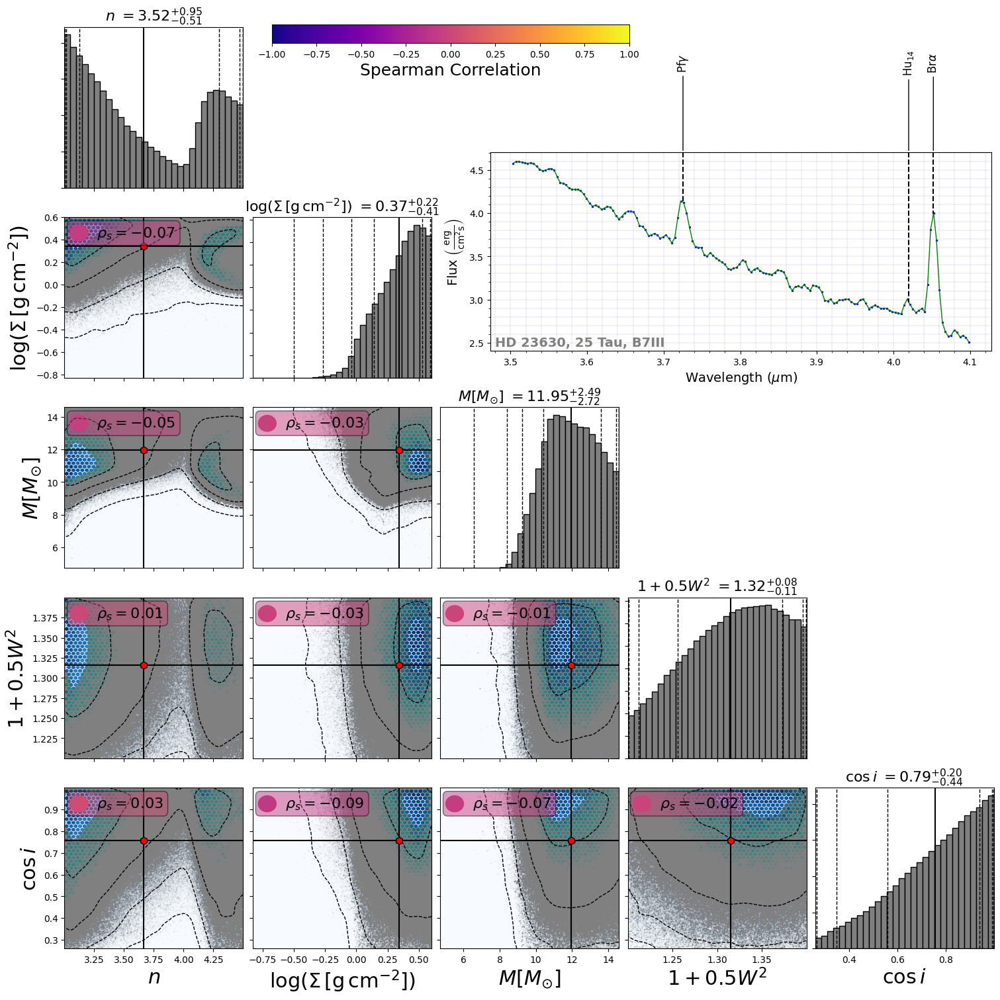

[ 3.85745912 -0.74361914  7.20321087  1.31063236  0.61020737]
[ 3.90301912 -0.79965056  7.20612589  1.31348013  0.60169963]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 23862, n: 28 Tau, u: B8Vne


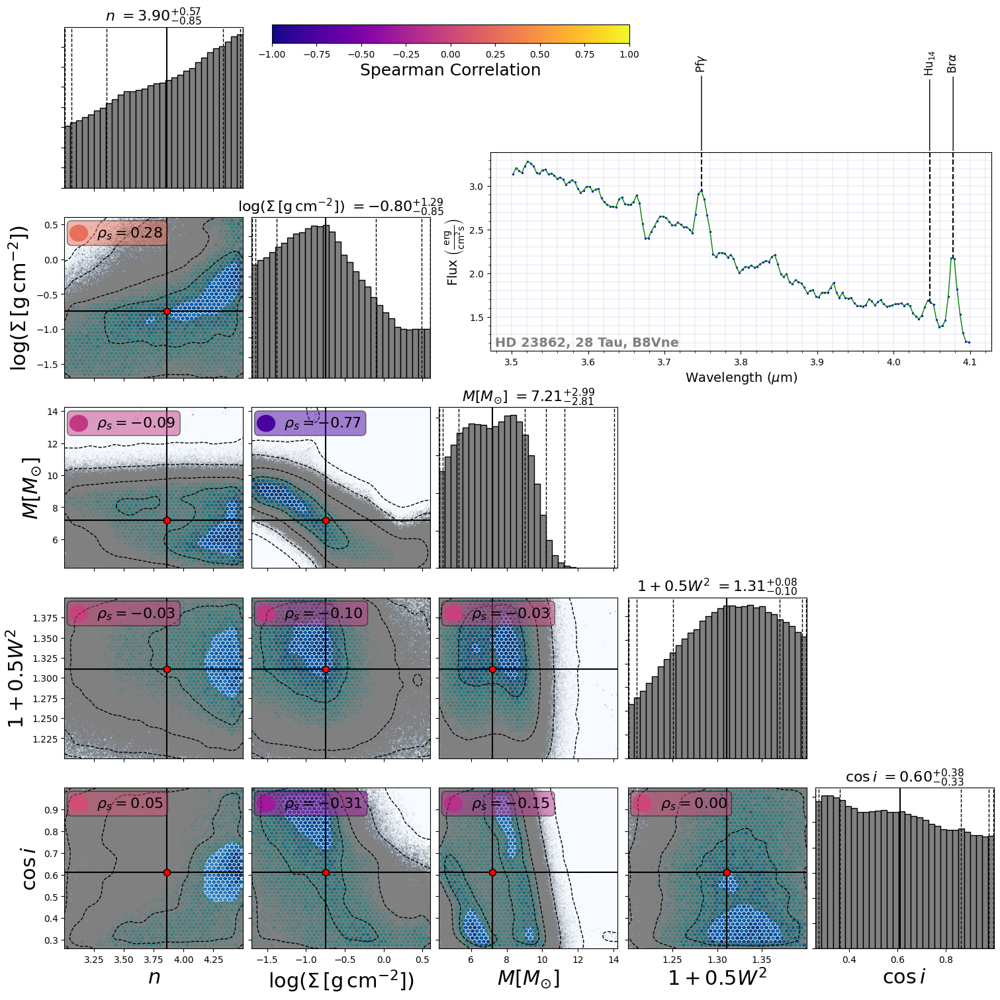

[ 3.70134675 -0.1538021   9.33677346  1.31499109  0.69924116]
[ 3.72458684 -0.11726396  8.93987708  1.31935699  0.73389388]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 191610, n: 28 Cyg, u: B2.5Ve


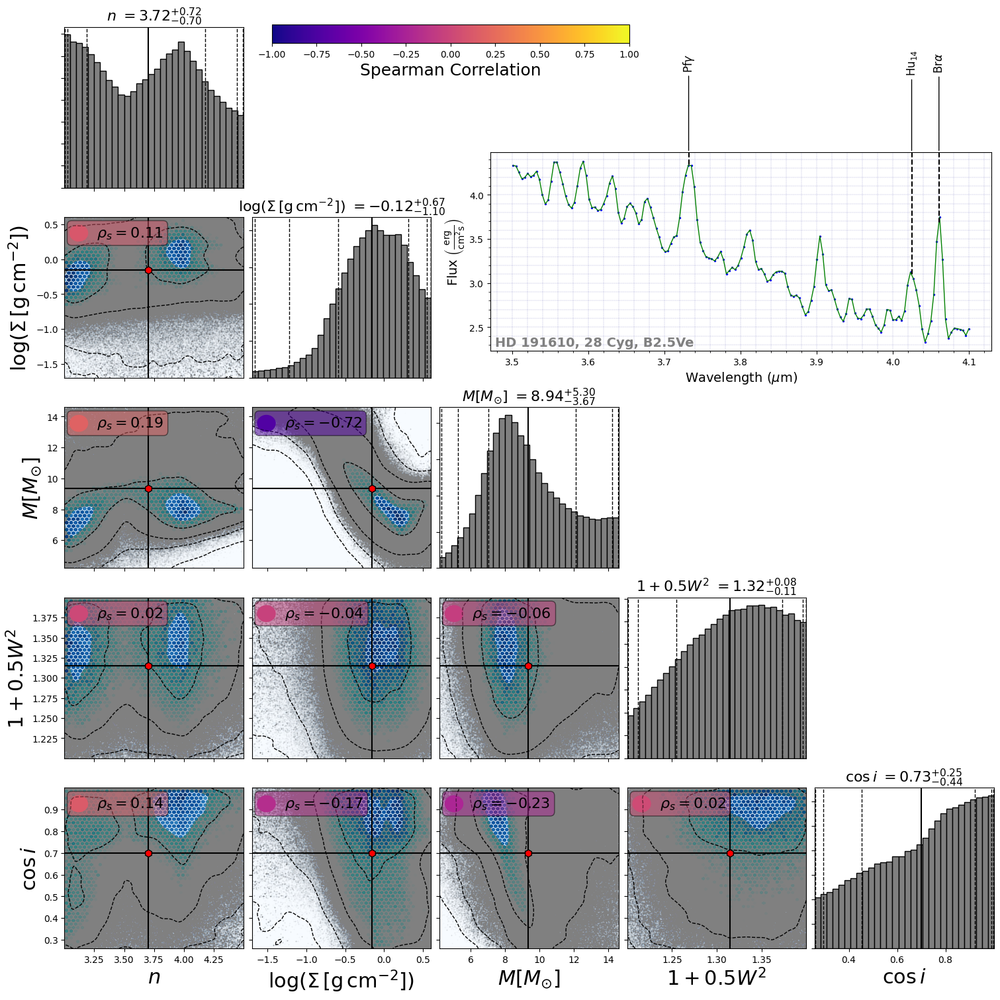

[ 4.42475255  0.23183505 11.03595781  1.31774549  0.80235815]
[ 4.43789902  0.23015772 10.99296315  1.32297603  0.84032354]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 193009, n: V2113 Cyg, u: B1V:nnpe


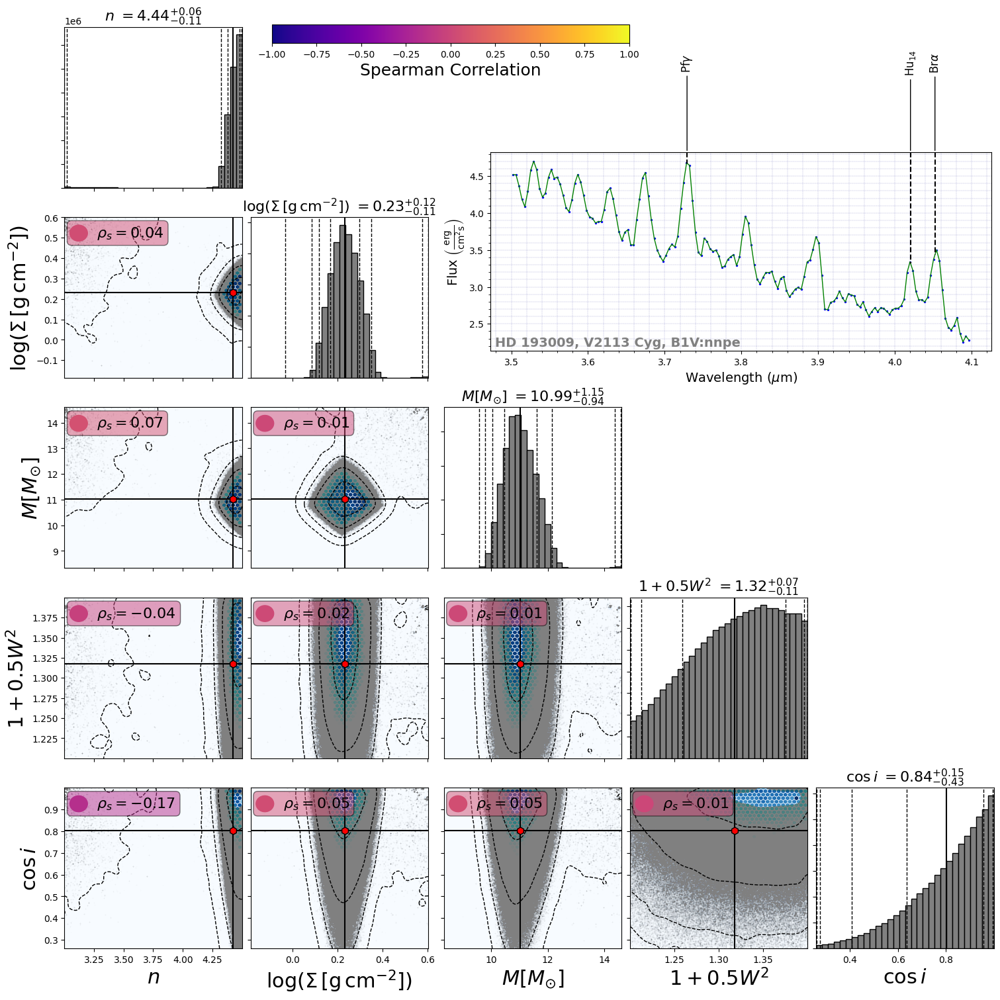

[ 3.727006   -0.20882941  9.46418253  1.31485191  0.69744749]
[ 3.76304299 -0.17020169  9.05541049  1.31928317  0.73063236]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 194335, n: V2119 Cyg, u: B2IIIe


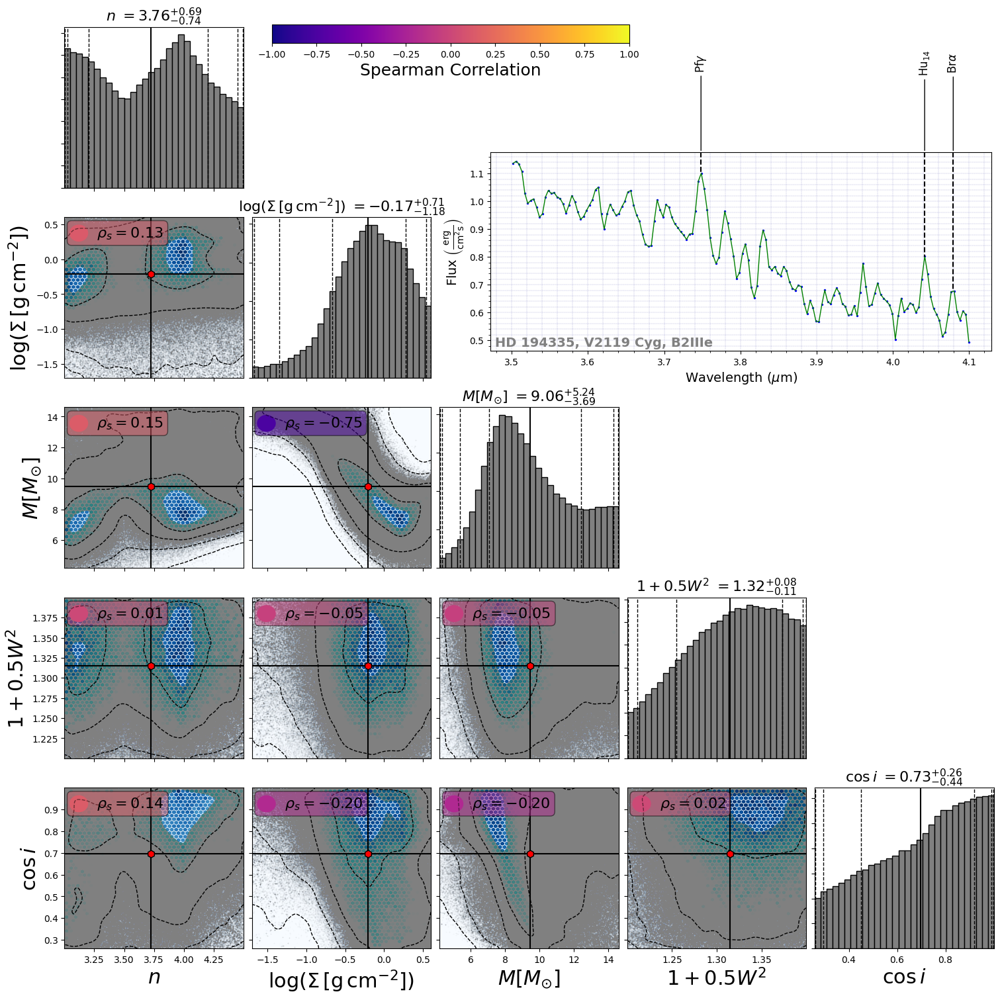

[ 4.37257577  0.24190947 11.1200738   1.31548186  0.7592796 ]
[ 4.40523811  0.23863546 11.04092901  1.31998384  0.79742005]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 194883, n: V2120 Cyg, u: B2Ve


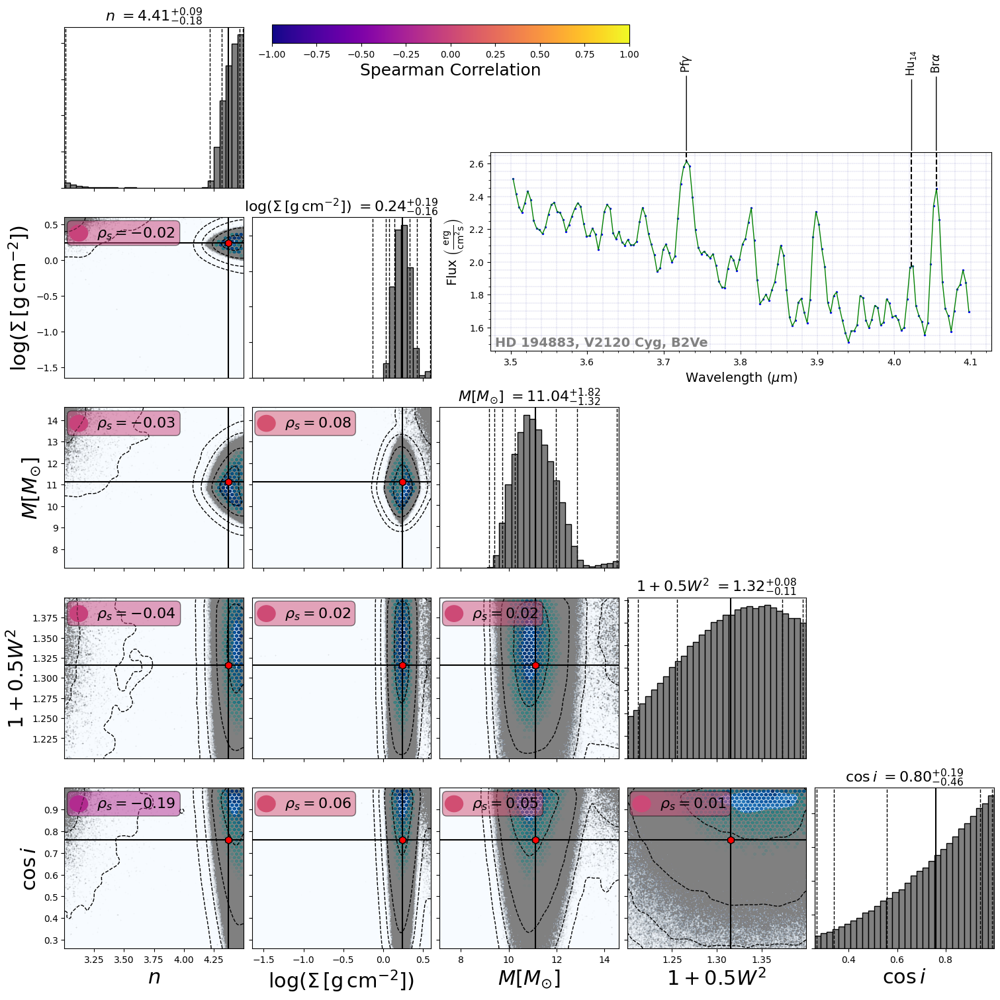

[ 3.79743505 -0.69842768  6.07332297  1.31029212  0.59561266]
[ 3.8035876  -0.73991157  5.8533104   1.31308565  0.57649383]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 217891, n: β Psc, u: B6Ve


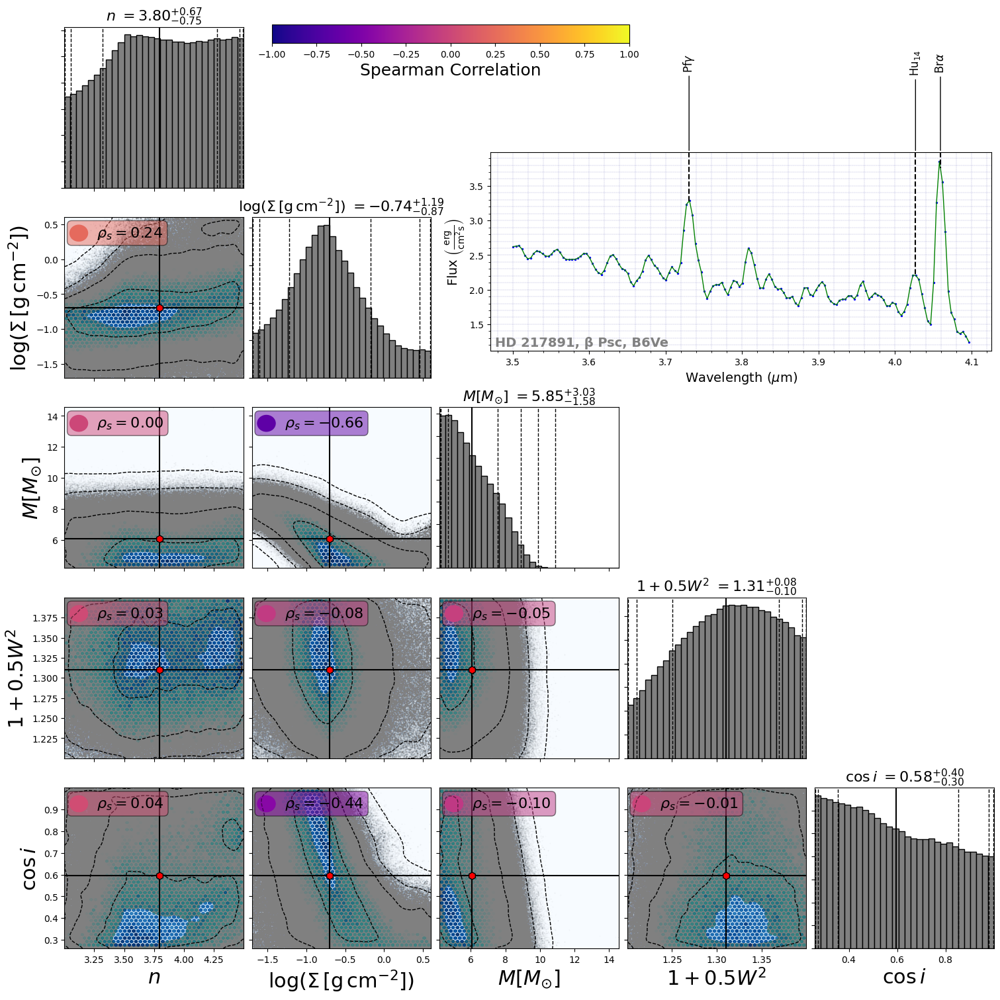

[ 3.75545648 -0.52741164  6.07317994  1.31042036  0.60918525]
[ 3.74101876 -0.55084607  5.75064928  1.31343153  0.59517187]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 217675, n: o And, u: B6IV/V_sh


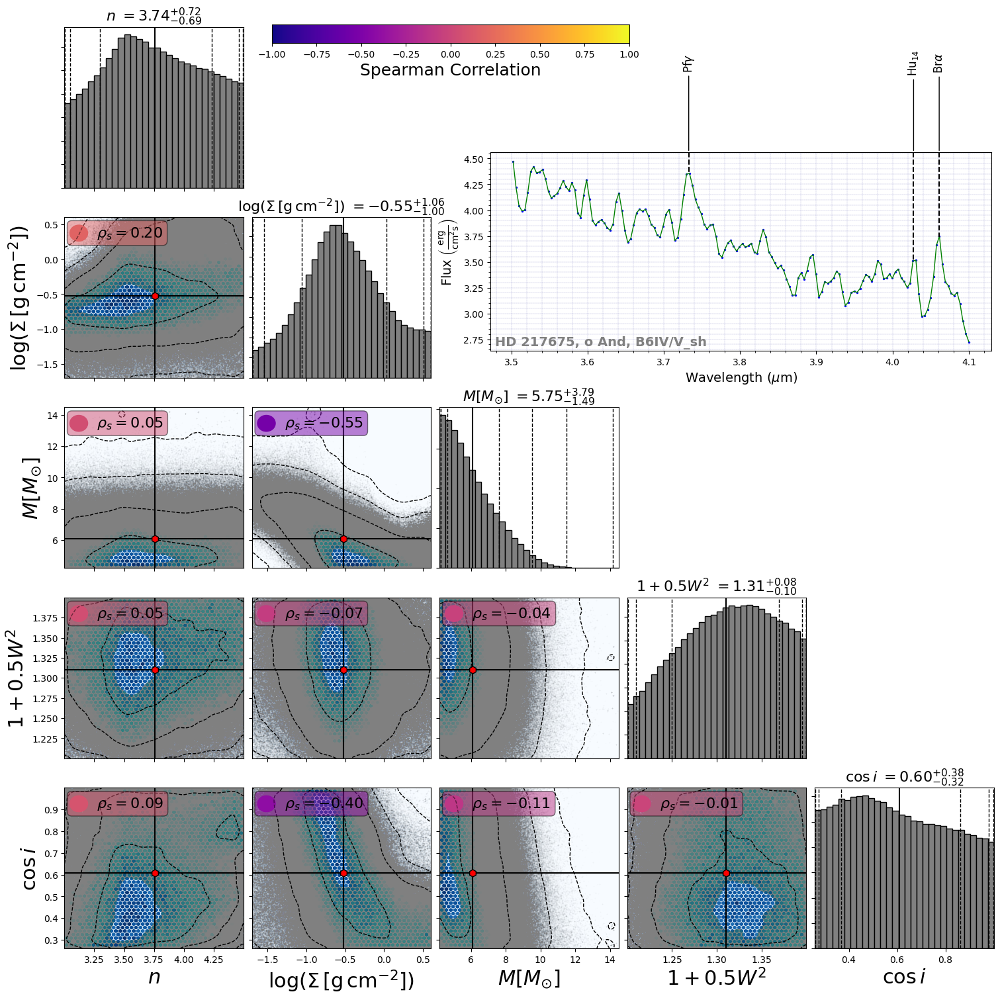

[ 3.68374002 -0.11669024  7.00935084  1.31357855  0.6844579 ]
[ 3.66265103 -0.06168364  6.52835378  1.31753118  0.705276  ]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 210129, n: 25 Peg, u: B7Vne


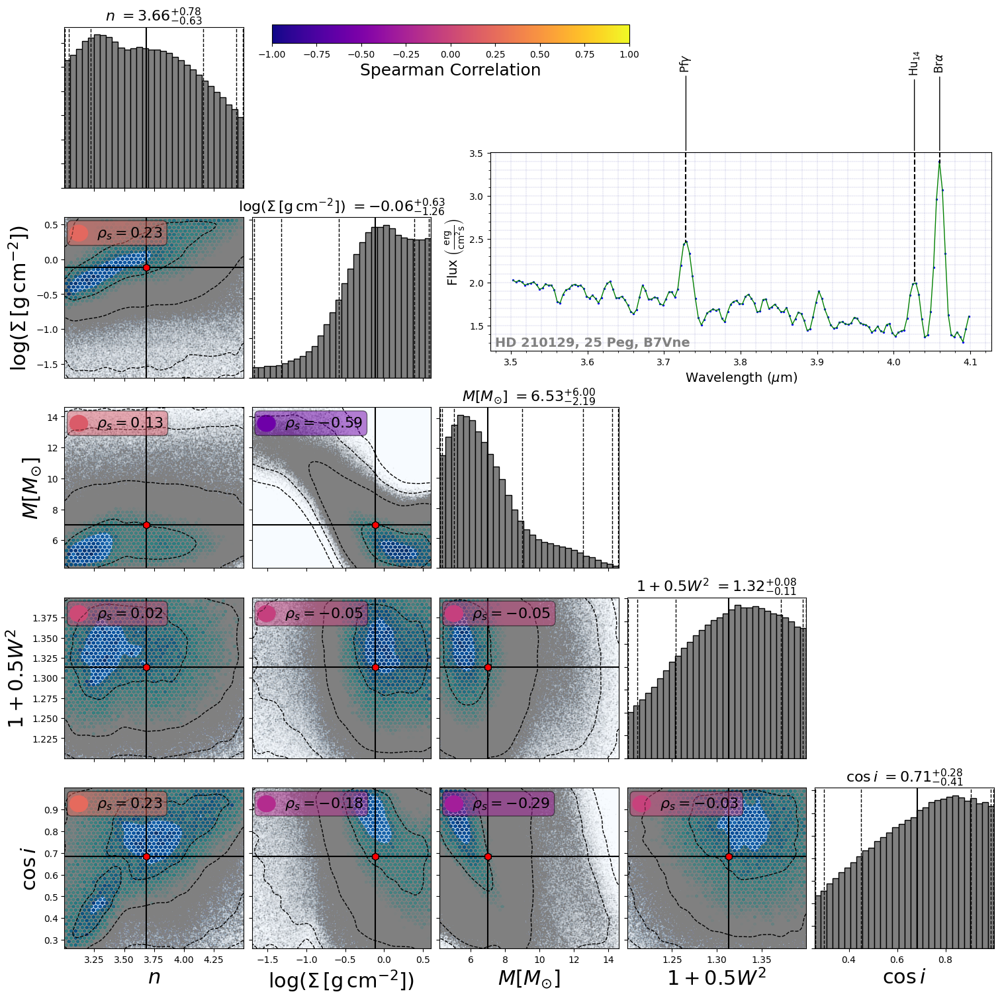

[ 3.70095706  0.35756687 11.90334179  1.31596245  0.75640455]
[ 3.52752166  0.38254682 11.86925555  1.32038957  0.7923037 ]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 204722, n: V2162 Cyg, u: B1.5IV:np


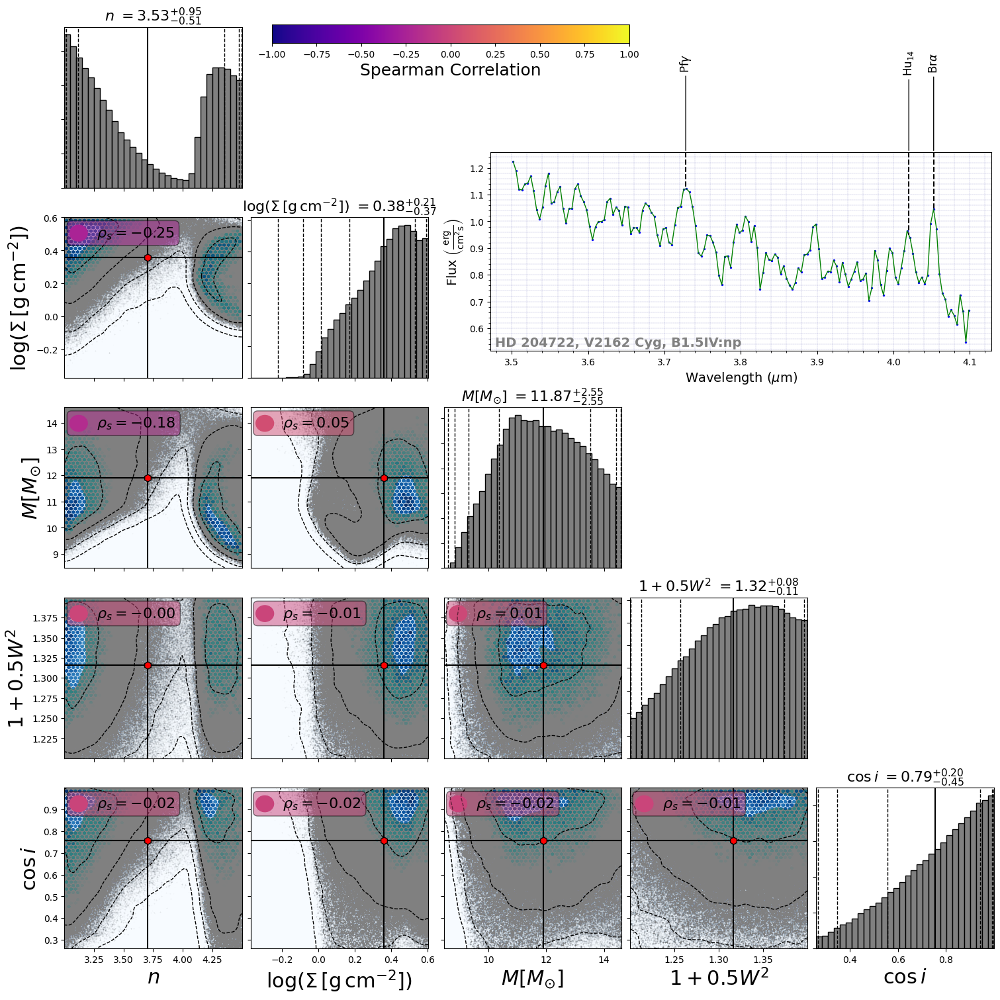

[ 3.71961863  0.33723996 11.65951718  1.31527103  0.73743471]
[ 3.59507196  0.3615316  11.58042599  1.31966121  0.77071999]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 202904, n: υ Cyg, u: B2Vne


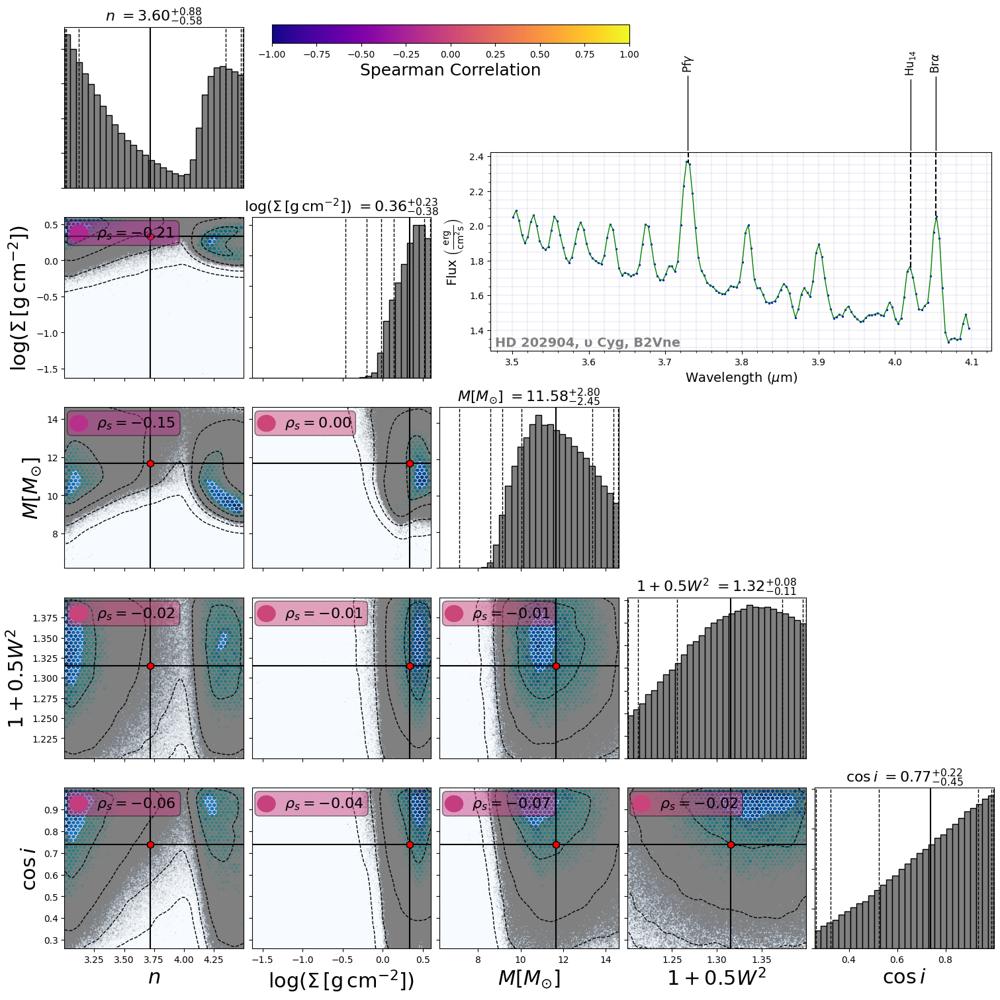

[ 3.8114521   0.35704619 11.97707535  1.31799039  0.78377356]
[ 4.2180995   0.3697779  11.93689229  1.32313649  0.82343302]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 200310, n: 60 Cyg, u: B1Ve


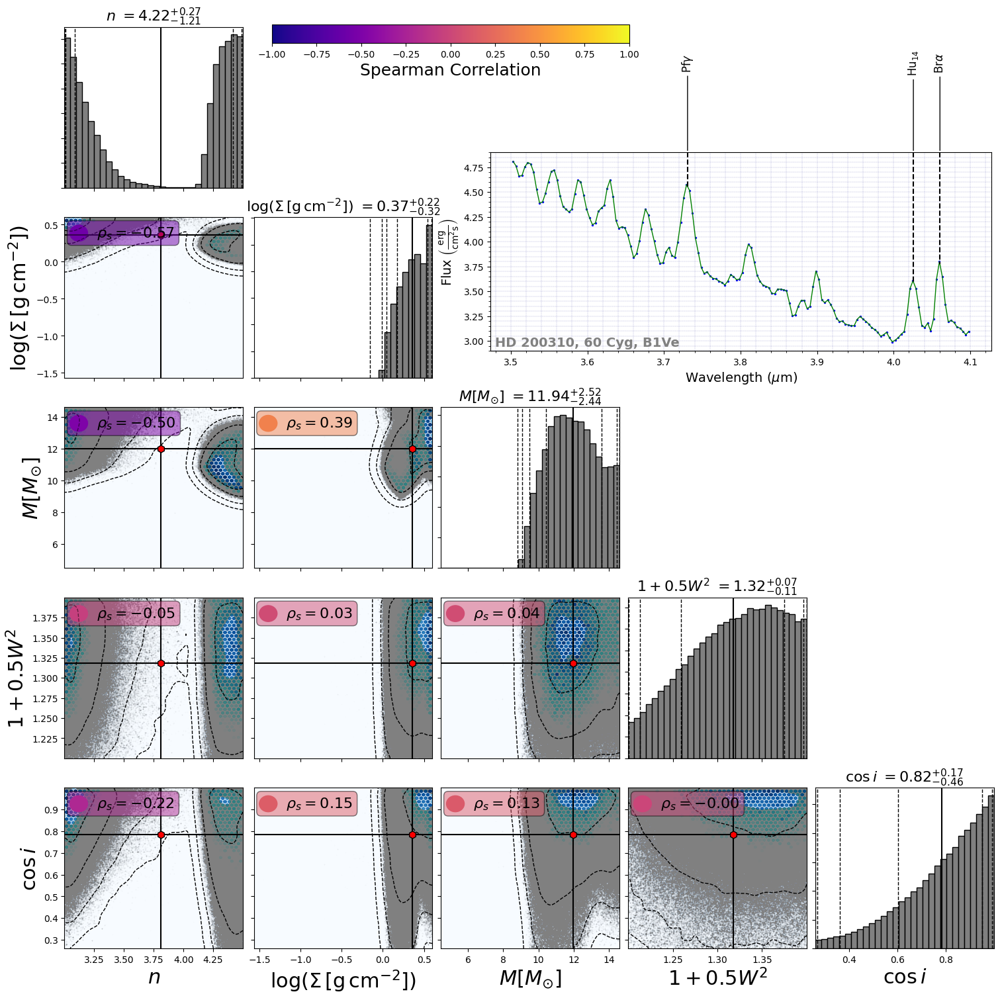

[3.56807155 0.05520572 8.86594103 1.31507066 0.70926623]
[3.48122496 0.09286527 8.6428746  1.31937541 0.7427415 ]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 197419, n: V568 Cyg, u: B2IV-Ve


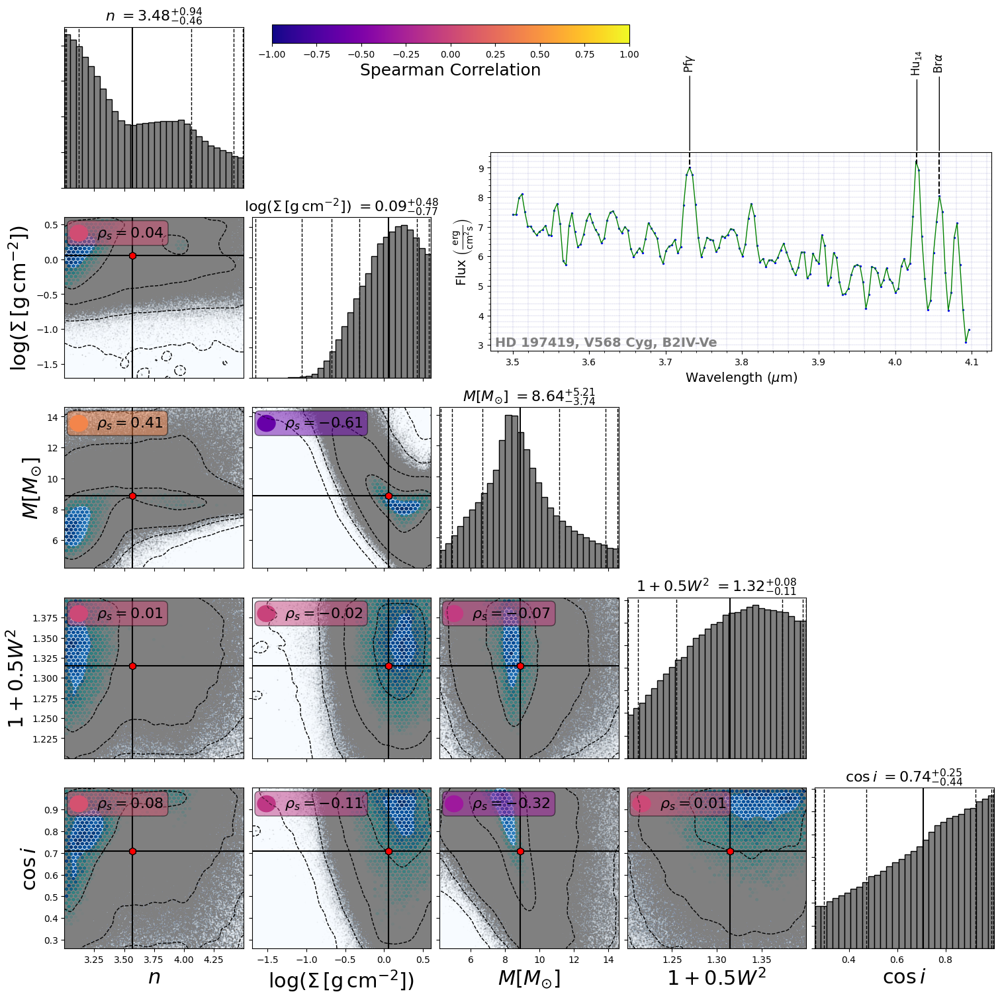

[ 3.86001141  0.3543108  12.0607126   1.3193057   0.80312331]
[ 4.26955389  0.36055697 12.01746812  1.32469737  0.84534696]
[np.float64(2.275013194817923), 50, np.float64(97.72498680518208)]
m: HD 195907, n: V2123 Cyg, u: B1.5V


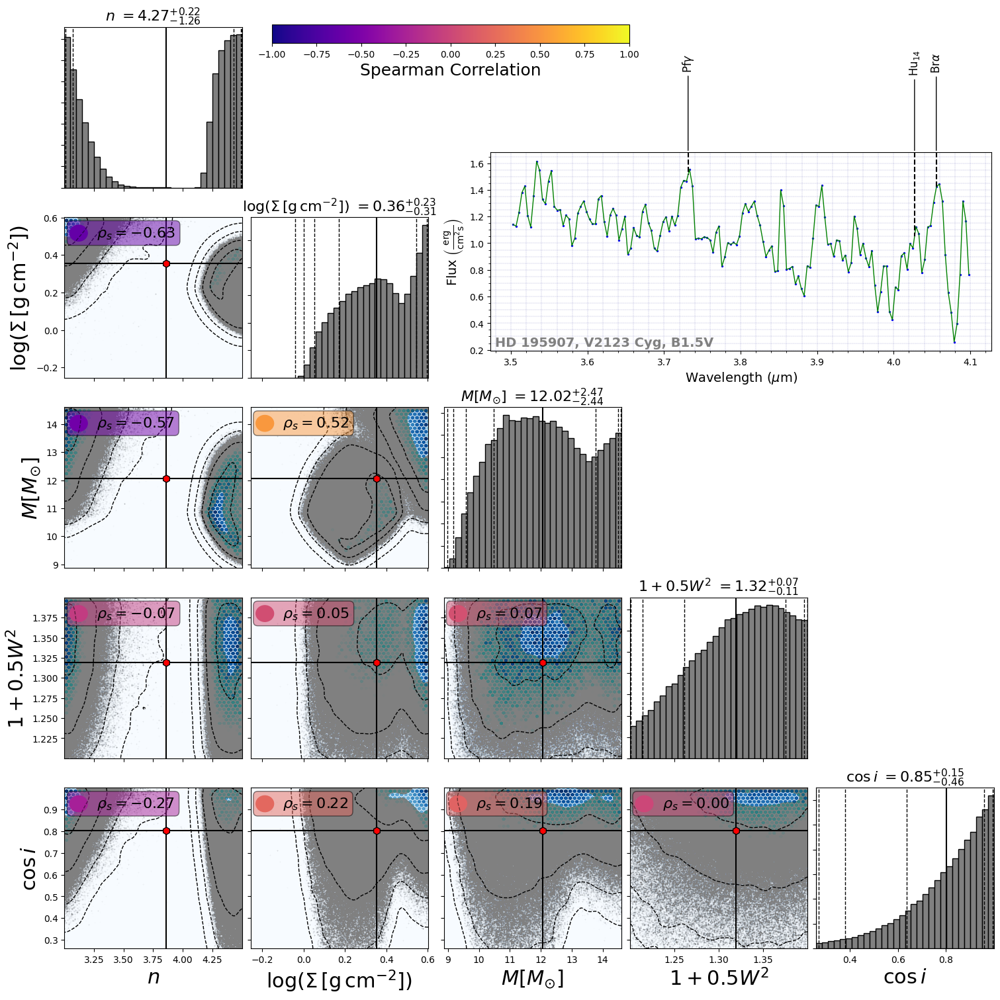

Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E6811.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E11606.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E23302.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E20336.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E23480.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E23630.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersPaper/E23862.txt: No columns to parse from file
Error procesando el archivo del corner plot /content/drive/MyDrive/Be-HDUST/CornersP

In [ ]:
for corner_file in file_paths:
    try:
        # Leer el archivo CSV,excluyendo las primeras 20001 filas
        data = pd.read_csv(corner_file, skiprows=20001, sep='\s+', header=None)
        # Separar la primera columna
        first_column = data.iloc[:, 0]
        # Eliminar la primera columna para el corner plot
        data_first = data.drop(data.columns[0], axis=1).values
        # Crear histogramas de cada columna
        #num_columns = data_first.shape[1]
        #for i in range(num_columns):
            #plt.figure()
            #plt.hist(data_first[:, i], bins=30, edgecolor='k', alpha=0.7)
            #plt.title(f'Histograma de la Columna {i+1}')
            #plt.xlabel('Valor')
            #plt.ylabel('Frecuencia')
            #plt.close()
        # Calcular la media y la mediana de las columnas
        mean_columns = np.mean(data_first, axis=0)
        median_columns = np.median(data_first, axis=0)
        #print("Media de las columnas:")
        print(mean_columns)
        #print("Mediana de las columnas:")
        print(median_columns)
        # Crear el corner plot sin la primera columna
        labels =[r'$n$', r'$\log(\Sigma \,[\mathrm{g \, cm^{-2}}])$', r'$M [M_{\odot}]$', r'$1 + 0.5W^{2}$', r'$\cos i$']
        #print(sigma_to_quantile(1.))
        quantiles = [50-sigma_to_quantile(2.), 50, 50+sigma_to_quantile(2.)]
        print(quantiles)


        cornerplot(
            data_first,
            cmap="Blues",
            correlation_textcolor="black",
            highlight=mean_columns,
            highlight_linecolor="black",
            highlight_markercolor="red",
            hist_backgroundcolor="white",
            hist_edgecolor="black",
            hist_facecolor="gray",
            hex_gridsize=40,
            hist_bins=30,
            labels=labels,
            show_scorrelations=True,
            scatter_alpha=0.01,
            scatter_markercolor="gray",
            scatter_outside_sigma=0.5,
            sigma_levels=[1, 2, 3, 4],
            sigma_linecolor="black",
            sigma_smooth=3,
            title_quantiles=quantiles
        )


    except Exception as e:
        print(f"Error procesando el archivo del corner plot {corner_file}: {e}")

Se encontraron 19 archivos .out


,file,star_id,MAF,Rhat_1,Rhat_2,Rhat_3,Rhat_4,Rhat_5,tau_1,tau_2,tau_3,tau_4,tau_5,Neff_1,Neff_2,Neff_3,Neff_4,Neff_5
0,BINF_ALPHAL_BL__4180__suffix01.out,4180,0.279,1.004,1.003,1.004,1.003,1.004,32.700,26.200,29.800,26.600,29.000,90019.000,112384.400,98606.600,110534.100,101223.900
1,BINF_ALPHAL_BL__5394__suffix01.out,5394,0.226,1.006,1.005,1.006,1.004,1.006,43.600,37.300,39.700,36.900,40.800,67490.800,78865.700,74135.100,79602.000,72000.200
2,BINF_ALPHAL_BL__11606__suffix01.out,11606,0.185,1.017,1.008,1.009,1.006,1.007,67.900,53.500,57.900,49.600,50.800,43274.500,54912.800,50744.500,59229.900,57900.600
3,BINF_ALPHAL_BL__20336__suffix01.out,20336,0.305,1.004,1.003,1.003,1.003,1.003,24.300,24.000,23.800,22.500,24.700,121219.700,122689.100,123559.100,130954.000,118806.600
4,BINF_ALPHAL_BL__23480__suffix01.out,23480,0.320,1.003,1.003,1.003,1.002,1.002,21.700,22.800,21.300,20.200,21.600,135540.300,129088.600,138177.100,145546.600,136301.200
5,BINF_ALPHAL_BL__23630__suffix01.out,23630,0.258,1.004,1.004,1.004,1.004,1.004,33.600,28.600,30.200,27.800,30.900,87522.100,102623.700,97374.200,105856.700,95264.400
6,BINF_ALPHAL_BL__23862__suffix01.out,23862,0.316,1.003,1.003,1.002,1.002,1.002,22.100,25.000,21.200,20.600,21.700,133049.400,117431.600,138715.000,142765.100,135297.300
7,BINF_ALPHAL_BL__191610__suffix01.out,191610,0.291,1.003,1.004,1.003,1.003,1.003,28.200,27.800,24.900,25.000,26.200,104437.700,105700.100,118204.700,117371.800,112349.400
8,BINF_ALPHAL_BL__193009__suffix01.out,193009,0.235,1.525,1.028,1.032,1.005,1.005,41.700,30.900,36.000,33.300,33.600,70524.000,95153.400,81734.000,88321.200,87439.200
9,BINF_ALPHAL_BL__194335__suffix01.out,194335,0.284,1.004,1.004,1.004,1.003,1.003,29.600,29.100,26.300,26.100,28.200,99172.400,100869.000,111807.600,112550.400,104232.000


FileNotFoundError: [Errno 2] No such file or directory: 'figures/maf_per_star.png'

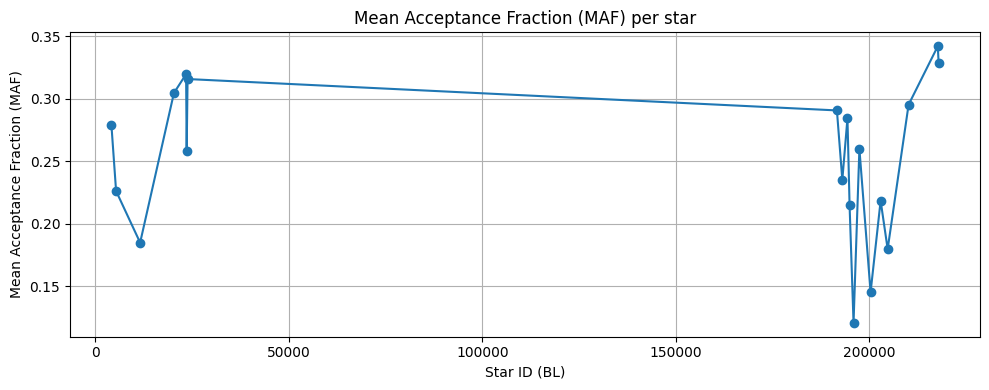

In [15]:
import os
import glob
import re

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display

# Ruta base (ya la tienes)
path_two = "/content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01"

# -------------------------------------------------------------------
# 1. Función para extraer star_id, MAF, Rhat, tau, Neff de un archivo .out
# -------------------------------------------------------------------
def parse_out_file(filepath):
    data = {
        "file": os.path.basename(filepath),
        "star_id": None,
        "MAF": None,
        "Rhat": None,
        "tau": None,
        "Neff": None,
    }

    # Extraer star_id del nombre del archivo: BINF_ALPHAL_BL__<ID>__suffix01.out
    m = re.search(r"BL__([0-9]+)__suffix", data["file"])
    if m:
        data["star_id"] = int(m.group(1))

    # Leer el archivo y buscar las líneas relevantes
    with open(filepath, "r") as f:
        for line in f:
            # Normalizamos espacios
            line_clean = line.strip()
            # Extraer todos los números de la línea (enteros o floats)
            nums = re.findall(r"[-+]?\d*\.\d+|\d+", line_clean)
            if "MAF" in line_clean and nums:
                # Tomamos el primer número como MAF
                data["MAF"] = float(nums[0])
            elif "Rhat" in line_clean and nums:
                data["Rhat"] = [float(x) for x in nums]
            elif "tau" in line_clean and nums:
                data["tau"] = [float(x) for x in nums]
            elif "Neff" in line_clean and nums:
                data["Neff"] = [float(x) for x in nums]

    return data

# -------------------------------------------------------------------
# 2. Recorrer todos los .out en la carpeta y parsearlos
# -------------------------------------------------------------------
filepaths = sorted(glob.glob(os.path.join(path_two, "*.out")))
print(f"Se encontraron {len(filepaths)} archivos .out")

rows = []
for fp in filepaths:
    rows.append(parse_out_file(fp))

# -------------------------------------------------------------------
# 3. Convertir a DataFrame y expandir Rhat, tau, Neff en columnas
# -------------------------------------------------------------------
df = pd.DataFrame(rows)

# Longitud máxima de cada lista
max_len_rhat = max((len(r) for r in df["Rhat"] if isinstance(r, list)), default=0)
max_len_tau = max((len(t) for t in df["tau"] if isinstance(t, list)), default=0)
max_len_neff = max((len(n) for n in df["Neff"] if isinstance(n, list)), default=0)

for i in range(max_len_rhat):
    df[f"Rhat_{i+1}"] = df["Rhat"].apply(
        lambda x: x[i] if isinstance(x, list) and len(x) > i else np.nan
    )

for i in range(max_len_tau):
    df[f"tau_{i+1}"] = df["tau"].apply(
        lambda x: x[i] if isinstance(x, list) and len(x) > i else np.nan
    )

for i in range(max_len_neff):
    df[f"Neff_{i+1}"] = df["Neff"].apply(
        lambda x: x[i] if isinstance(x, list) and len(x) > i else np.nan
    )

# Ya no necesitamos las listas originales
df = df.drop(columns=["Rhat", "tau", "Neff"])

# Ordenamos por star_id para que quede bonito
df = df.sort_values("star_id").reset_index(drop=True)

# -------------------------------------------------------------------
# 4. Mostrar tabla estilizada
# -------------------------------------------------------------------
# Columnas numéricas (excepto star_id si quieres)
num_cols = [c for c in df.columns if c not in ["file", "star_id"]]

styled = (df.style
            .format(precision=3)
            .background_gradient(axis=None, subset=num_cols)
            .set_caption("Resumen de convergencia por estrella (MAF, Rhat, tau, Neff)")
            .set_table_styles(
                [
                    {
                        "selector": "caption",
                        "props": [("caption-side", "top"),
                                  ("font-size", "16px"),
                                  ("font-weight", "bold")]
                    },
                    {
                        "selector": "th",
                        "props": [("background-color", "#f0f0f0"),
                                  ("font-weight", "bold")]
                    },
                ]
            )
         )

display(styled)

# -------------------------------------------------------------------
# 5. Plots
# -------------------------------------------------------------------

# Physical parameter labels (for columns Rhat_* and Neff_*)
param_labels = [
    r"$n$",
    r"$\log \Sigma\ \mathrm{[g\ cm^{-2}]}$",
    r"$M\ [M_\odot]$",
    r"$1+0.5\,W^2$",
    r"$\cos i$"
]

# 5.1 MAF per star
plt.figure(figsize=(10, 4))
plt.plot(df["star_id"], df["MAF"], marker="o")
plt.xlabel("Star ID (BL)")
plt.ylabel("Mean Acceptance Fraction (MAF)")
plt.title("Mean Acceptance Fraction (MAF) per star")
plt.grid(True)
plt.tight_layout()
plt.savefig("figures/maf_per_star.png", dpi=300, bbox_inches="tight")
plt.show()

# 5.2 Heatmap of Rhat (if Rhat columns exist)
rhat_cols = [c for c in df.columns if c.startswith("Rhat_")]
if rhat_cols:
    plt.figure(figsize=(8, max(4, 0.4 * len(df))))
    rhat_values = df[rhat_cols].values
    im = plt.imshow(rhat_values, aspect="auto", cmap="coolwarm")
    plt.colorbar(im, label="Rhat")
    # Use physical parameter names if there are 5 parameters
    if len(rhat_cols) == len(param_labels):
        plt.xticks(range(len(rhat_cols)), param_labels, rotation=45)
    else:
        plt.xticks(range(len(rhat_cols)), rhat_cols, rotation=45)
    plt.yticks(range(len(df)), df["star_id"])
    plt.xlabel("Parameter")
    plt.ylabel("Star ID (BL)")
    plt.title("Rhat per parameter and star")
    plt.tight_layout()
    plt.savefig("figures/rhat_per_parameter_star.png", dpi=300, bbox_inches="tight")
    plt.show()

# 5.3 Heatmap of Neff (optional and similar)
neff_cols = [c for c in df.columns if c.startswith("Neff_")]
if neff_cols:
    plt.figure(figsize=(8, max(4, 0.4 * len(df))))
    neff_values = df[neff_cols].values
    im = plt.imshow(neff_values, aspect="auto")
    plt.colorbar(im, label="Neff")
    # Use physical parameter names if there are 5 parameters
    if len(neff_cols) == len(param_labels):
        plt.xticks(range(len(neff_cols)), param_labels, rotation=45)
    else:
        plt.xticks(range(len(neff_cols)), neff_cols, rotation=45)
    plt.yticks(range(len(df)), df["star_id"])
    plt.xlabel("Parameter")
    plt.ylabel("Star ID (BL)")
    plt.title("Effective sample size (Neff) per parameter and star")
    plt.tight_layout()
    plt.savefig("figures/neff_per_parameter_star.png", dpi=300, bbox_inches="tight")
    plt.show()

In [13]:
import os

# Ruta donde quieres guardar los archivos (puede ser path_two u otra)
output_dir = path  # o por ejemplo: path_two + "/tables"

# Si quieres, puedes crear una subcarpeta "tables"
# output_dir = os.path.join(path_two, "tables")
# os.makedirs(output_dir, exist_ok=True)

csv_path = os.path.join(output_dir, "convergence_summary.csv")

# Opcional: redondear a 3 decimales antes de guardar
df_csv = df.copy()
for col in df_csv.columns:
    if df_csv[col].dtype == "float64":
        df_csv[col] = df_csv[col].round(3)

df_csv.to_csv(csv_path, index=False)
print("CSV guardado en:", csv_path)


CSV guardado en: /content/drive/MyDrive/Be-HDUST/CornersPaper/convergence_summary.csv


In [14]:
latex_path = os.path.join(output_dir, "convergence_summary.tex")

# Versión formateada para paper (redondeos + nombres algo más "bonitos" si quieres)
df_latex = df.copy()

# Redondear floats
for col in df_latex.columns:
    if df_latex[col].dtype == "float64":
        df_latex[col] = df_latex[col].round(3)

# (Opcional) Renombrar columnas para paper
# Ajusta los nombres de acuerdo a tus parámetros reales:
rename_dict = {}
# rename_dict["star_id"] = r"$\mathrm{ID}$"
# rename_dict["MAF"] = r"$\mathrm{MAF}$"
# rename_dict["Rhat_1"] = r"$\hat{R}_1$"
# rename_dict["Rhat_2"] = r"$\hat{R}_2$"
# ...
df_latex = df_latex.rename(columns=rename_dict)

latex_table = df_latex.to_latex(
    index=False,
    escape=False,      # para que respete el LaTeX en nombres como $\hat{R}$
    column_format="l" + "c" * (df_latex.shape[1] - 1)  # primera col izquierda, resto centrado
)

with open(latex_path, "w") as f:
    f.write(latex_table)

print("Tabla LaTeX guardada en:", latex_path)


Tabla LaTeX guardada en: /content/drive/MyDrive/Be-HDUST/CornersPaper/convergence_summary.tex


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import glob
import os

path_two = "/content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01"

def load_chain_from_out(filepath):
    """
    Lee un archivo .out y devuelve un array (N, n_cols)
    solo con las filas numéricas (las muestras MCMC).
    Ignora las líneas de MAF, Rhat, tau, Neff, etc.
    """
    rows = []
    n_cols = None

    with open(filepath, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) == 0:
                continue

            # Intentamos convertir todo a float; si falla, es cabecera
            try:
                vals = [float(p) for p in parts]
            except ValueError:
                continue  # línea con texto (MAF, Rhat, etc.)

            if n_cols is None:
                n_cols = len(vals)
            # solo aceptamos filas con el número correcto de columnas
            if len(vals) == n_cols:
                rows.append(vals)

    chain = np.array(rows)
    return chain


In [ ]:
def autocorrelation(x, max_lag=100):
    """
    Autocorrelación normalizada hasta max_lag usando FFT.
    """
    x = np.asarray(x)
    x = x - x.mean()
    n = len(x)

    if max_lag >= n:
        max_lag = n - 1

    # siguiente potencia de 2 para acelerar FFT
    nfft = 1 << int(np.ceil(np.log2(2 * n - 1)))
    fx = np.fft.fft(x, nfft)
    acf = np.fft.ifft(fx * np.conjugate(fx)).real
    acf = acf[:n]
    acf = acf / acf[0]  # normalizar

    return acf[:max_lag + 1]


In [ ]:
def plot_trace(chain, param_labels=None, title=None):
    """
    Hace un figure con subplots (n_params, 1) para la traza de cada columna.
    """
    n_samples, n_params = chain.shape

    if param_labels is None:
        # por defecto: primera columna logpost, resto parámetros
        param_labels = ["log_posterior"] + [f"param_{i}" for i in range(1, n_params)]

    fig, axes = plt.subplots(
        n_params, 1,
        figsize=(10, 2.0 * n_params),
        sharex=True
    )

    if n_params == 1:
        axes = [axes]

    x = np.arange(n_samples)

    for i in range(n_params):
        ax = axes[i]
        ax.plot(x, chain[:, i], linewidth=0.8)
        ax.set_ylabel(param_labels[i])
        ax.grid(True, alpha=0.3)

    axes[-1].set_xlabel("Iteración")

    if title is not None:
        fig.suptitle(title, fontsize=14)
        plt.subplots_adjust(top=0.92)

    plt.tight_layout()
    plt.show()


In [ ]:
def plot_autocorr(chain, max_lag=100, param_labels=None, title=None):
    """
    Hace un figure con subplots (n_params, 1) para la autocorrelación de cada columna.
    """
    n_samples, n_params = chain.shape

    if param_labels is None:
        param_labels = ["log_posterior"] + [f"param_{i}" for i in range(1, n_params)]

    fig, axes = plt.subplots(
        n_params, 1,
        figsize=(10, 2.0 * n_params),
        sharex=True
    )

    if n_params == 1:
        axes = [axes]

    lags = None

    for i in range(n_params):
        ax = axes[i]
        acf = autocorrelation(chain[:, i], max_lag=max_lag)
        if lags is None:
            lags = np.arange(len(acf))

        # stem plot (bonito para ACF)
        markerline, stemlines, baseline = ax.stem(lags, acf)
        # un poco más limpio
        baseline.set_visible(False)
        ax.set_ylabel(param_labels[i])
        ax.grid(True, alpha=0.3)
        ax.set_xlim(0, max_lag)

    axes[-1].set_xlabel("Lag")

    if title is not None:
        fig.suptitle(title, fontsize=14)
        plt.subplots_adjust(top=0.92)

    plt.tight_layout()
    plt.show()

Archivo: BINF_ALPHAL_BL__11606__suffix01.out  – shape: (3150000, 6)


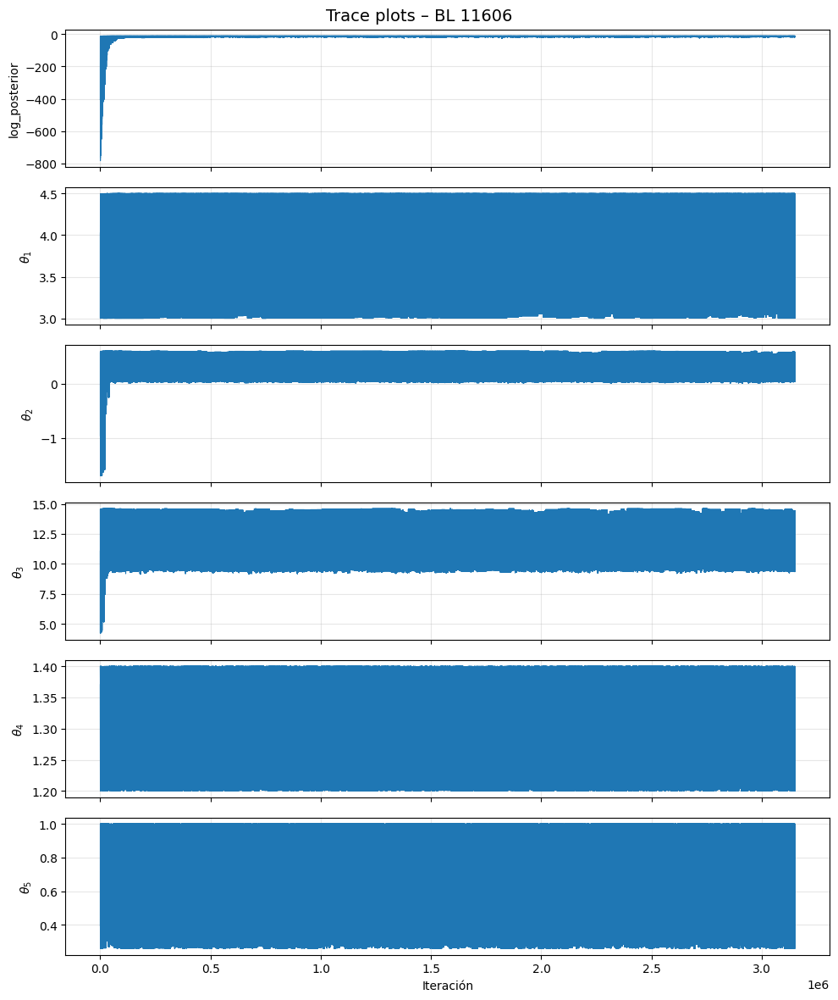

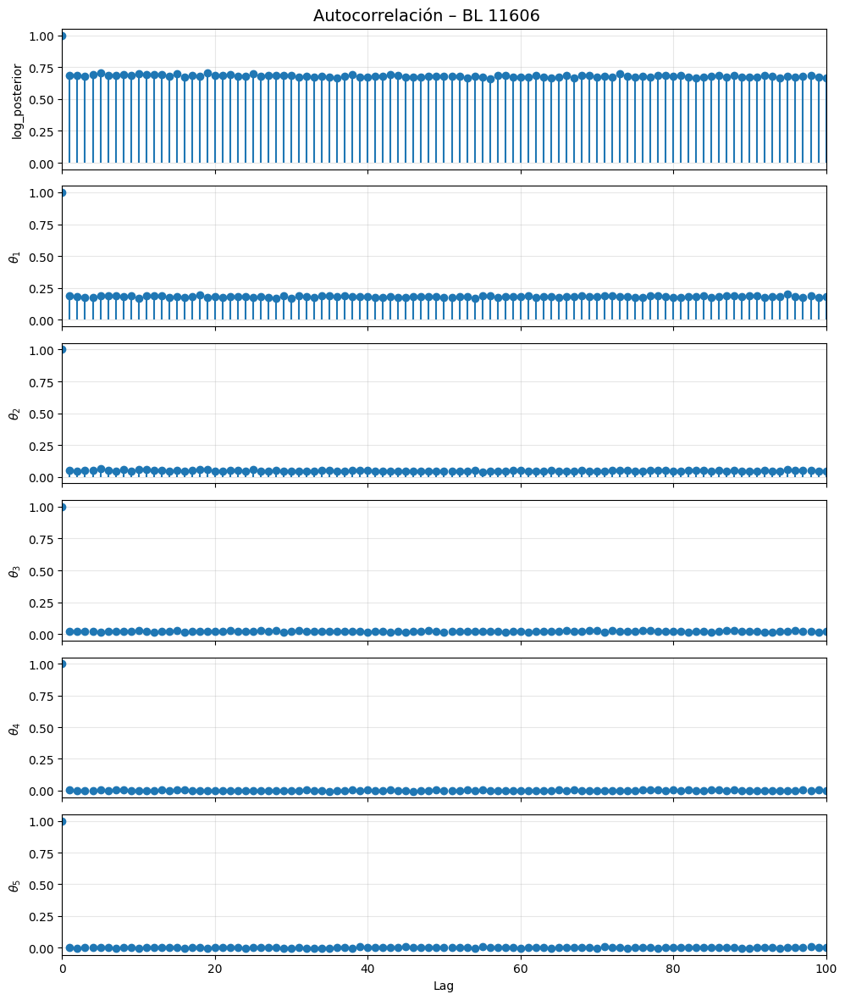

Archivo: BINF_ALPHAL_BL__191610__suffix01.out  – shape: (3150000, 6)


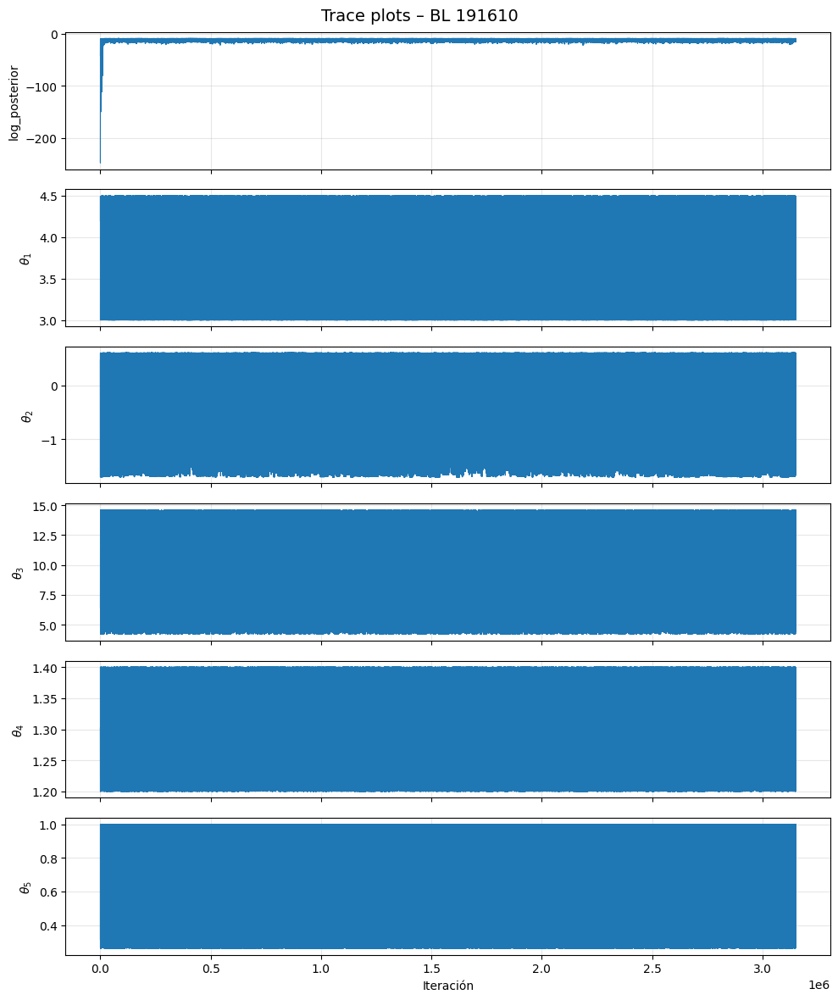

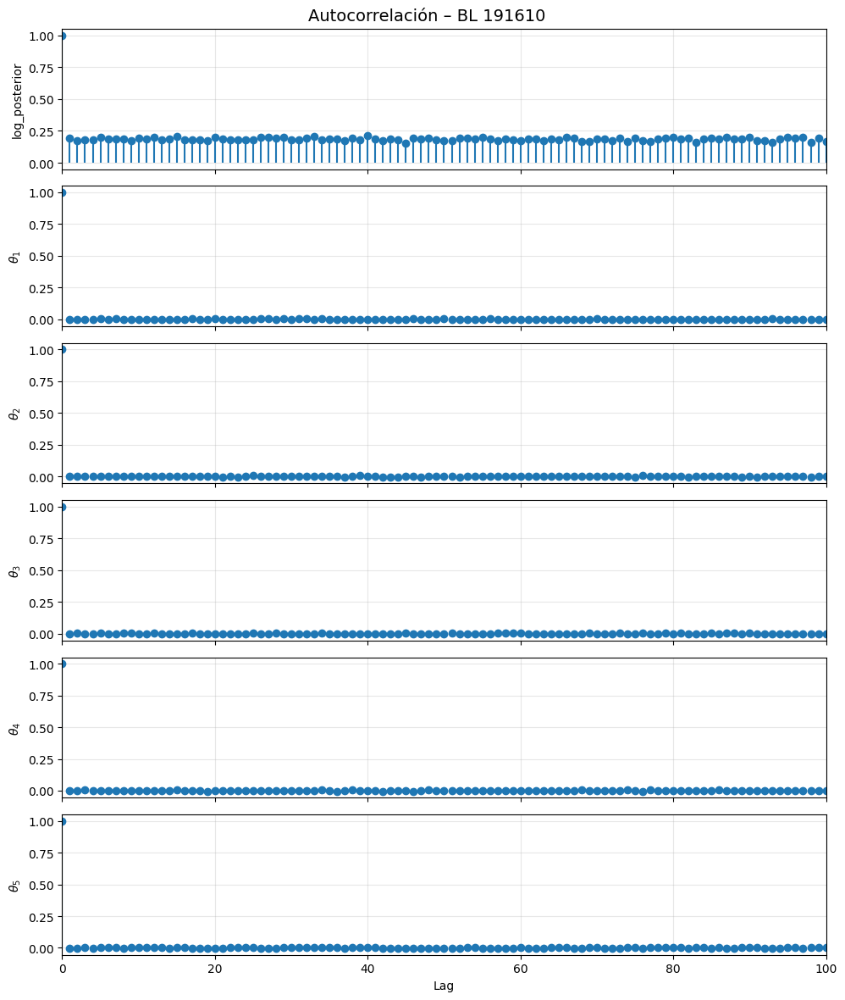

Archivo: BINF_ALPHAL_BL__193009__suffix01.out  – shape: (3150000, 6)


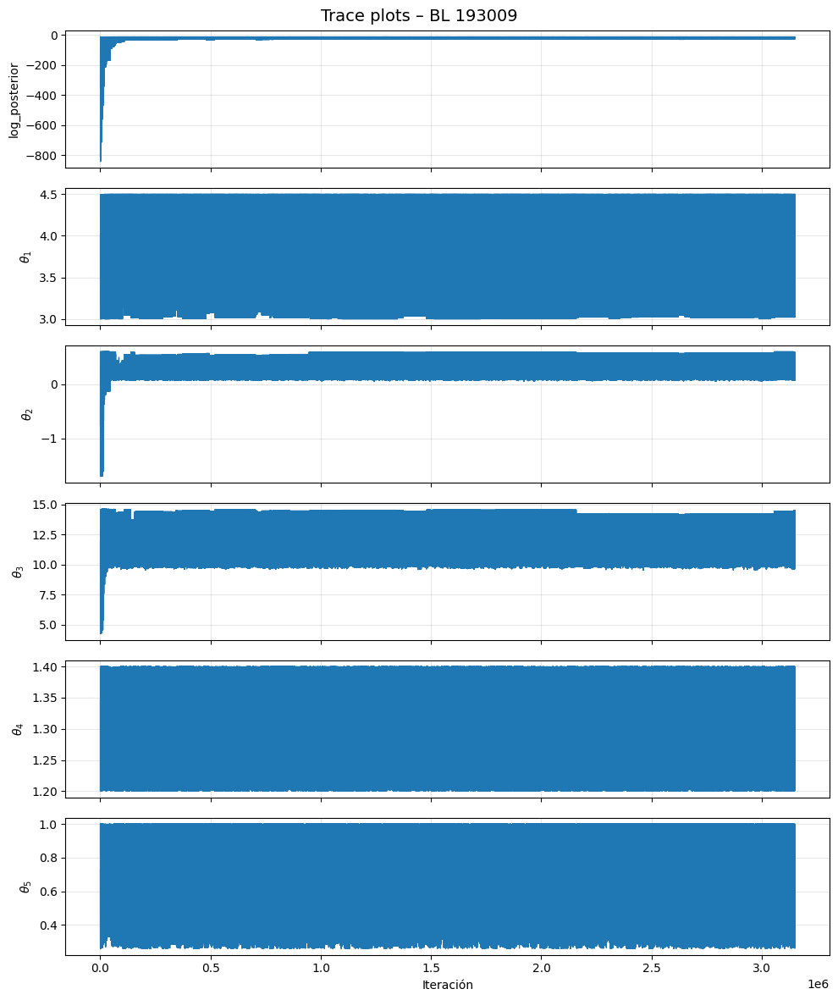

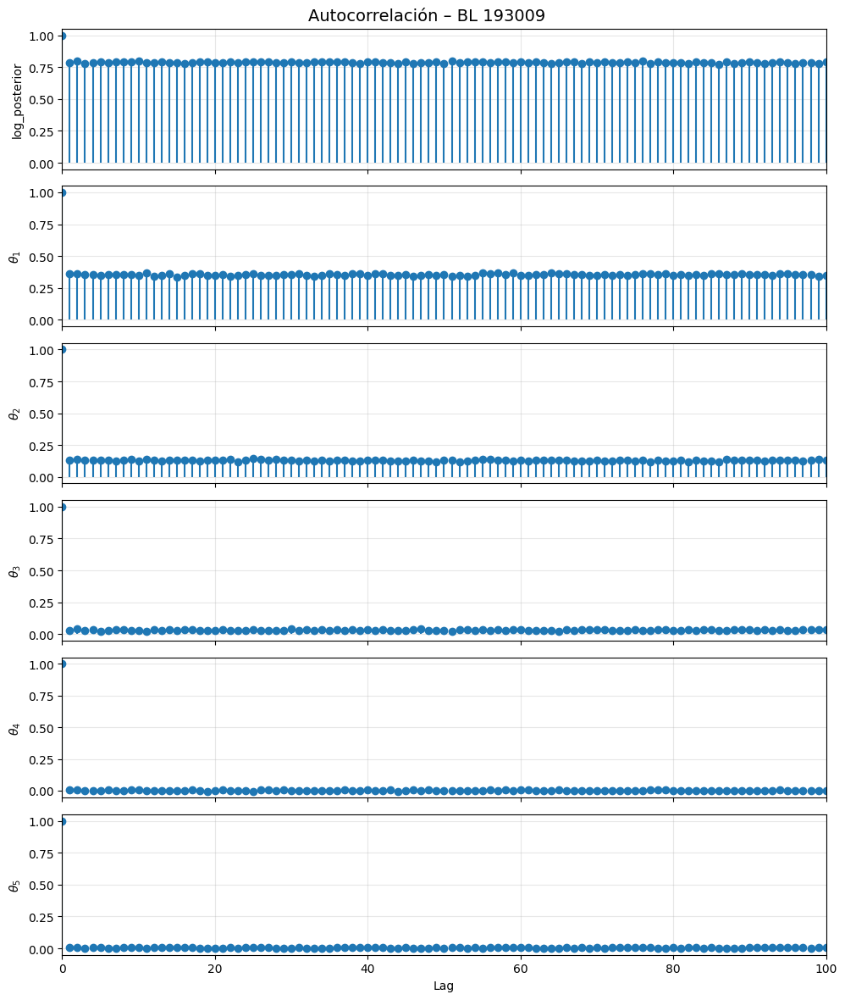

Archivo: BINF_ALPHAL_BL__194335__suffix01.out  – shape: (3150000, 6)


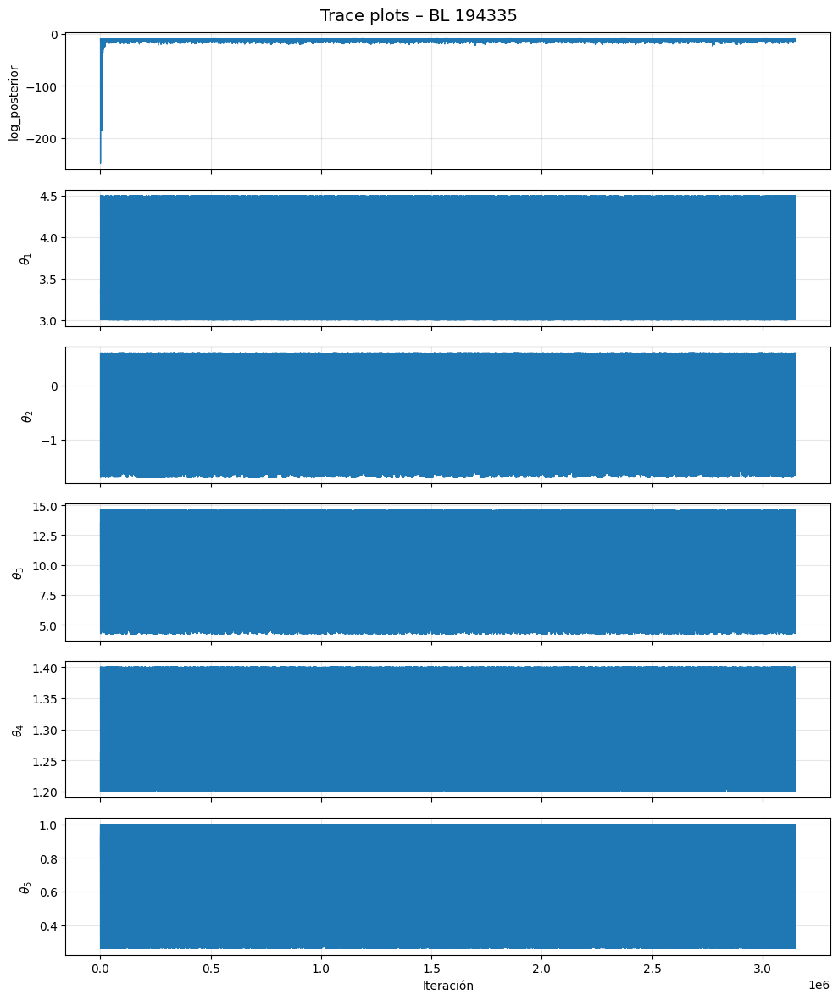

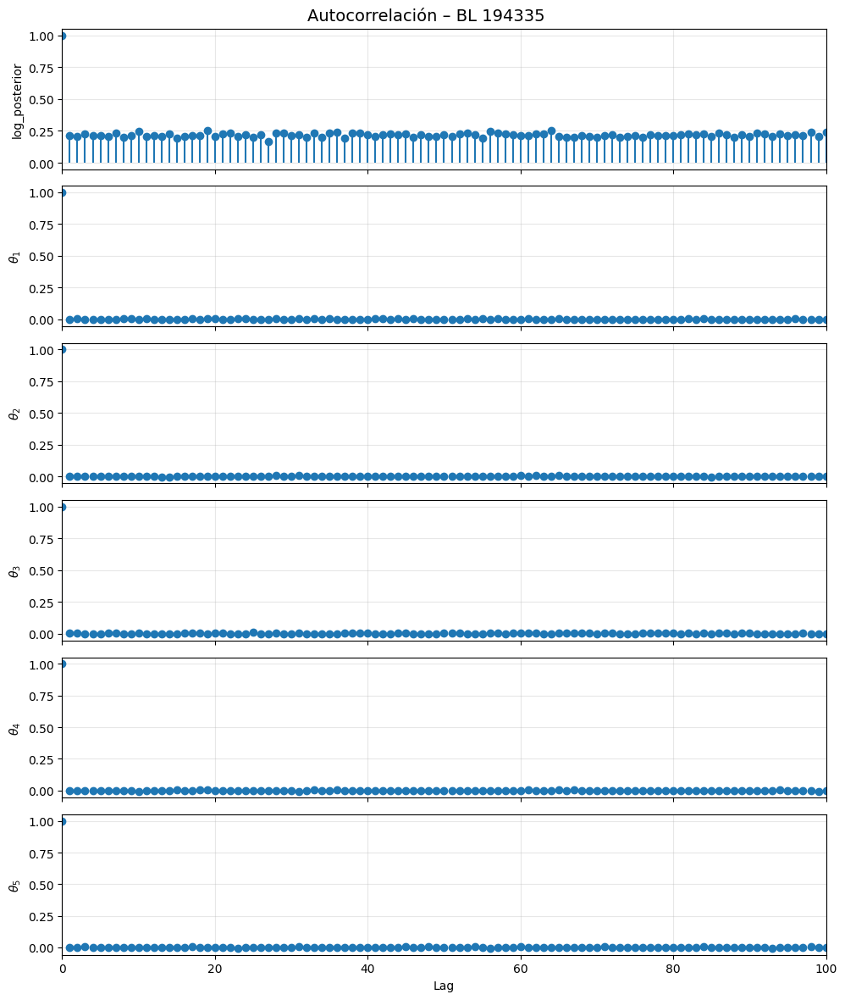

Archivo: BINF_ALPHAL_BL__194883__suffix01.out  – shape: (3150000, 6)


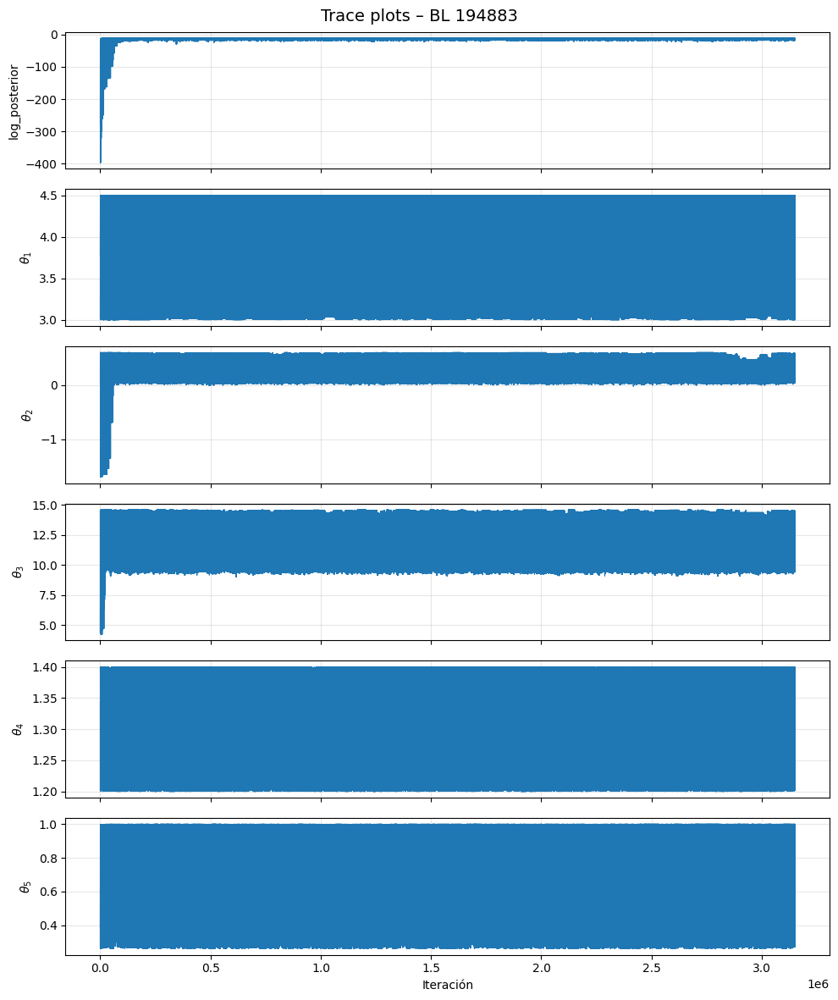

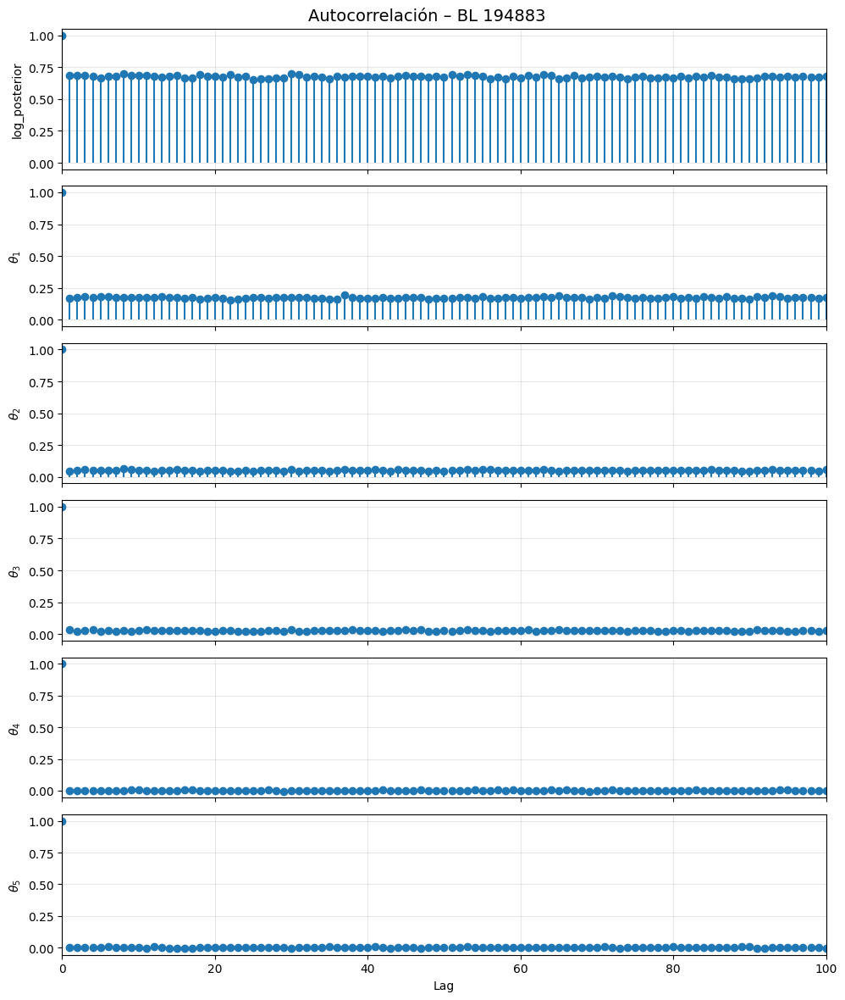

Archivo: BINF_ALPHAL_BL__195907__suffix01.out  – shape: (3150000, 6)


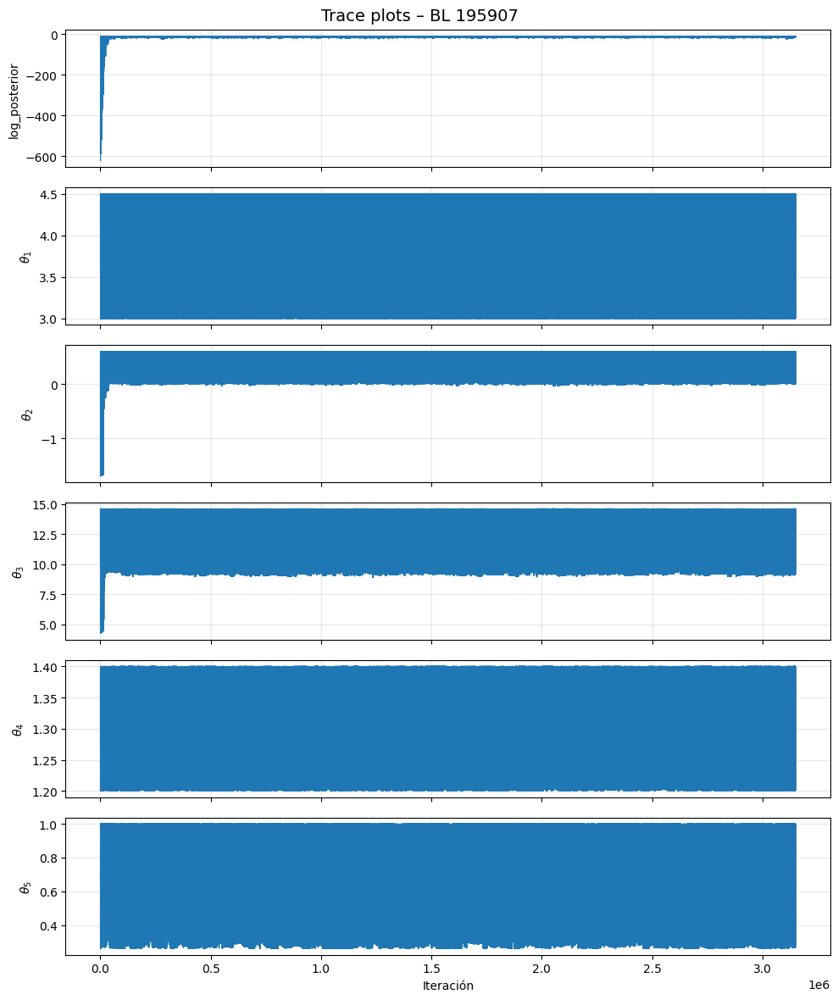

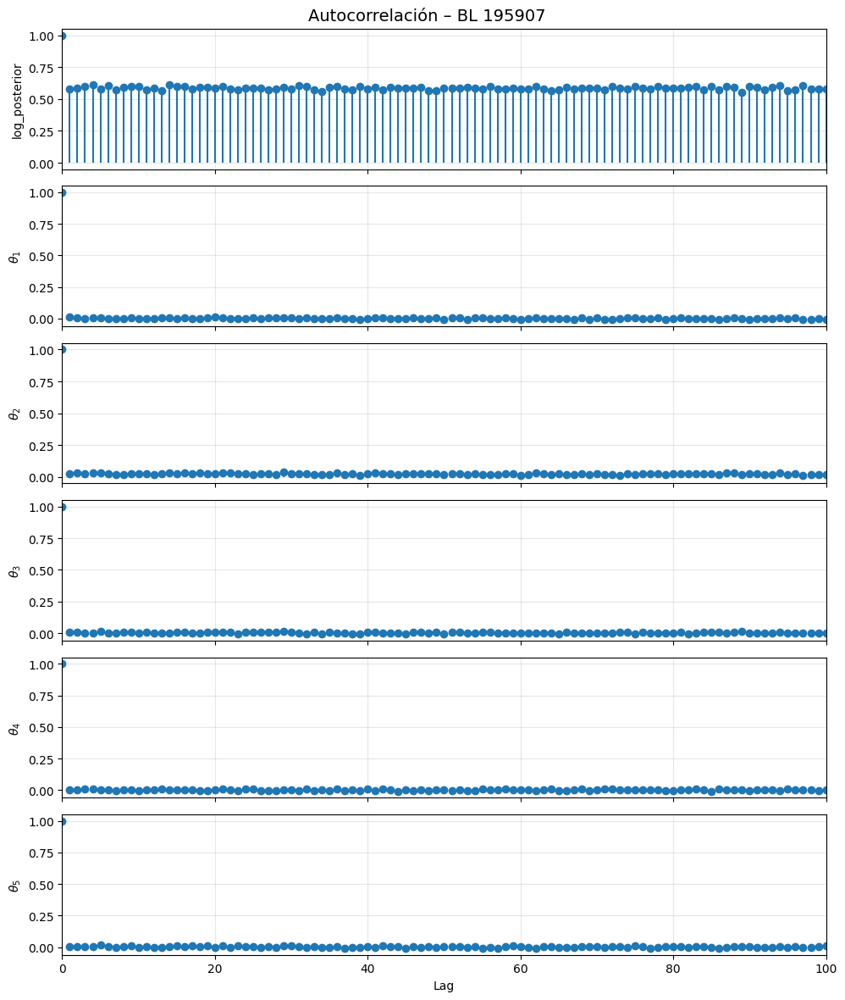

Archivo: BINF_ALPHAL_BL__197419__suffix01.out  – shape: (3150000, 6)


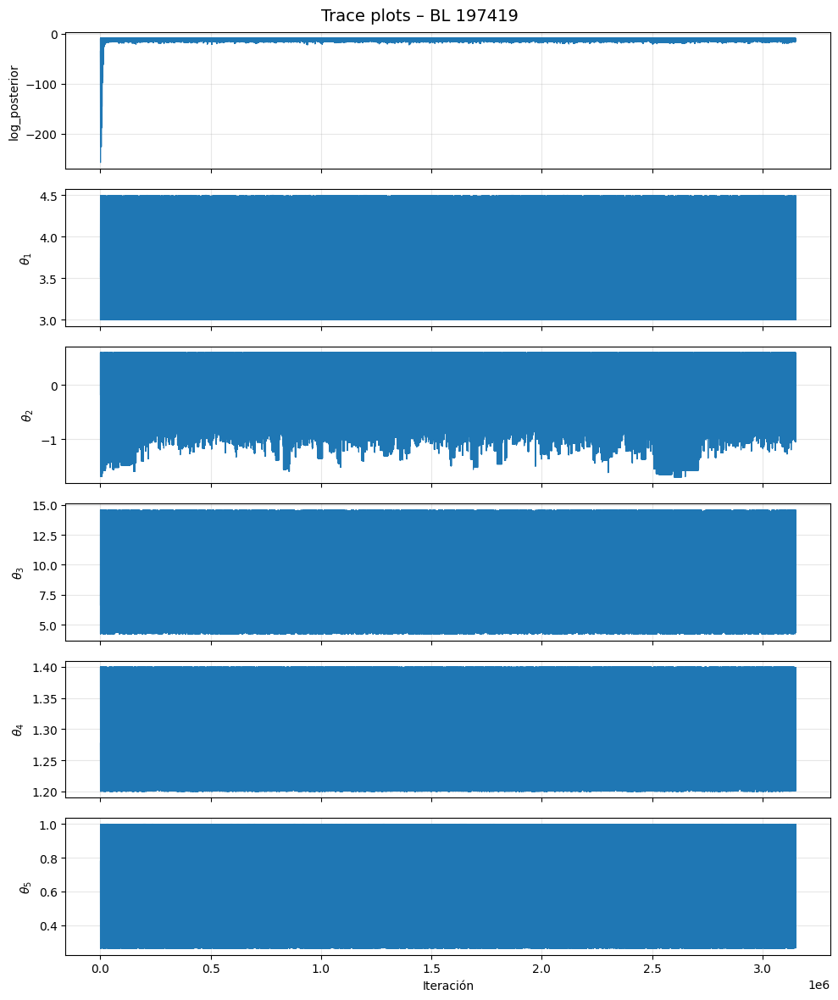

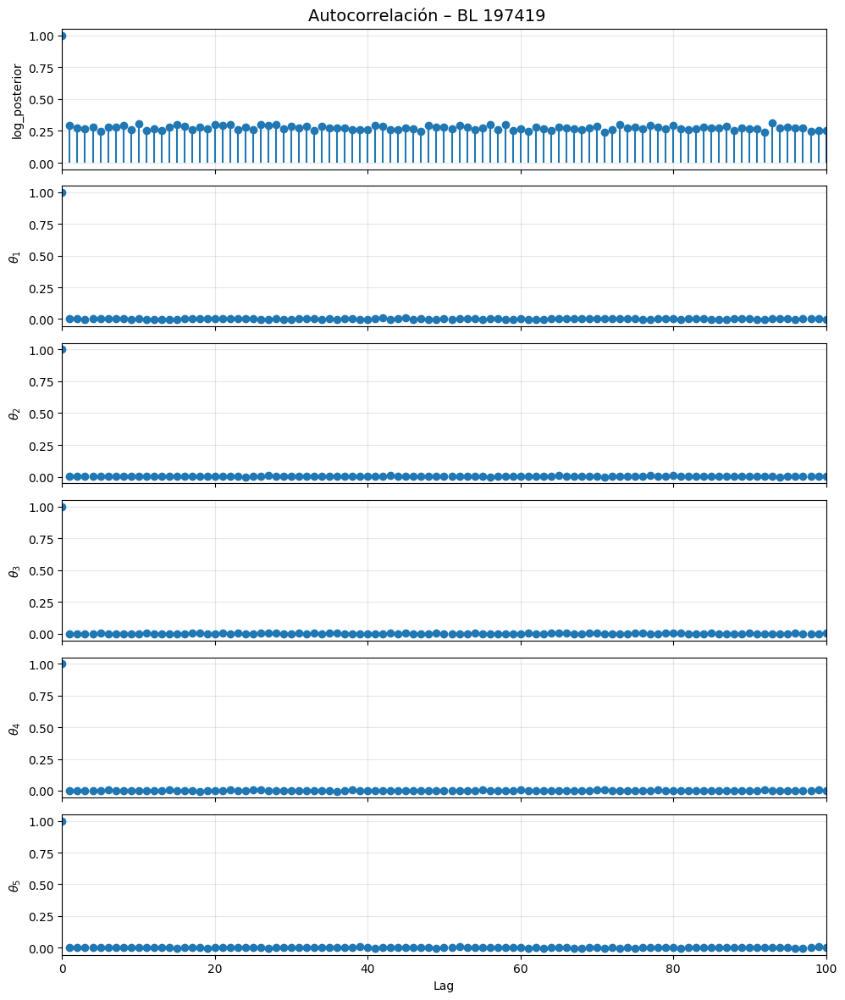

Archivo: BINF_ALPHAL_BL__200310__suffix01.out  – shape: (3150000, 6)


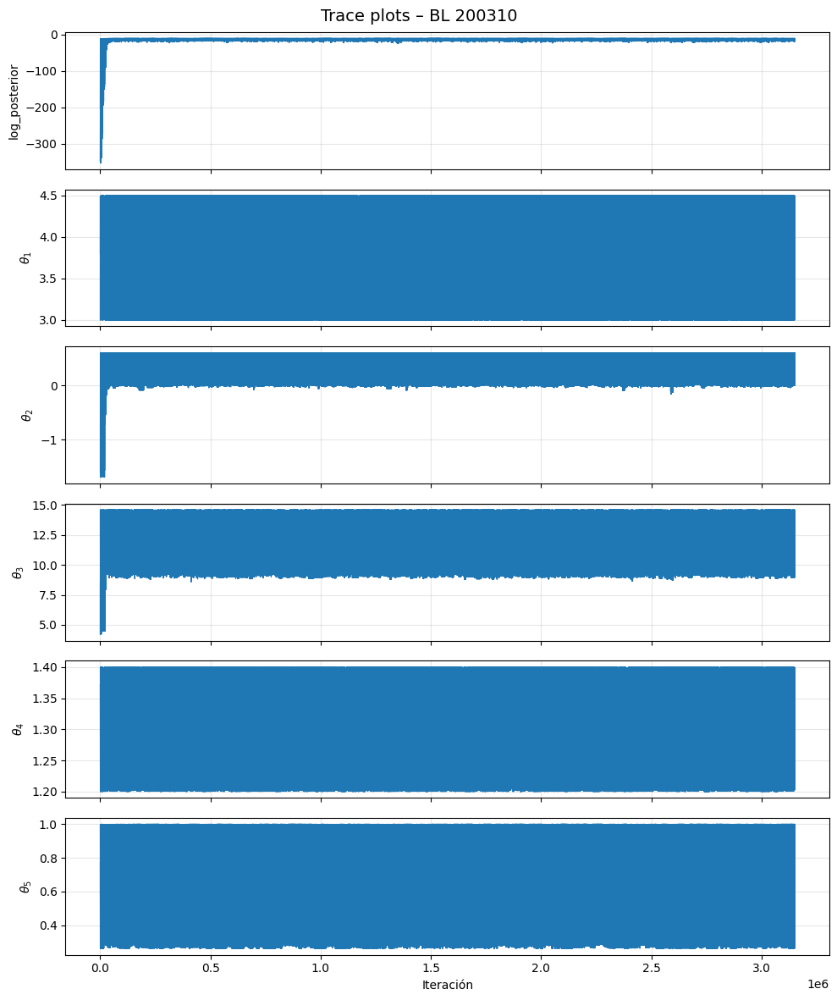

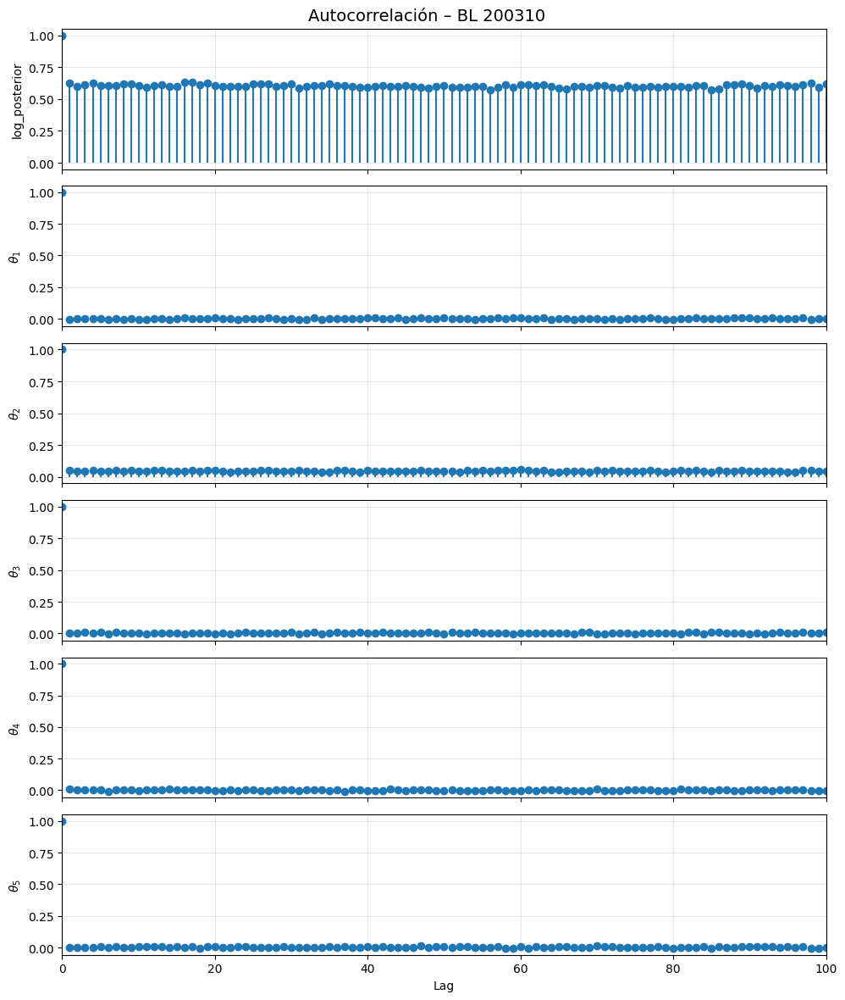

Archivo: BINF_ALPHAL_BL__202904__suffix01.out  – shape: (3150000, 6)


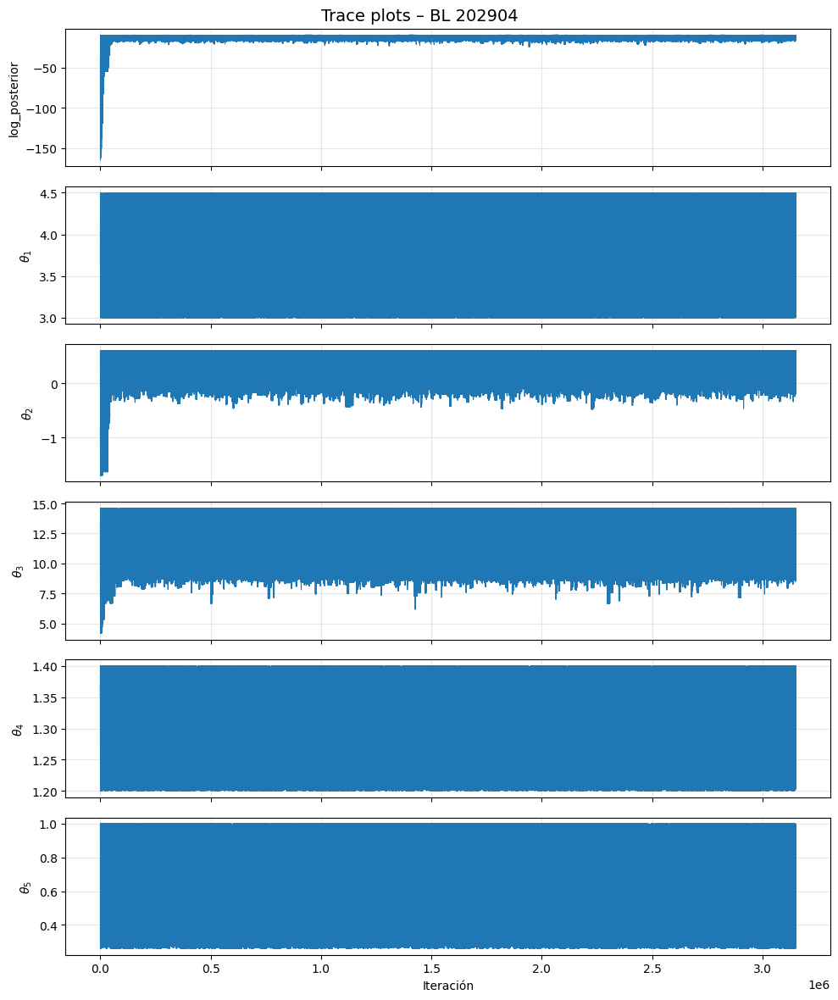

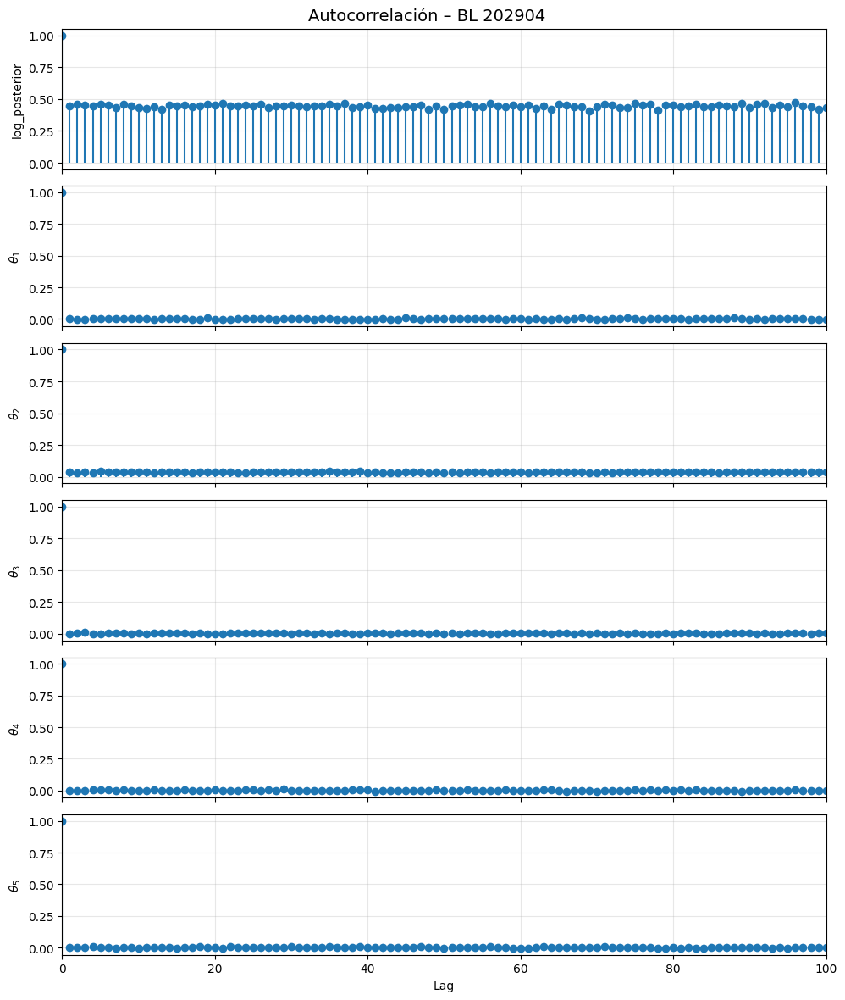

Archivo: BINF_ALPHAL_BL__20336__suffix01.out  – shape: (3150000, 6)


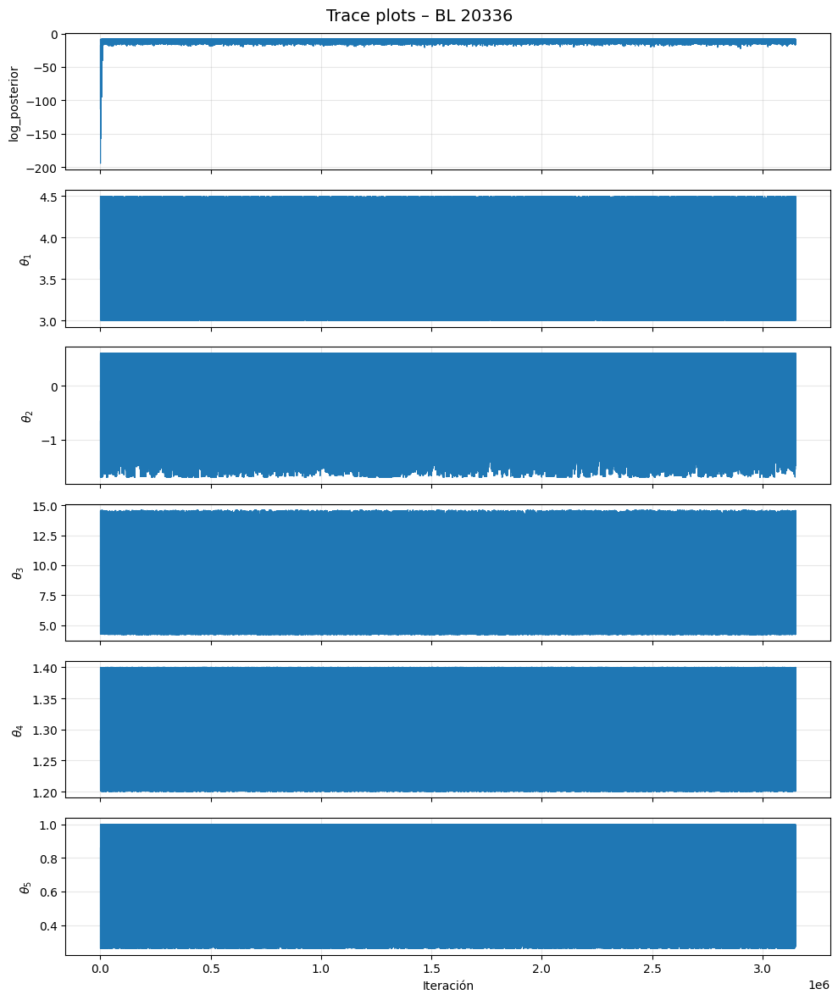

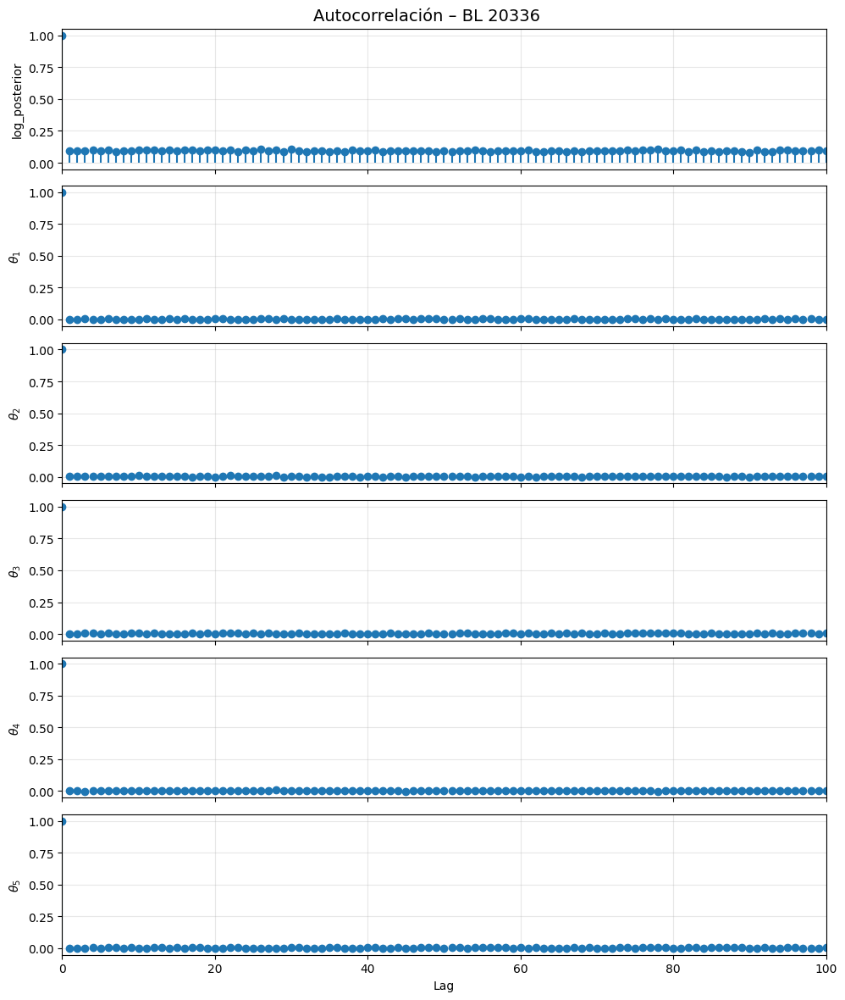

Archivo: BINF_ALPHAL_BL__204722__suffix01.out  – shape: (3150000, 6)


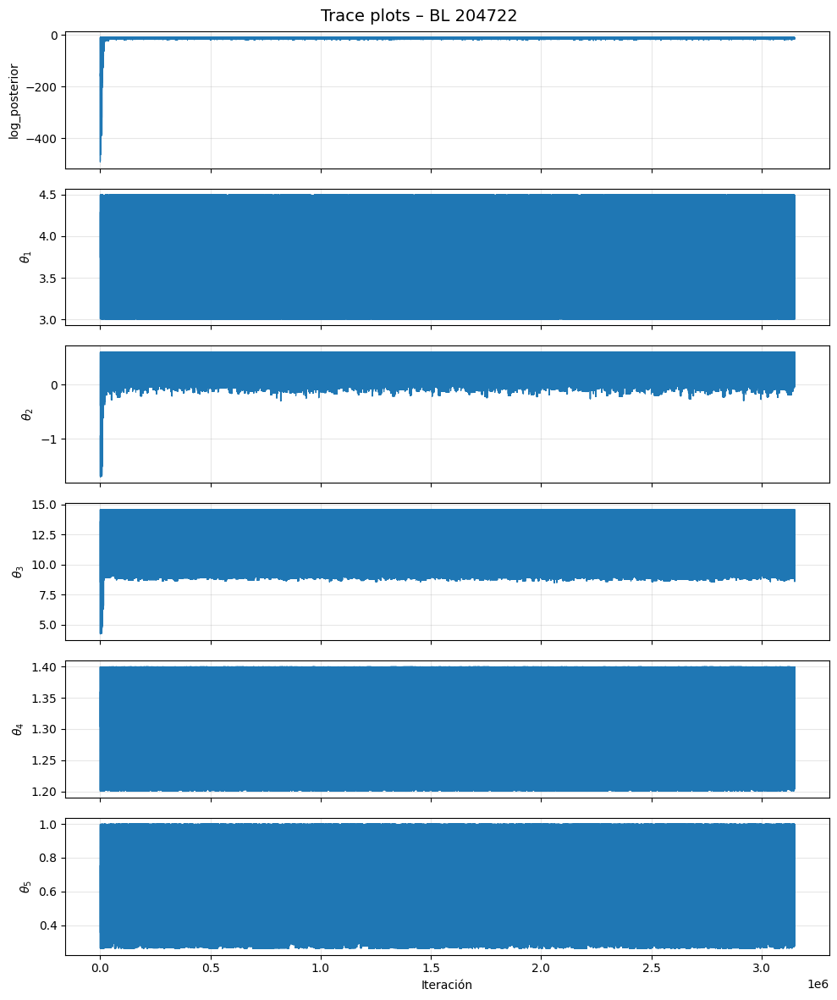

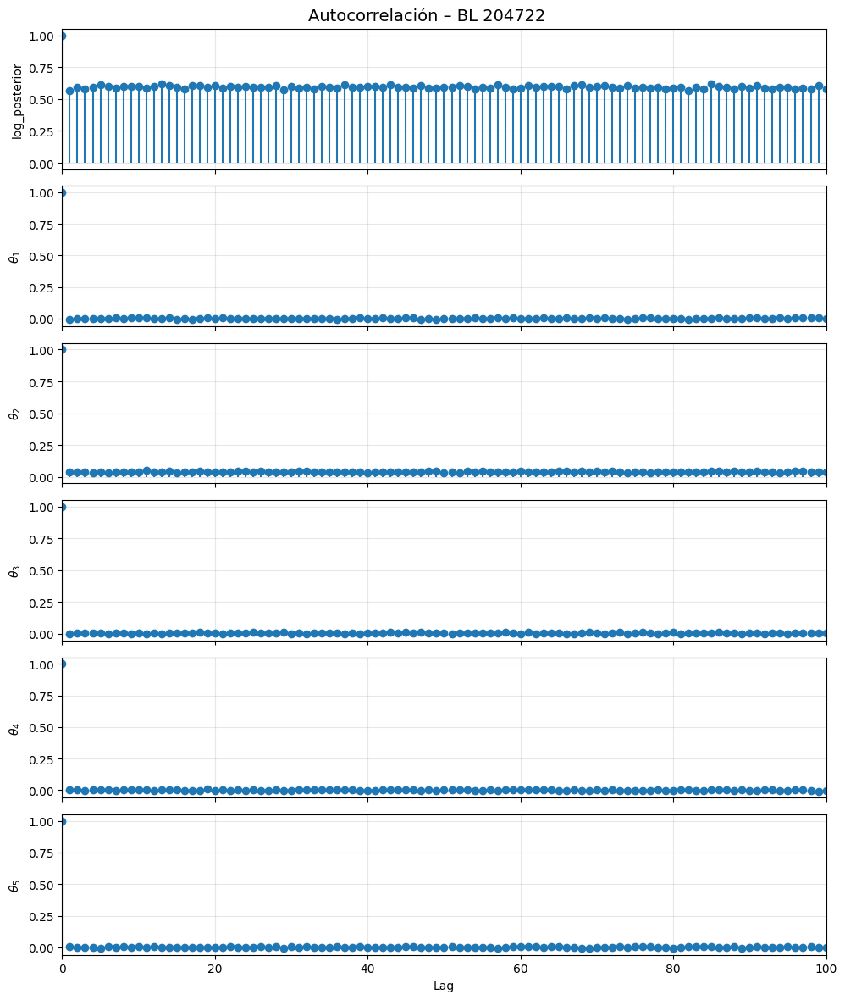

Archivo: BINF_ALPHAL_BL__210129__suffix01.out  – shape: (3150000, 6)


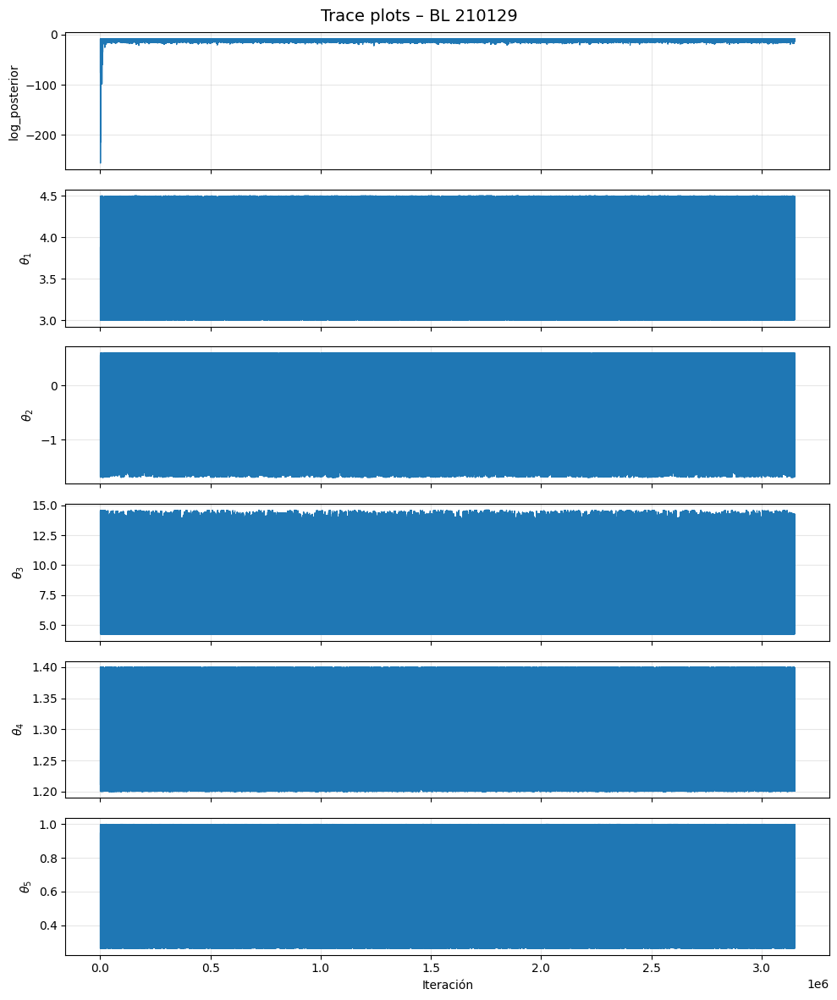

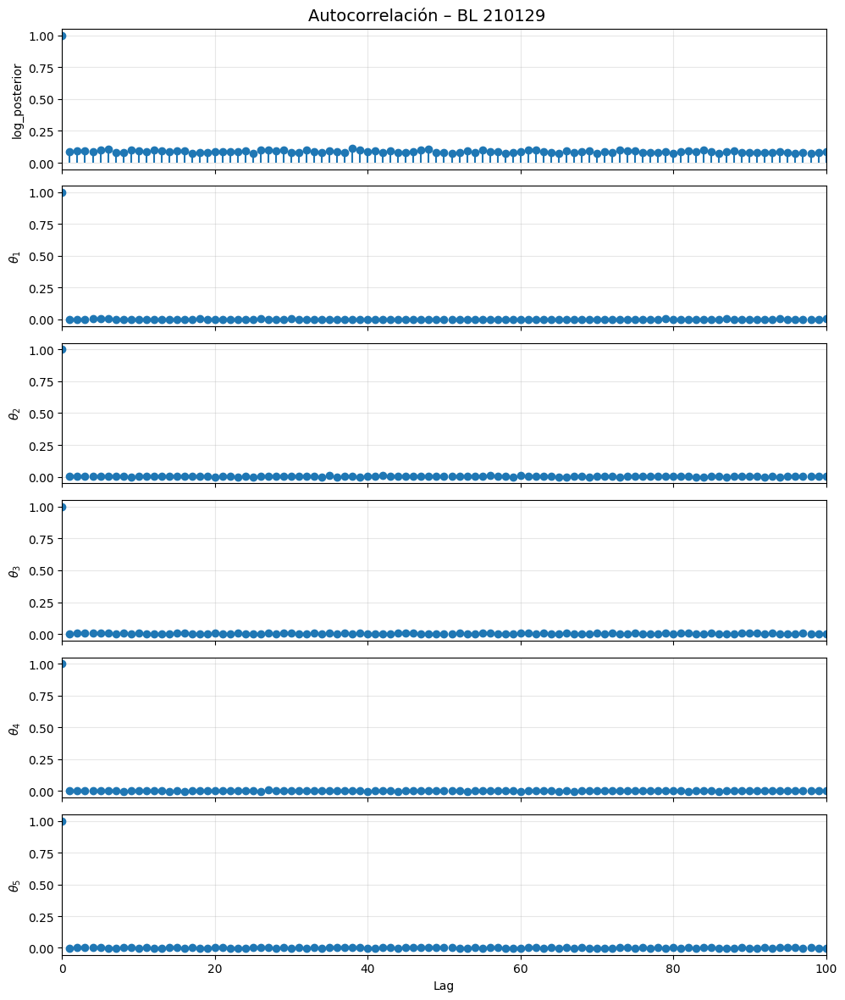

Archivo: BINF_ALPHAL_BL__217675__suffix01.out  – shape: (3150000, 6)


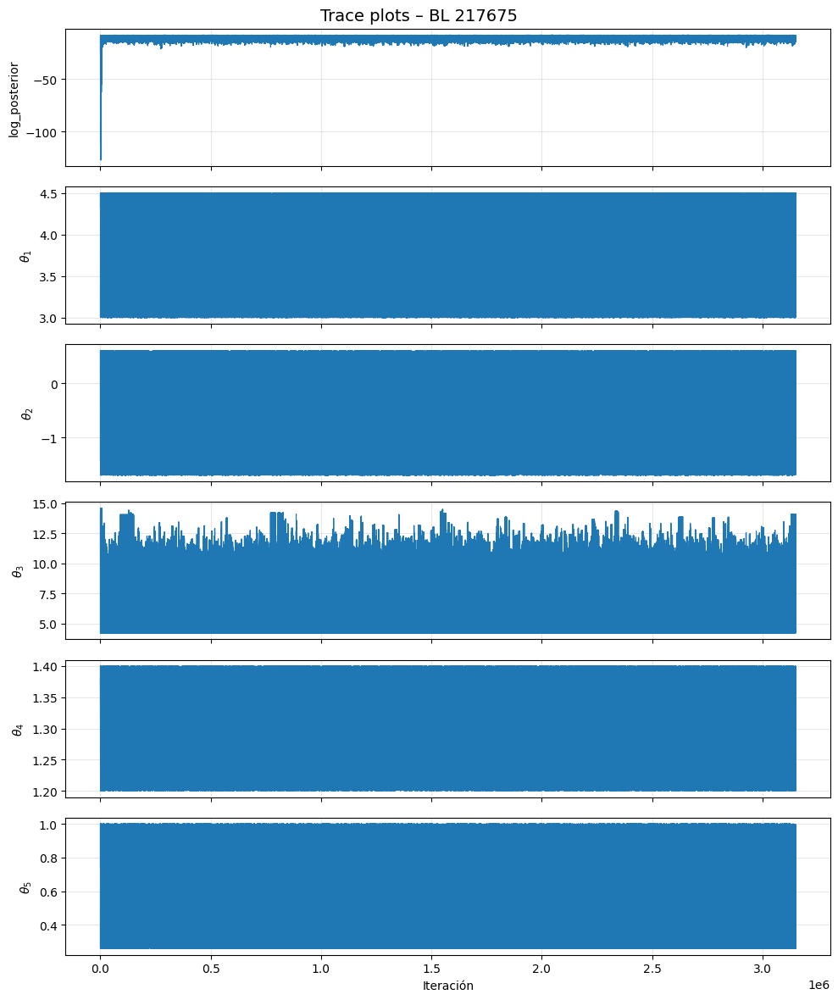

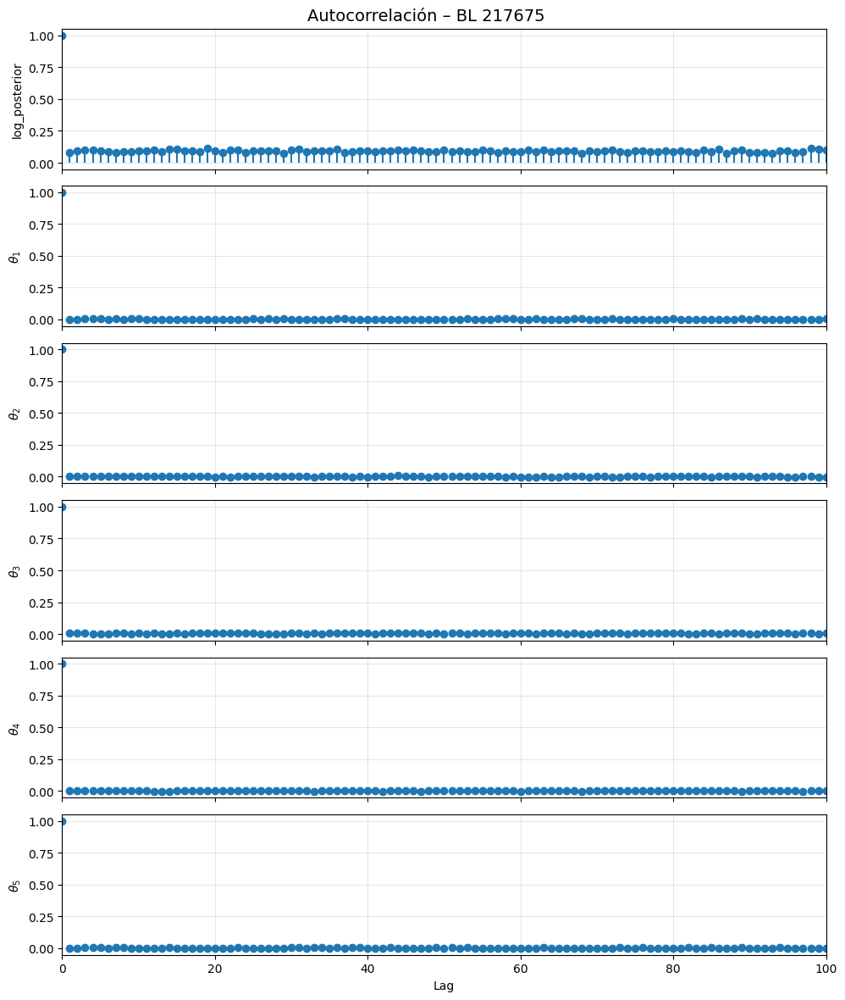

Archivo: BINF_ALPHAL_BL__217891__suffix01.out  – shape: (3150000, 6)


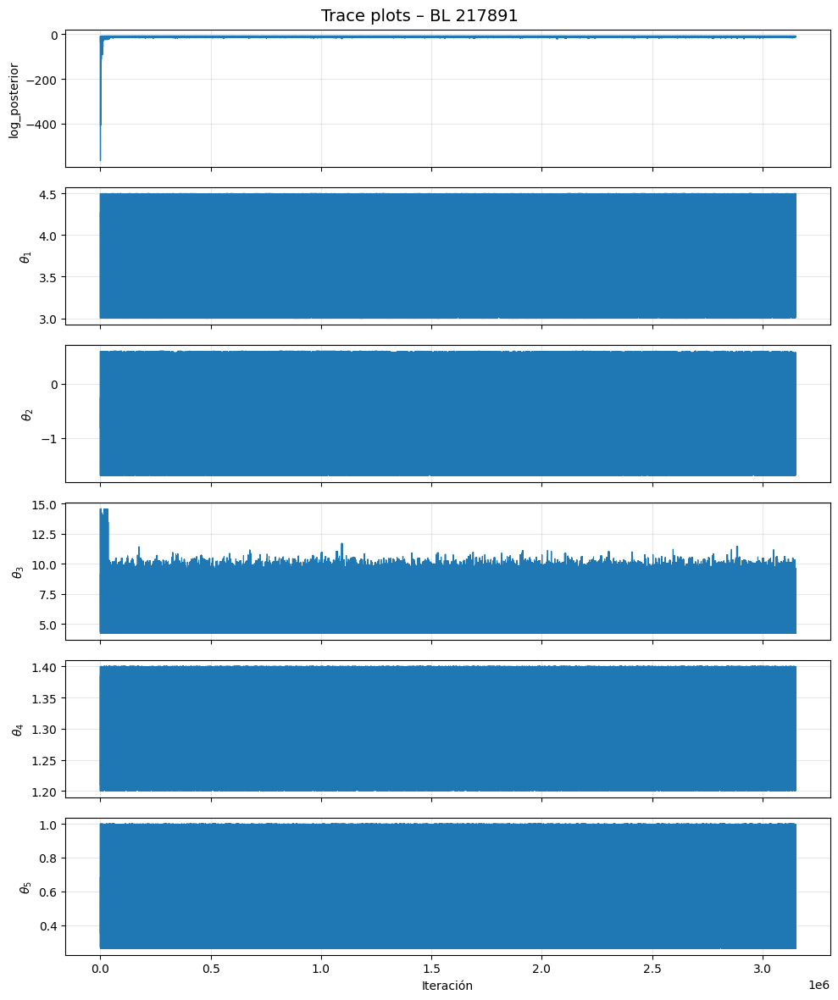

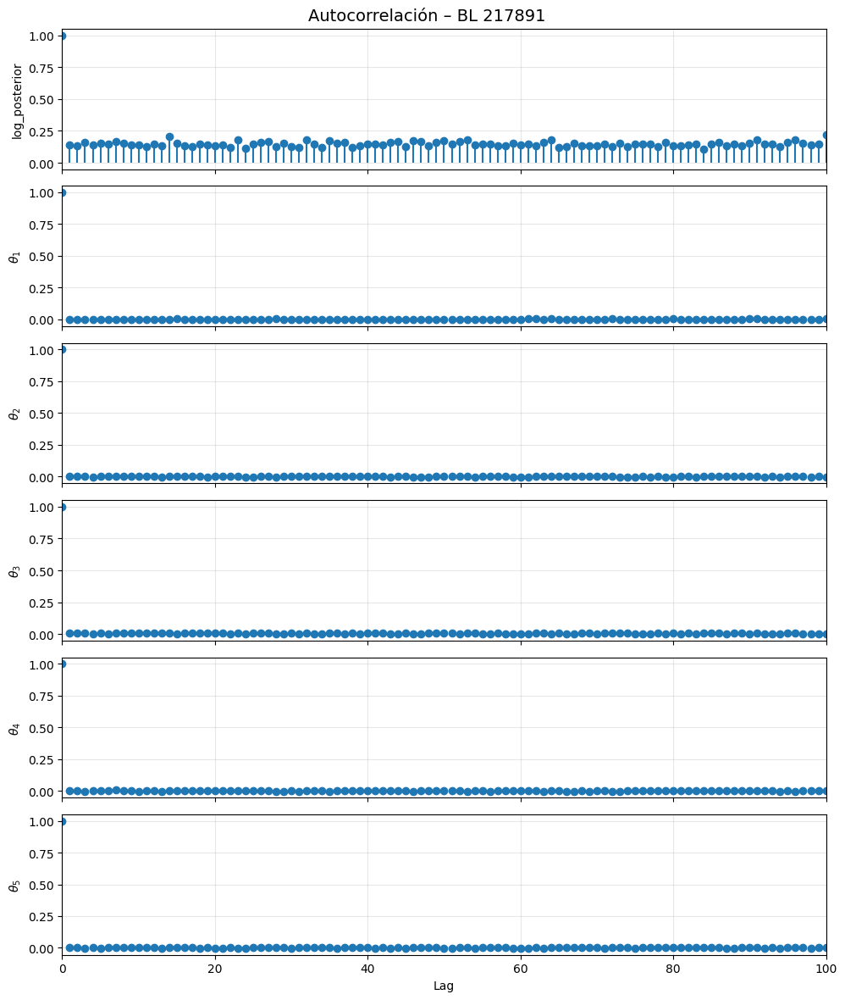

Archivo: BINF_ALPHAL_BL__23480__suffix01.out  – shape: (3150000, 6)


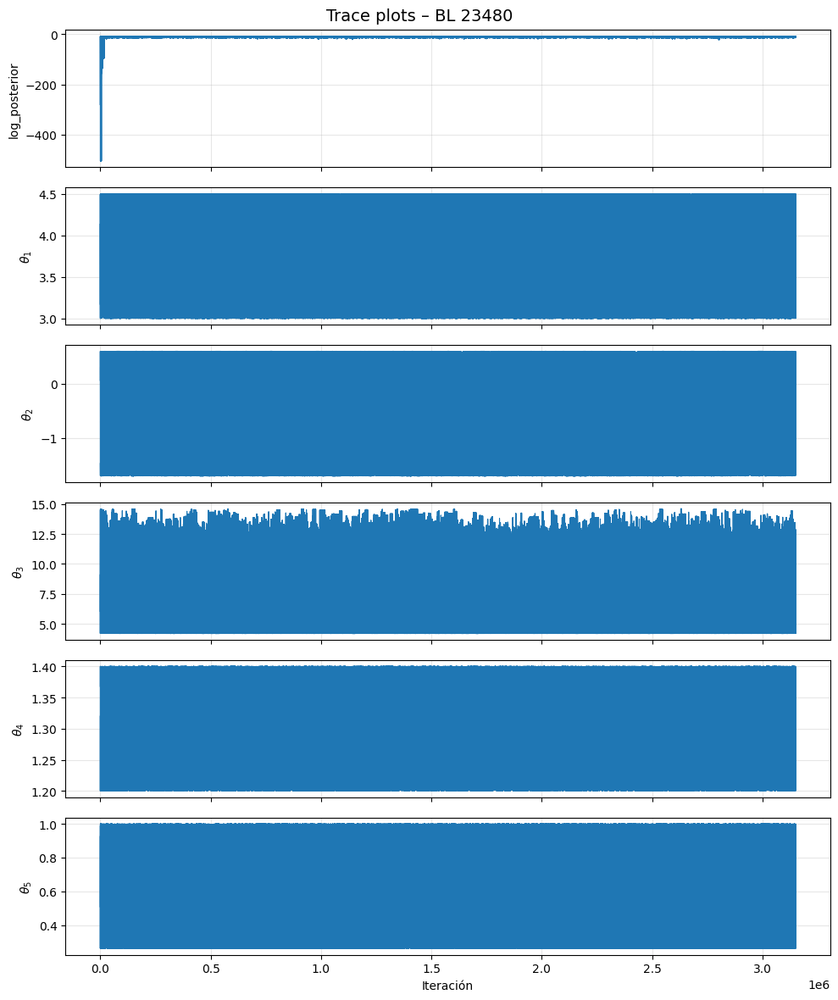

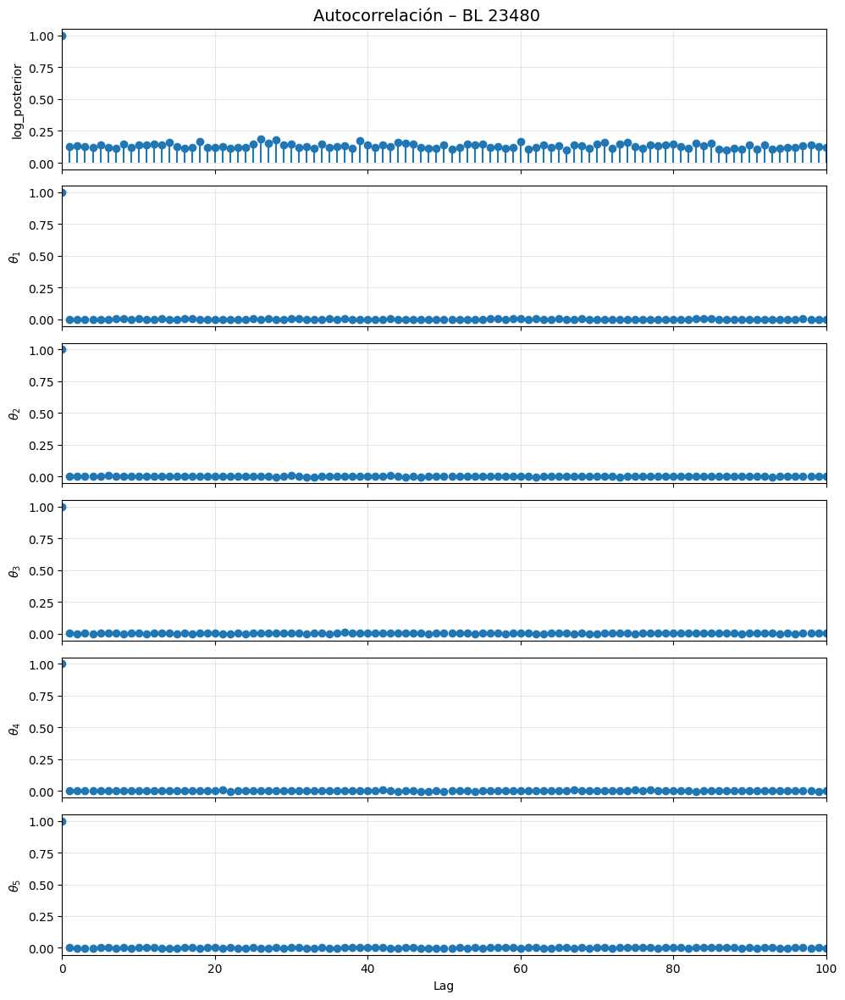

Archivo: BINF_ALPHAL_BL__23630__suffix01.out  – shape: (3150000, 6)


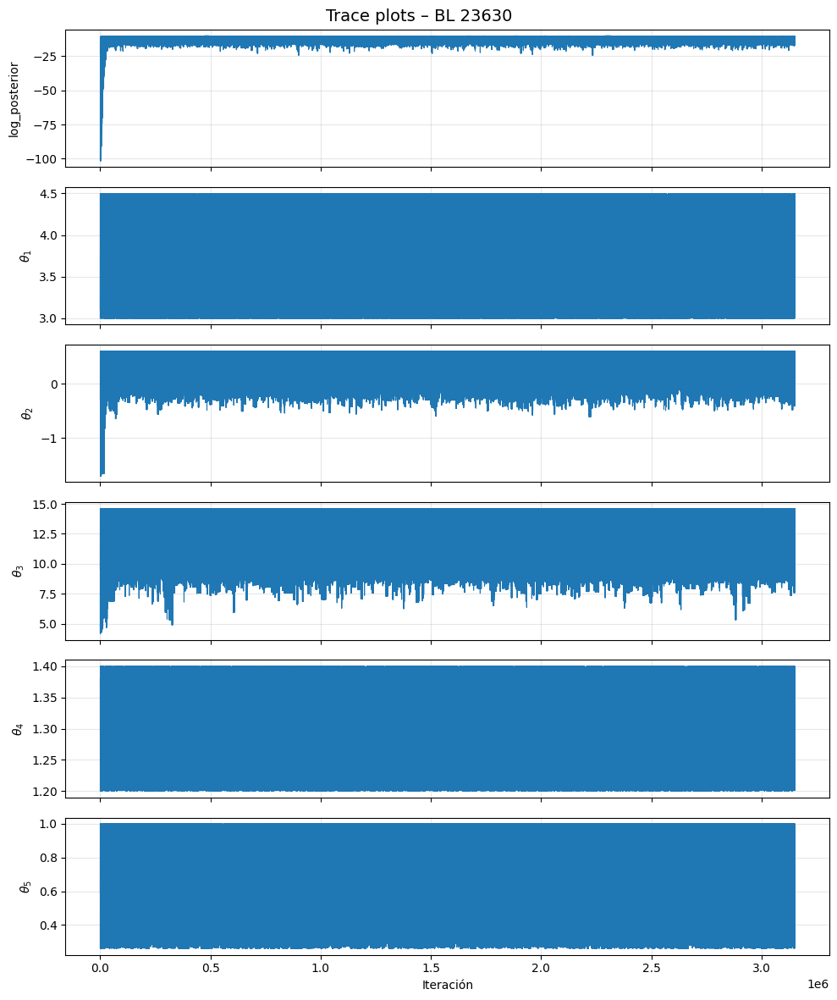

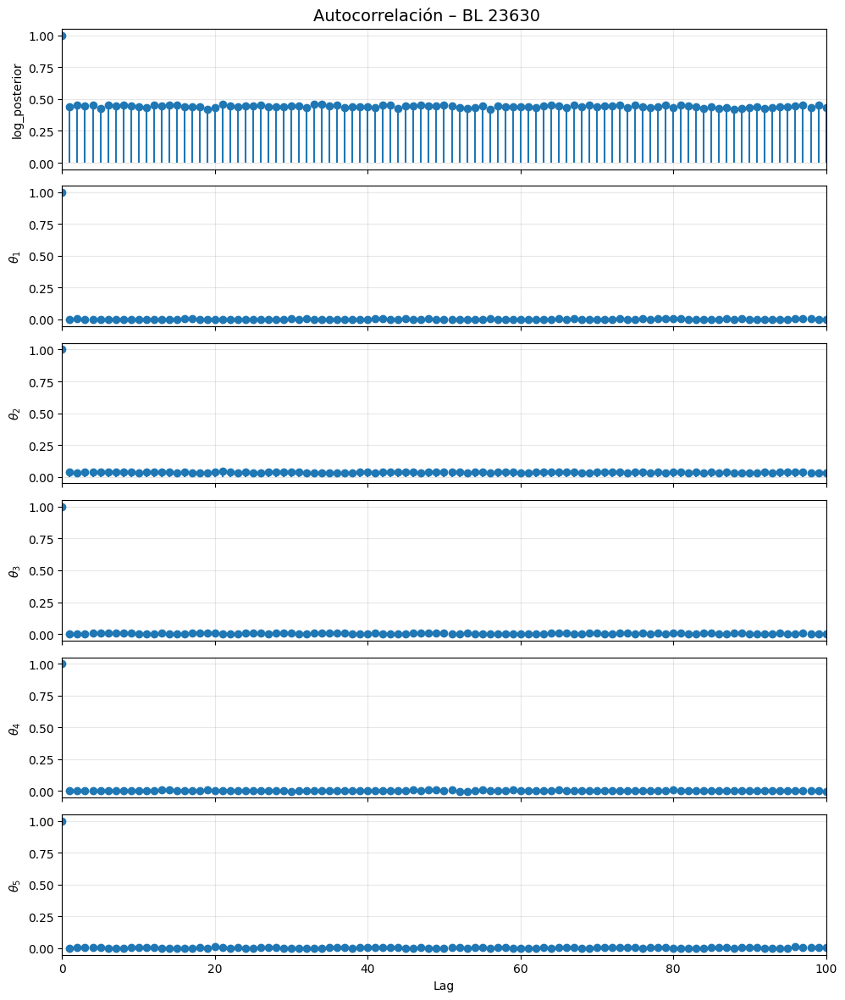

Archivo: BINF_ALPHAL_BL__23862__suffix01.out  – shape: (3150000, 6)


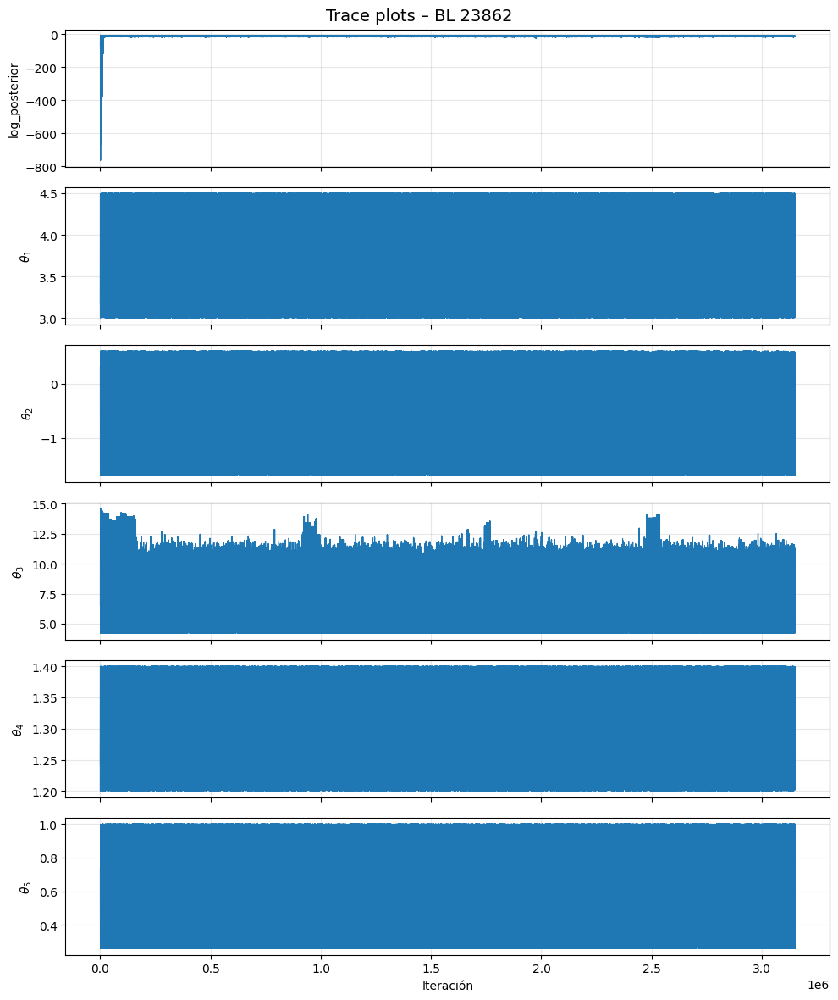

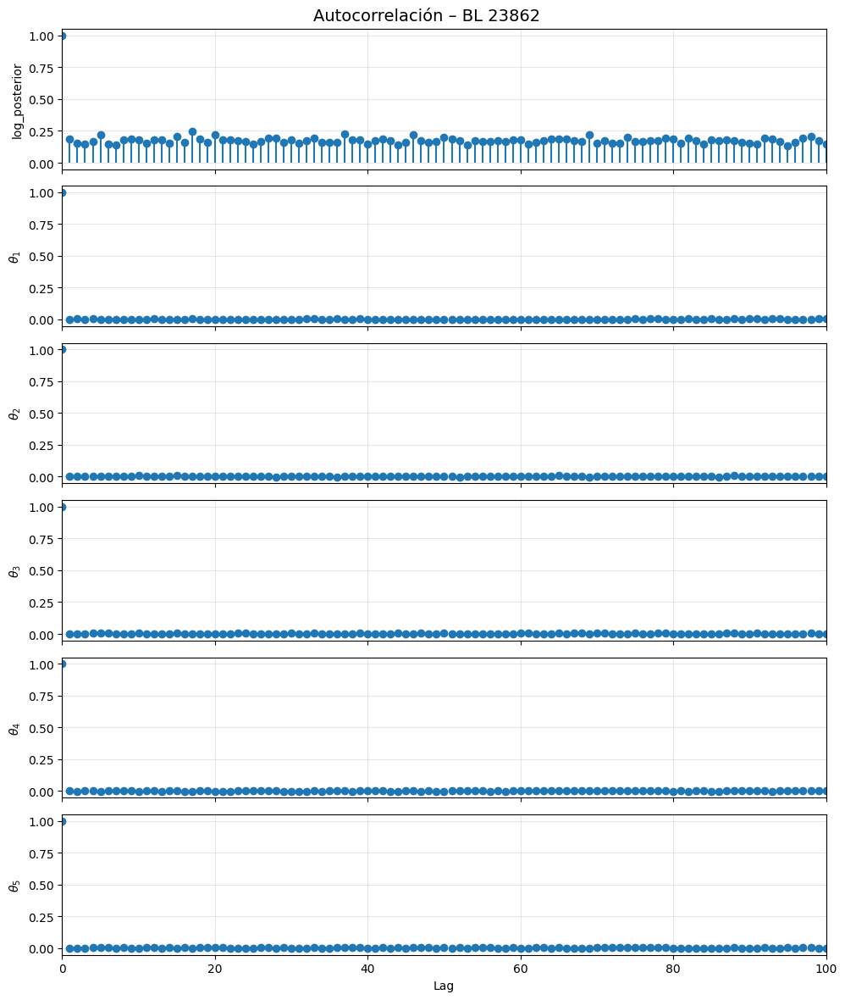

Archivo: BINF_ALPHAL_BL__4180__suffix01.out  – shape: (3150000, 6)


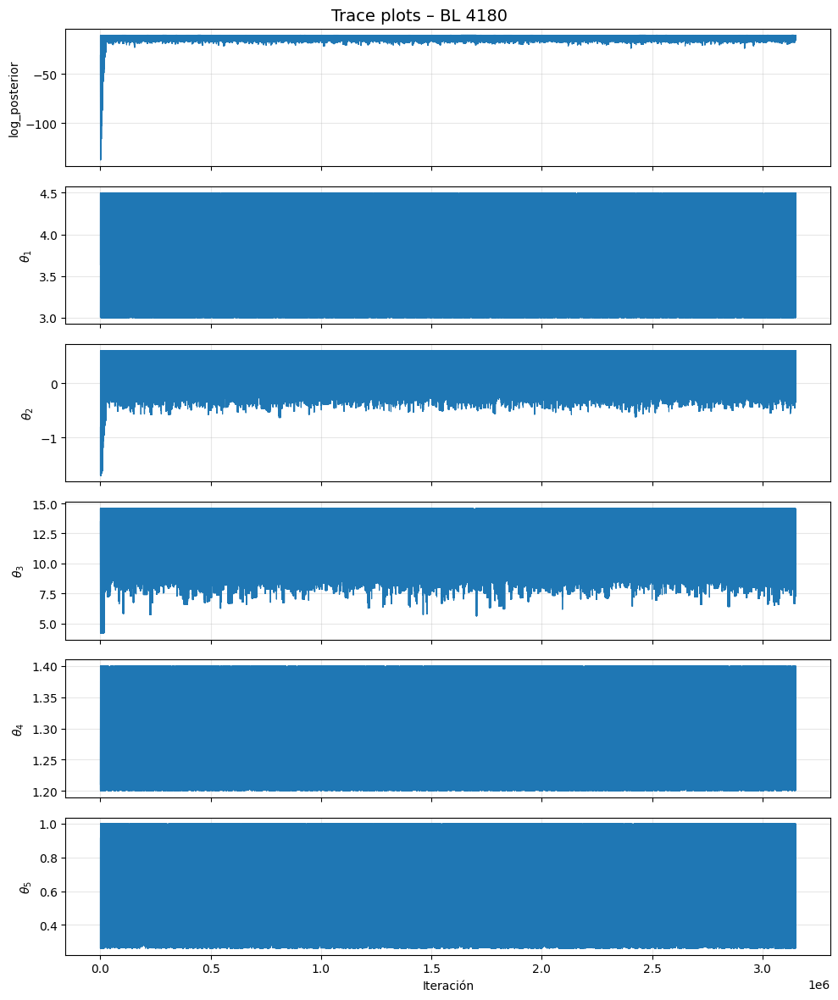

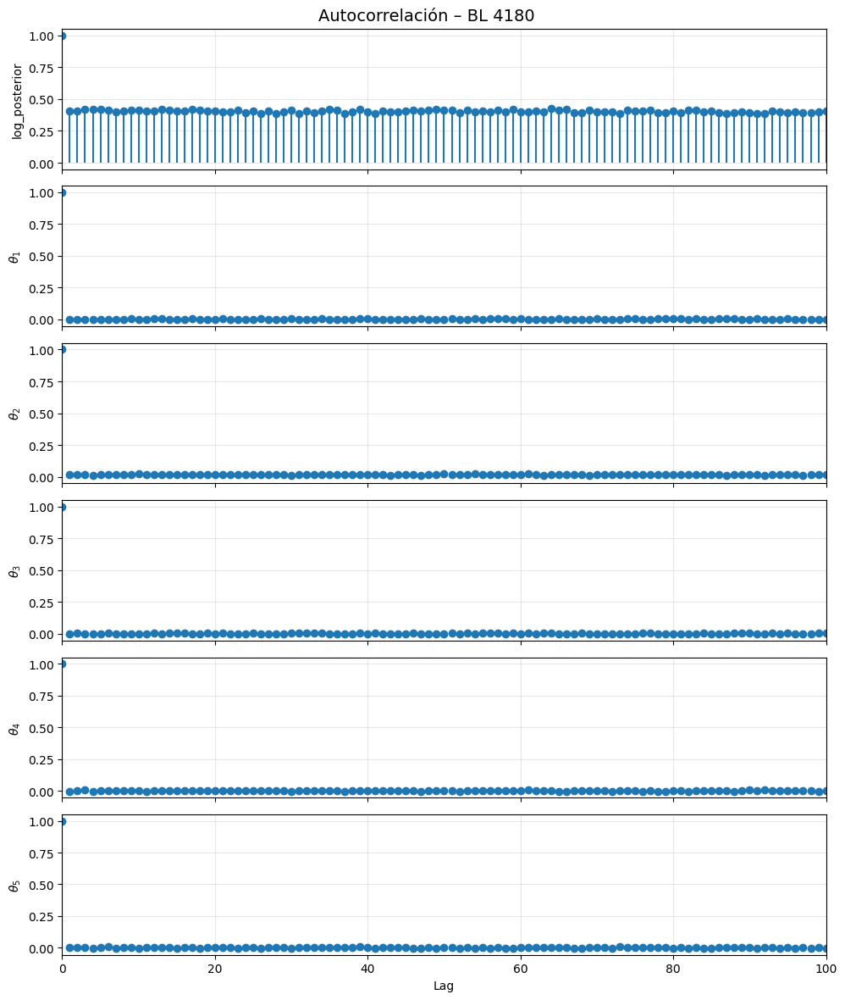

Archivo: BINF_ALPHAL_BL__5394__suffix01.out  – shape: (3150000, 6)


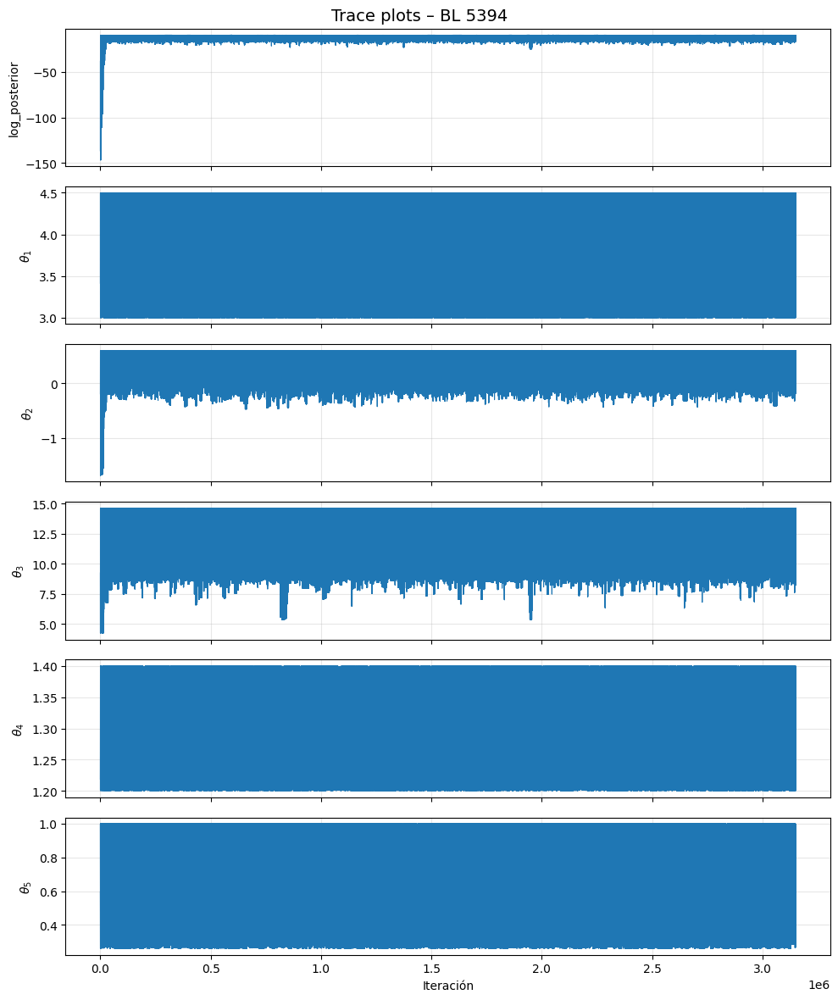

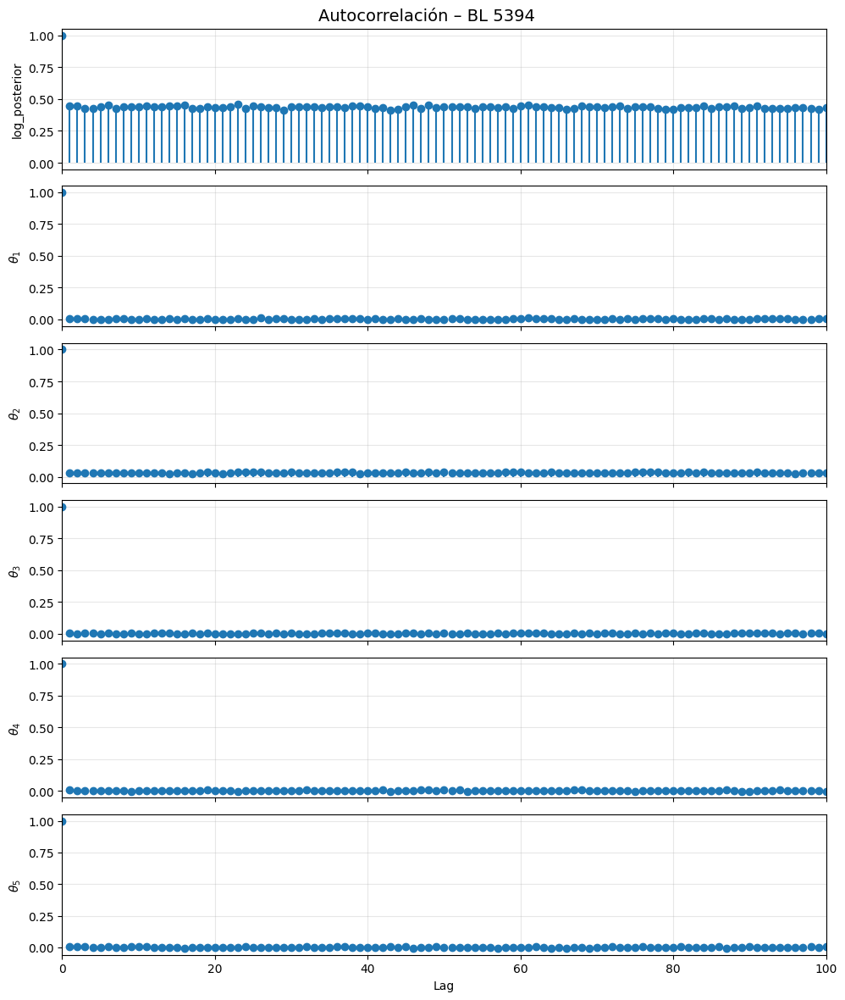

In [ ]:
filepaths = sorted(glob.glob(os.path.join(path_two, "BINF_ALPHAL_BL__*__suffix01.out")))


param_labels = [
    "log_posterior",
    r"$n$",
    r"$\log \Sigma\ \mathrm{[g\ cm^{-2}]}$",
    r"$M\ [M_\odot]$",
    r"$1+0.5\,W^2$",
    r"$\cos i$"
]



for fp in filepaths:
    star_id_match = [s for s in fp.split("__") if s.isdigit()]
    star_id = star_id_match[0] if star_id_match else "?"
    chain = load_chain_from_out(fp)

    print("Archivo:", os.path.basename(fp), " – shape:", chain.shape)

    plot_trace(
        chain,
        param_labels=param_labels,
        title=f"Trace plots – {star_id}"
    )

    plot_autocorr(
        chain,
        max_lag=100,
        param_labels=param_labels,
        title=f"AutocorrelaTION – {star_id}"
    )


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import glob
import os
import re

path_two = "/content/drive/MyDrive/Be-HDUST/Project_Lband_v3/Study_OldBeAtlas/bayesian_inference_01"

def load_chain_from_out(filepath):
    """
    Lee un archivo .out y devuelve un array (N, n_cols)
    solo con las filas numéricas (las muestras MCMC).
    Ignora las líneas de MAF, Rhat, tau, Neff, etc.
    """
    rows = []
    n_cols = None

    with open(filepath, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) == 0:
                continue

            # Intentamos convertir todo a float; si falla, es cabecera
            try:
                vals = [float(p) for p in parts]
            except ValueError:
                continue  # línea con texto (MAF, Rhat, etc.)

            if n_cols is None:
                n_cols = len(vals)
            if len(vals) == n_cols:
                rows.append(vals)

    return np.array(rows)


# ------------------------------------------------------------------
# 1. Recorremos todos los .out y calculamos media/mediana por columna
#    Además guardamos TODAS las muestras de cada parámetro (1..5)
# ------------------------------------------------------------------
filepaths = sorted(glob.glob(os.path.join(path_two, "BINF_ALPHAL_BL__*__suffix01.out")))
print(f"Encontrados {len(filepaths)} archivos .out")

stats_rows = []
all_param_samples = None   # aquí guardaremos las muestras globales de cada parámetro

for fp in filepaths:
    chain = load_chain_from_out(fp)   # shape (N, n_params)
    n_samples, n_params = chain.shape

    # asumimos: col 0 = log_posterior, col 1..5 = parámetros físicos
    # inicializamos diccionario para todos los parámetros físicos
    if all_param_samples is None:
        all_param_samples = {k: [] for k in range(1, n_params)}  # 1..5

    # extraer star_id desde el nombre
    fname = os.path.basename(fp)
    m = re.search(r"BL__([0-9]+)__suffix", fname)
    star_id = int(m.group(1)) if m else None

    means = chain.mean(axis=0)
    medians = np.median(chain, axis=0)

    # guardamos todas las muestras de CADA parámetro físico
    for k in range(1, n_params):   # 1..5
        all_param_samples[k].append(chain[:, k])

    row = {
        "file": fname,
        "star_id": star_id,
    }

    # columnas mean_i y median_i para cada columna (incluye log posterior en 0)
    for j in range(n_params):
        row[f"mean_{j}"] = means[j]
        row[f"median_{j}"] = medians[j]

    stats_rows.append(row)

df_stats = pd.DataFrame(stats_rows).sort_values("star_id").reset_index(drop=True)

print(df_stats.head())


Encontrados 19 archivos .out
                                  file  star_id     mean_0   median_0  \
0   BINF_ALPHAL_BL__4180__suffix01.out     4180 -11.687904 -11.497827   
1   BINF_ALPHAL_BL__5394__suffix01.out     5394 -11.524530 -11.325733   
2  BINF_ALPHAL_BL__11606__suffix01.out    11606 -13.330896 -12.214630   
3  BINF_ALPHAL_BL__20336__suffix01.out    20336 -10.026866  -9.716506   
4  BINF_ALPHAL_BL__23480__suffix01.out    23480  -9.880391  -9.655147   

     mean_1  median_1    mean_2  median_2     mean_3   median_3    mean_4  \
0  3.663446  3.578498  0.304678  0.333264  11.825407  11.788395  1.313875   
1  3.710384  3.572863  0.339296  0.365239  11.751029  11.694974  1.315263   
2  4.373891  4.403179  0.242213  0.241409  11.146828  11.077983  1.315983   
3  3.593922  3.544736  0.040563  0.110429   7.407848   7.045541  1.314950   
4  3.791047  3.806548 -0.465893 -0.455730   7.228553   6.899612  1.311725   

   median_4    mean_5  median_5  
0  1.317904  0.735917  0.764913  
1

In [ ]:
# Concatenar todas las muestras del parámetro 1 en un solo array
all_param = np.concatenate(all_param_samples)

plt.figure(figsize=(8, 5))
plt.hist(all_param1, bins="fd", edgecolor="black", alpha=0.7, density = True)
plt.xlabel("Parámetro 5 (columna 5)")
plt.ylabel("Densidad")
plt.title("Distribución global del parámetro 5 (todas las estrellas)")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


TypeError: The first input argument needs to be a sequence

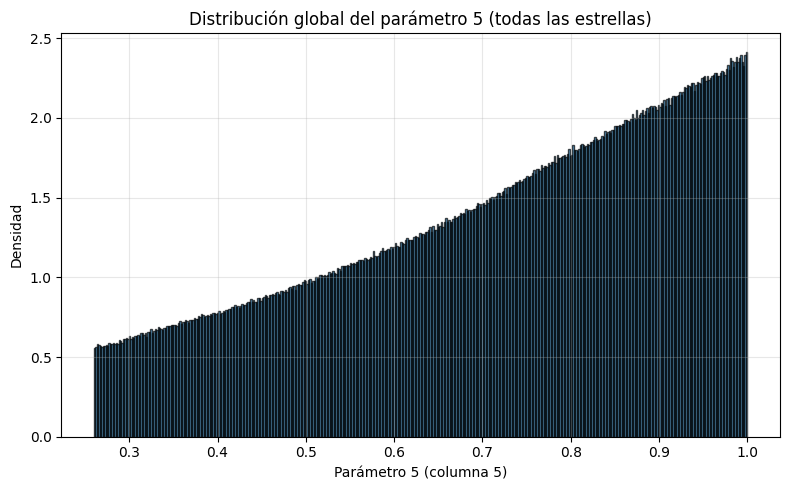

In [ ]:
# Concatenar todas las muestras del parámetro 5 en un solo array
# Asumiendo que se refiere a la columna 5, que corresponde al parámetro 5.
all_param_5 = np.concatenate(all_param_samples[5])

plt.figure(figsize=(8, 5))
plt.hist(all_param_5, bins="fd", edgecolor="black", alpha=0.7, density = True)
plt.xlabel("Parámetro 5 (columna 5)")
plt.ylabel("Densidad")
plt.title("Distribución global del parámetro 5 (todas las estrellas)")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

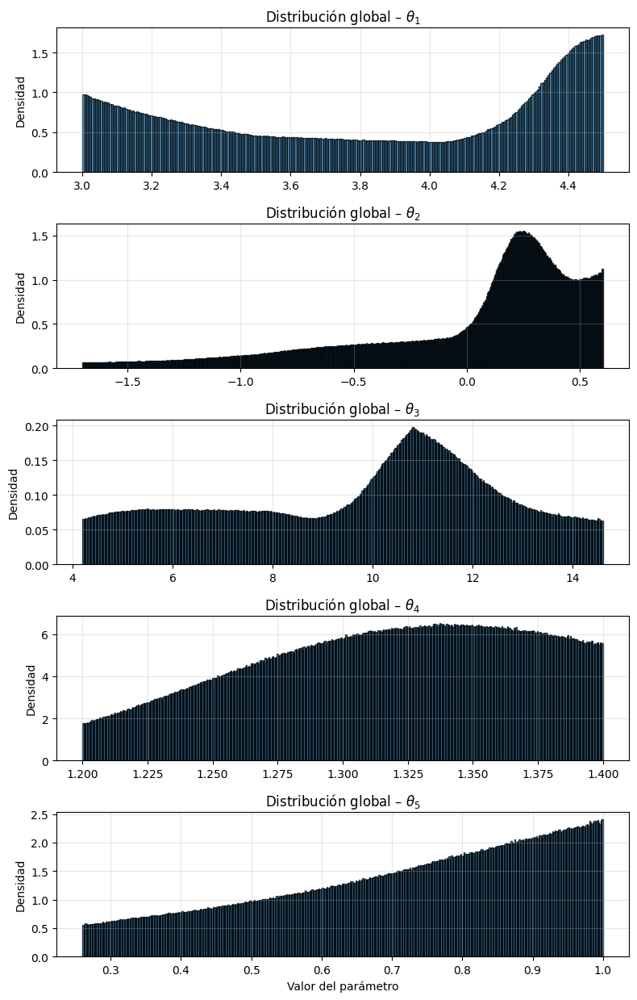

In [ ]:
# Etiquetas bonitas para tus 5 parámetros físicos (ajusta a lo que sean realmente)
param_labels = {
    1: r"$\theta_1$",
    2: r"$\theta_2$",
    3: r"$\theta_3$",
    4: r"$\theta_4$",
    5: r"$\theta_5$",
}

n_phys_params = len(all_param_samples)  # debería ser 5

fig, axes = plt.subplots(
    n_phys_params, 1,
    figsize=(8, 2.5 * n_phys_params),
    sharex=False
)

if n_phys_params == 1:
    axes = [axes]

for idx, k in enumerate(sorted(all_param_samples.keys())):
    ax = axes[idx]
    # concatenamos todas las muestras de ese parámetro (todas las estrellas)
    data_k = np.concatenate(all_param_samples[k])

    ax.hist(
        data_k,
        bins="fd",          # bineo "inteligente"
        edgecolor="black",
        alpha=0.75,
        density=True
    )
    ax.set_ylabel("Densidad")
    ax.set_title(f"Distribución global – {param_labels.get(k, f'parámetro {k}')}")
    ax.grid(True, alpha=0.3)

axes[-1].set_xlabel("Valor del parámetro")
plt.tight_layout()
plt.show()


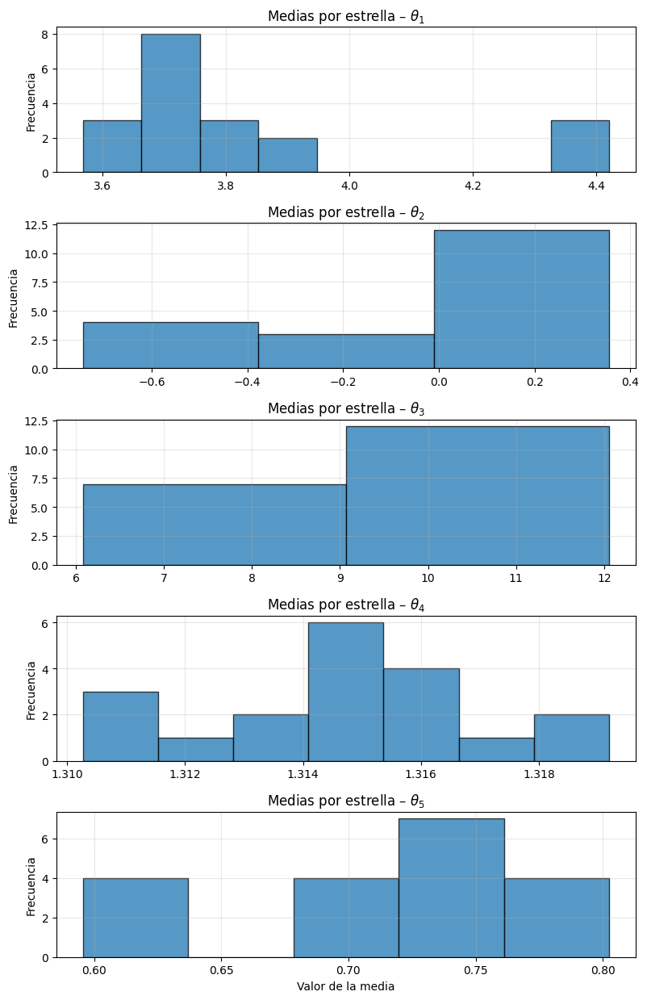

In [ ]:
import matplotlib.pyplot as plt

# Número total de columnas de media (incluyendo log posterior)
n_params = len([c for c in df_stats.columns if c.startswith("mean_")])

# Ejemplo de etiquetas (ajústalas a tus parámetros reales)
# 0 = log posterior, 1..5 = parámetros físicos
param_labels = [
    "log_posterior",   # 0
    r"$\theta_1$",     # 1
    r"$\theta_2$",     # 2
    r"$\theta_3$",     # 3
    r"$\theta_4$",     # 4
    r"$\theta_5$",     # 5
]



# --- SOLO parámetros físicos: columnas 1..n_params-1 ---
n_phys_params = n_params - 1

fig, axes = plt.subplots(
    n_phys_params, 1,
    figsize=(8, 2.5 * n_phys_params),
    sharex=False
)

if n_phys_params == 1:
    axes = [axes]

for j in range(1, n_params):  # empezamos en 1 para saltar log_posterior
    ax = axes[j-1]
    col_name = f"mean_{j}"
    data = df_stats[col_name].values

    ax.hist(
        data,
        bins="fd",              # “bien bineado” (Freedman–Diaconis)
        edgecolor="black",
        alpha=0.75
    )
    ax.set_ylabel("Frecuencia")
    ax.set_title(f"Medias por estrella – {param_labels[j]}")
    ax.grid(True, alpha=0.3)

axes[-1].set_xlabel("Valor de la media")
plt.tight_layout()
plt.show()


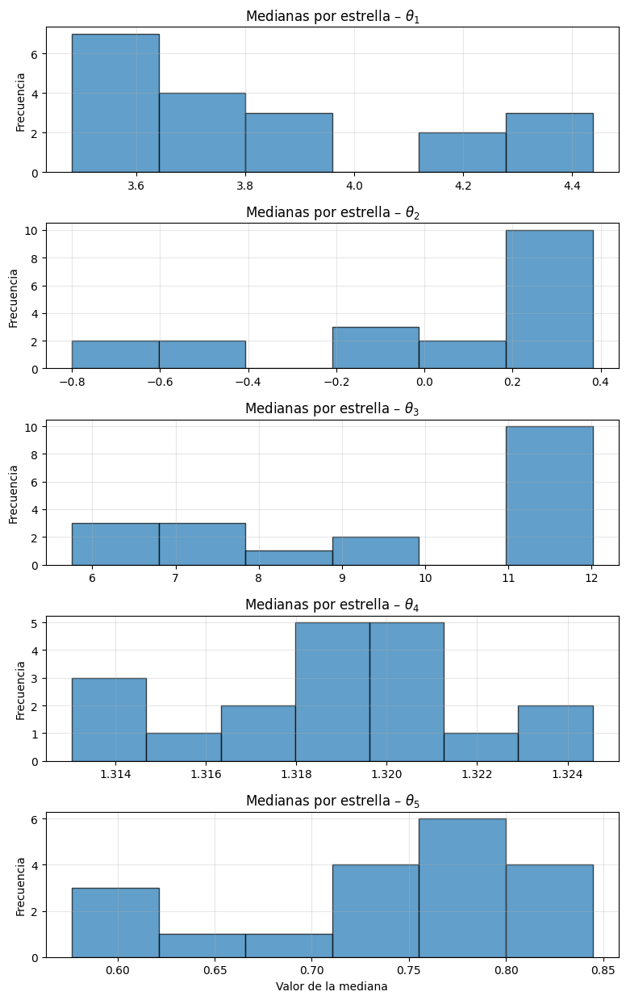

In [ ]:
# Número de parámetros (incluyendo log_posterior en la col 0)
n_params = len([c for c in df_stats.columns if c.startswith("mean_")])

# Etiquetas bonitas para cada columna (ajusta a tus parámetros reales):
param_labels = [
    "log_posterior",   # 0
    r"$\theta_1$",    # 1
    r"$\theta_2$",    # 2
    r"$\theta_3$",    # 3
    r"$\theta_4$",    # 4
    r"$\theta_5$",    # 5
]

# Si tienes más o menos de 6 columnas, adapta esta lista:
assert len(param_labels) == n_params, "Ajusta param_labels al número de columnas"

# Vamos a hacer un subplot por parámetro (solo parámetros físicos: 1..n_params-1)
n_phys_params = n_params - 1

fig, axes = plt.subplots(
    n_phys_params, 1,
    figsize=(8, 2.5 * n_phys_params),
    sharex=False
)

if n_phys_params == 1:
    axes = [axes]

for j in range(1, n_params):  # empezamos en 1 para saltarnos el log_posterior
    ax = axes[j-1]
    col_name = f"median_{j}"
    data = df_stats[col_name].values

    ax.hist(data, bins="auto", edgecolor="black", alpha=0.7)
    ax.set_ylabel("Frecuencia")
    ax.set_title(f"Medianas por estrella – {param_labels[j]}")
    ax.grid(True, alpha=0.3)

axes[-1].set_xlabel("Valor de la mediana")
plt.tight_layout()
plt.show()

In [ ]:
from google.colab import files
import shutil
# Define la carpeta de origen y la carpeta de destino
source_folder = '/content/drive/MyDrive/Be-HDUST/CornersPaper'
destination_folder = '/content/drive/MyDrive/Be-HDUST/CornersPaper/SelectedSpectra'

# Crea la carpeta de destino si no existe
os.makedirs(destination_folder, exist_ok=True)

# Define el patrón del archivo
#pattern = re.compile(r"Spectra_BINF_2DLENORZER__\d+__suffix01\.png")
pattern = re.compile(r"Spectra_BINF_ALPHAL_BL__\d+__suffix01\.png")
# Busca los archivos que coincidan con el patrón y cópialos
for file_name in os.listdir(source_folder):
    if pattern.match(file_name):
        source_file = os.path.join(source_folder, file_name)
        destination_file = os.path.join(destination_folder, file_name)
        shutil.copy(source_file, destination_file)

print(f"Imágenes copiadas a: {destination_folder}")

# Comprime la carpeta de destino para descargarla
shutil.make_archive('/content/SelectedSpectra', 'zip', destination_folder)



files.download('/content/SelectedSpectra.zip')


Imágenes copiadas a: /content/drive/MyDrive/Be-HDUST/CornersPaper/SelectedSpectra


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>